In [1]:
#import sys
#!{sys.executable} -m pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [2]:
#import sys
#!{sys.executable} -m pip install plotly

In [3]:
#import sys
#!{sys.executable} -m pip install jupyter-resource-usage

In [4]:
#from google.colab import drive
#drive.mount('/content/drive')

# Importing Libraries

In [5]:
import sys ## used for functions that interact strongly with the interpreter (i.e. a program that reads and execute codes)
import copy ## to use copying functions
import pandas as pd ## library for dataset manipulation
import numpy as np ## mathematical function on arrays and matrices
import matplotlib.pyplot as plt ## for basic plotting
import seaborn as sns ## easier plotting and updated matplotlib library 
from sklearn.preprocessing import StandardScaler,PowerTransformer ## for standardization on numerical variables
from pandas_profiling import ProfileReport ## for a complete pandas DataFrame report
import plotly.express as px ## 'plotly.express' for scatter plotting on location data with a location map 
import statsmodels ## statsmodel module for using statistical models
import statsmodels.api as sm ## api module for OLS model from statsmodels, assigned as sm
import statsmodels.stats.api as sms ## api module for Gold-Feld Quandt Test from statsmodels.stats, assigned as sms
from sklearn.model_selection import train_test_split ## for splitting the dataset into train and test
from sklearn.metrics import mean_squared_error,r2_score ## for mse and r-squared
from sklearn.neighbors import KNeighborsRegressor ## for KNN-Regressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor ## for Decision Tree Regressor
import scipy.stats as stats ## for probability distribution and statistical functions
from scipy.stats import f_oneway,jarque_bera,shapiro ## for assumptions and statistical significance
from scipy.stats import norm,randint,skewnorm ## for normal continuous random variables and randomized integer variables
from statsmodels.stats.outliers_influence import variance_inflation_factor as vif ## for variance inflation factor
from statsmodels.graphics.gofplots import qqplot ## for plotting q-q plots
import statsmodels.tsa.api as smt ## to use model classes and functions for time series analysis
from sklearn.linear_model import LinearRegression,SGDRegressor,Ridge,Lasso,ElasticNet
from sklearn.model_selection import GridSearchCV ## for random cross-validation
from warnings import filterwarnings ## to remove warnings
filterwarnings('ignore') ## assigning warnings to 'ignore'
pd.set_option('display.max_columns', None) ## to show all columns
np.set_printoptions(threshold=sys.maxsize) ## to show the complete list or arrays
## will lead to static images of your plot embedded in the notebook
%matplotlib inline
## set the plot size using 'rcParams'
plt.rcParams['figure.figsize'] = [15,8]
# to change default colormap
plt.rcParams["image.cmap"] = "Set2"
# to change default color cycle
plt.rcParams['axes.prop_cycle'] = plt.cycler(color=plt.cm.Set2.colors)

# Reading Dataset

In [6]:
#home = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/homeperf.csv') ## reading the '.csv' file 
#df = copy.deepcopy(home) ## copying to workstation dataset
#home ## showing original DataFrame

In [7]:
home = pd.read_csv('homeperf.csv') ## reading the '.csv' file 
df = copy.deepcopy(home) ## copying to workstation dataset
home ## showing original DataFrame

,Reporting Period,Project ID,Project County,Project City,Project ZIP,Gas Utility,Electric Utility,Project Completion Date,Total Project Cost,Pre-Retrofit Home Heating Fuel Type,Year Home Built,Size Of Home,Number Of Units,Job Type,Type Of Dwelling,Measure Type,Estimated Annual kWh Savings,Estimated Annual MMBtu Savings,First Year Modeled Project Energy Savings $ Estimate,Location 1
0,01/30/2021,319939,Niagara,Sanborn,14132,NaN,National Grid,01/04/2018,3048.0,Natural Gas,NaN,802,1.0,Home Performance,Mobile,Building Shell,0.0,15.0,238.0,"Sanborn, NY 14132\n(43.146095, -78.876048)"
1,01/30/2021,322614,Orleans,Holley,14470,NaN,National Grid,03/06/2018,6651.0,Propane,1997,"1,326",1.0,Home Performance,Mobile,Building Shell,510.0,46.0,514.0,"Holley, NY 14470\n(43.211567, -78.054132)"
2,01/30/2021,344872,Oneida,Rome,13440,NaN,National Grid,03/06/2018,5071.0,Kerosene,1993,952,1.0,Home Performance,Mobile,Building Shell,460.0,18.0,629.0,"Rome, NY 13440\n(43.214717, -75.454665)"
3,01/30/2021,344879,Oneida,Rome,13440,NaN,National Grid,03/28/2018,5133.0,Oil,NaN,972,1.0,Home Performance,Mobile,Building Shell,510.0,13.0,407.0,"Rome, NY 13440\n(43.214717, -75.454665)"
4,01/30/2021,320335,Orleans,Kent,14477,NaN,National Grid,04/13/2018,5475.0,Oil,NaN,"1,700",1.0,Home Performance,Single Family,Building Shell,0.0,34.0,718.0,"Kent, NY 14477\n(43.346379, -78.13651)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25474,01/30/2021,464882,Erie,Lackawanna,14218,National Fuel Gas Distribution,National Grid,09/01/2020,7776.0,Natural Gas,1951,"1,008",1.0,Home Performance,Single Family,Building Shell,602.0,42.0,369.0,"Lackawanna, NY 14218\n(42.818699, -78.818268)"
25475,01/30/2021,453523,Kings,Brooklyn,11234,NaN,Consolidated Edison,10/22/2020,4303.0,Oil,NaN,"1,280",1.0,Home Performance,Single Family,Building Shell,1136.0,10.0,440.0,"Brooklyn, NY 11234\n(40.615992, -73.919271)"
25476,01/30/2021,428077,Otsego,Burlington Flats,13315,NaN,New York State Electric & Gas,02/25/2020,6675.0,Kerosene,1981,928,1.0,Home Performance,Mobile,Building Shell,301.0,34.0,930.0,"Burlington Flats, NY 13315\n(42.7387, -75.144789)"
25477,01/30/2021,462530,Erie,Buffalo,14207,National Fuel Gas Distribution,National Grid,07/14/2020,4684.0,Natural Gas,1921,"2,750",1.0,Home Performance,Single Family,Building Shell,510.0,28.0,259.0,"Buffalo, NY 14207\n(42.948761, -78.898159)"


# Exploratory Data Analysis

## Data Preprocessing (Part-1)

### Features of the Original Dataset

In [8]:
## printing shape of the original DataFrame
print(home.shape)

(25479, 20)


In [9]:
## descriptive statistics of the original DataFrame
home.describe()

,Project ZIP,Total Project Cost,Number Of Units,Estimated Annual kWh Savings,Estimated Annual MMBtu Savings,First Year Modeled Project Energy Savings $ Estimate
count,25479.000000,25479.000000,25478.000000,25479.000000,25479.000000,25479.000000
mean,13235.210997,4839.105499,1.005338,479.112563,27.442482,417.328388
std,1338.384765,2593.198152,0.273754,647.435190,19.427513,306.476429
min,10001.000000,129.000000,1.000000,-5656.000000,-54.000000,0.000000
25%,12401.000000,2972.000000,1.000000,208.000000,13.000000,193.000000
50%,13501.000000,4876.000000,1.000000,469.000000,25.000000,355.000000
75%,14423.000000,6578.000000,1.000000,510.000000,39.000000,562.000000
max,14905.000000,22900.000000,37.000000,26141.000000,99.000000,2989.000000


In [10]:
## printing information of the original DataFrame
print(home.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25479 entries, 0 to 25478
Data columns (total 20 columns):
 #   Column                                                Non-Null Count  Dtype  
---  ------                                                --------------  -----  
 0   Reporting Period                                      25479 non-null  object 
 1   Project ID                                            25479 non-null  object 
 2   Project County                                        25479 non-null  object 
 3   Project City                                          25479 non-null  object 
 4   Project ZIP                                           25479 non-null  int64  
 5   Gas Utility                                           18671 non-null  object 
 6   Electric Utility                                      25479 non-null  object 
 7   Project Completion Date                               25479 non-null  object 
 8   Total Project Cost                                    25

In [11]:
cat_cols_home = home.select_dtypes(include='object').columns ## selecting categorical columns into a list
num_cols_home = home.select_dtypes(include=np.number).columns ## selecting numeric columns into a list
print('Categorical:',cat_cols_home) ## printing categorical column names
print('\n') ## for spacing
print('Numerical:',num_cols_home) ## printing numerical column names

Categorical: Index(['Reporting Period', 'Project ID', 'Project County', 'Project City',
       'Gas Utility', 'Electric Utility', 'Project Completion Date',
       'Pre-Retrofit Home Heating Fuel Type', 'Year Home Built',
       'Size Of Home', 'Job Type', 'Type Of Dwelling', 'Measure Type',
       'Location 1'],
      dtype='object')


Numerical: Index(['Project ZIP', 'Total Project Cost', 'Number Of Units',
       'Estimated Annual kWh Savings', 'Estimated Annual MMBtu Savings',
       'First Year Modeled Project Energy Savings $ Estimate'],
      dtype='object')


### Null Value Treatment

In [12]:
df.isna().sum()

Reporting Period                                            0
Project ID                                                  0
Project County                                              0
Project City                                                0
Project ZIP                                                 0
Gas Utility                                              6808
Electric Utility                                            0
Project Completion Date                                     0
Total Project Cost                                          0
Pre-Retrofit Home Heating Fuel Type                         0
Year Home Built                                         10107
Size Of Home                                                0
Number Of Units                                             1
Job Type                                                    0
Type Of Dwelling                                            0
Measure Type                                                0
Estimate

In [13]:
## using for and if loops to gather null values in percentages for null value count greater than 0
for i in df:
    if ((df[i].isna().sum()/len(df[i]))*100)>0:
        print('Percentage of null values in',i,'is',round(((df[i].isna().sum()/len(df[i]))*100),3),'%')

Percentage of null values in Gas Utility is 26.72 %
Percentage of null values in Year Home Built is 39.668 %
Percentage of null values in Number Of Units is 0.004 %


<function matplotlib.pyplot.show(close=None, block=None)>

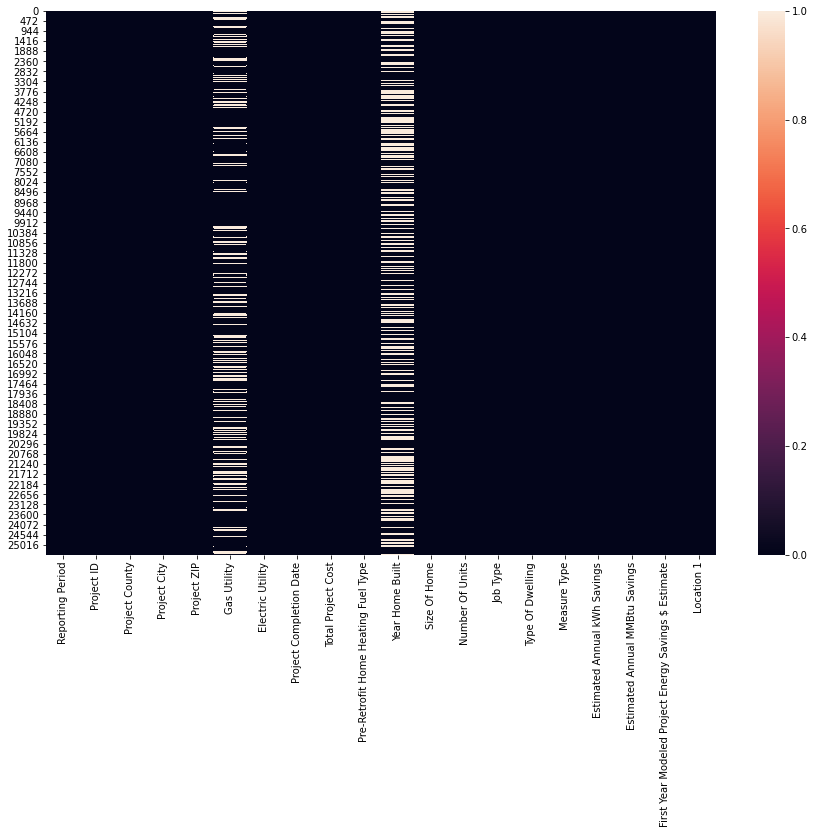

In [14]:
plt.figure(figsize=(15,10))
sns.heatmap(df.isna())
plt.show

- More than 10% null values in 'Gas Utility' and 'Year Home Built'. Hence, we drop both the columns.
- Only 0.004% or 1 null value in 'Number of Units'. Hence, we drop the null value row.

In [15]:
df.drop(['Gas Utility','Year Home Built'],axis=1,inplace=True) ## dropping the extreme null value columns
df.dropna(inplace=True) ## dkropping the null value row
print(df.shape) ## printing the shape of dataframe

(25478, 18)


In [16]:
## checking for null values again after treatment
for i in df:
  if ((df[i].isna().sum()/len(df[i]))*100)>0:
    print('Percentage of null values in',i,'is',round(((df[i].isna().sum()/len(df[i]))*100),3),'%')
  else:
    print('No null values in the dataset.')

No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.
No null values in the dataset.


- Checking for null values shows that null values have been treated.

### Fixing Duplicated Values

In [17]:
## check for duplicated rows 
df[df.duplicated()]

,Reporting Period,Project ID,Project County,Project City,Project ZIP,Electric Utility,Project Completion Date,Total Project Cost,Pre-Retrofit Home Heating Fuel Type,Size Of Home,Number Of Units,Job Type,Type Of Dwelling,Measure Type,Estimated Annual kWh Savings,Estimated Annual MMBtu Savings,First Year Modeled Project Energy Savings $ Estimate,Location 1


- No duplicated values.
- If duplicated values made after feature engineering, **ignore**

### Feature dType correction

In [18]:
## printing dataframe info to check wrongly specified feature dtype
print(df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 25478 entries, 0 to 25478
Data columns (total 18 columns):
 #   Column                                                Non-Null Count  Dtype  
---  ------                                                --------------  -----  
 0   Reporting Period                                      25478 non-null  object 
 1   Project ID                                            25478 non-null  object 
 2   Project County                                        25478 non-null  object 
 3   Project City                                          25478 non-null  object 
 4   Project ZIP                                           25478 non-null  int64  
 5   Electric Utility                                      25478 non-null  object 
 6   Project Completion Date                               25478 non-null  object 
 7   Total Project Cost                                    25478 non-null  float64
 8   Pre-Retrofit Home Heating Fuel Type                   25

- 'Size of Home' is wrongly specified to be 'object' type.
- Need to be changed to 'numeric' type.

#### Fixing 'Size of Home'

In [19]:
## printing unique values to understand values to fix
print(df['Size Of Home'].unique())

['802' '1,326' '952' '972' '1,700' '840' '1,710' '924' '1,350' '1,560'
 '1,264' '1,760' '1,089' '1,780' '1,118' '944' '1,272' '982' '2,012'
 '1,773' '931' '1,276' '864' '2,200' '980' '1,260' '1,652' '3,300' '927'
 '2,766' '1,816' '3,046' '1,346' '1,224' '1,768' '1,500' '812' '1,387'
 '2,520' '1,740' '1,840' '1,454' '1,220' '1,232' '1,620' '1,598'
 'Report SF less than 800' '1,488' '1,306' '1,280' '878' '1,820' '2,372'
 '1,250' '2,202' '1,249' '1,936' '1,844' '1,153' '1,074' '1,053' '1,650'
 '2,244' '1,544' '1,870' '1,575' '1,258' '1,248' '820' '2,432' '1,216'
 '1,951' '1,619' '1,984' '1,320' '2,368' '1,012' '1,008' '1,440' '1,367'
 '920' '1,137' '1,200' '2,302' '896' '1,728' '1,462' '1,504' '1,920'
 '1,980' '1,562' '2,794' '1,080' '1,404' '1,014' '1,818' '2,016' '1,632'
 '800' '1,148' '2,204' '3,460' '1,868' '1,672' '1,296' '1,132' '1,110'
 '1,864' '1,120' '1,360' '2,656' '945' '1,040' '1,016' '1,208' '1,244'
 '960' '2,844' '1,344' '2,350' '1,916' '875' '1,736' '2,418' '1,704' '986'
 '

In [20]:
df['Size Of Home'] = df['Size Of Home'].str.replace(',', '') ## replacing ',' with empty field
df['Size Of Home'] = df['Size Of Home'].str.strip('Report SF less than ') ## stripping string value 
df['Size Of Home'] = df['Size Of Home'].str.strip('more than ') ## again stripping string value
df['Size Of Home'] = df['Size Of Home'].astype(np.number) ## changing the dtype by using astype

In [21]:
## printing DataFrame information to see if the correction has been made successfully
print(df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 25478 entries, 0 to 25478
Data columns (total 18 columns):
 #   Column                                                Non-Null Count  Dtype  
---  ------                                                --------------  -----  
 0   Reporting Period                                      25478 non-null  object 
 1   Project ID                                            25478 non-null  object 
 2   Project County                                        25478 non-null  object 
 3   Project City                                          25478 non-null  object 
 4   Project ZIP                                           25478 non-null  int64  
 5   Electric Utility                                      25478 non-null  object 
 6   Project Completion Date                               25478 non-null  object 
 7   Total Project Cost                                    25478 non-null  float64
 8   Pre-Retrofit Home Heating Fuel Type                   25

### Feature Engineering

#### Extracting only year from 'Project Completion Date'

In [22]:
## printing unique values to understand what values to strip
print(df['Project Completion Date'].unique())

['01/04/2018' '03/06/2018' '03/28/2018' '04/13/2018' '04/20/2018'
 '04/24/2018' '05/01/2018' '05/18/2018' '06/14/2018' '06/18/2018'
 '06/25/2018' '07/13/2018' '07/23/2018' '08/02/2018' '08/17/2018'
 '08/23/2018' '08/27/2018' '08/30/2018' '10/01/2018' '10/04/2018'
 '11/02/2018' '11/27/2018' '12/06/2018' '01/17/2019' '01/21/2019'
 '02/04/2019' '02/05/2019' '03/11/2019' '03/28/2019' '04/04/2019'
 '04/16/2019' '05/15/2019' '06/11/2019' '06/21/2019' '07/08/2019'
 '07/11/2019' '08/02/2019' '08/26/2019' '09/11/2019' '10/04/2019'
 '10/14/2019' '10/24/2019' '12/13/2019' '01/20/2020' '02/04/2020'
 '02/14/2020' '02/21/2020' '03/03/2020' '03/06/2020' '03/26/2020'
 '07/14/2020' '08/11/2020' '08/13/2020' '10/22/2020' '11/03/2020'
 '11/06/2020' '11/12/2020' '11/18/2020' '01/05/2021' '01/07/2021'
 '01/02/2019' '02/06/2018' '07/26/2019' '10/17/2019' '01/07/2020'
 '02/16/2018' '04/01/2019' '10/10/2019' '09/25/2019' '09/11/2018'
 '11/06/2018' '09/05/2018' '08/29/2019' '02/25/2019' '05/08/2019'
 '06/13/20

In [23]:
df['Project Completion Year'] = df['Project Completion Date'] ## creating a new variable based on 'Project Completion Year' from  'Project Completion Date'
df['Project Completion Year'] = df['Project Completion Year'].str[6:] ## stripping values till we get only the year
print(df['Project Completion Year'].unique()) ## checking unique values again to see if stripping is successful

['2018' '2019' '2020' '2021']


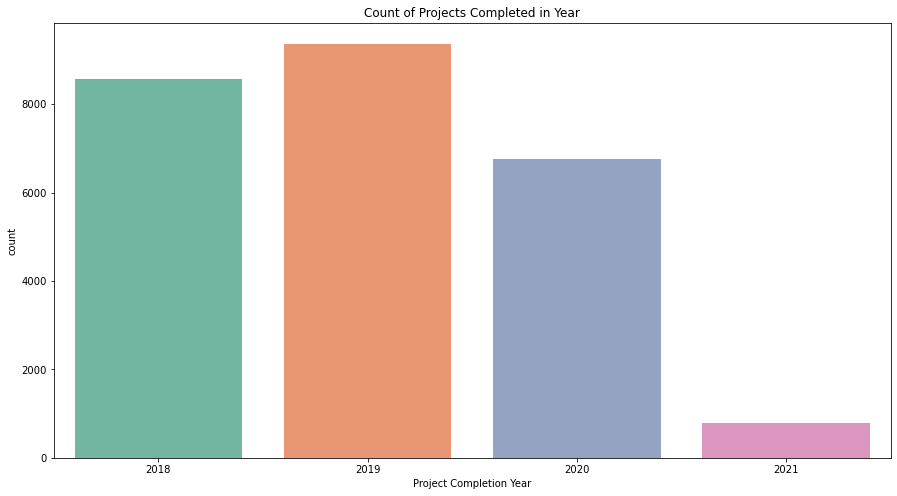

In [24]:
sns.countplot(x='Project Completion Year',data = df)
plt.title('Count of Projects Completed in Year')
plt.show()

In [25]:
df = df[df['Project Completion Year'] != '2021']

In [26]:
df.shape

(24699, 19)

#### Extracting only Month from 'Project Completion Date'

In [27]:
df['Billing Month'] = df['Project Completion Date'] ## creating a new variable based on the billing cycle from  'Project Completion Date'
df['Billing Month'] = df['Billing Month'].str[:2] ## stripping values till we get only the month
df['Billing Month'].replace({'01':'January','02':'February','03':'March',
                                 '04':'April','05':'May','06':'June','07':'July',
                                 '08':'August','09':'September','10':'October',
                                 '11':'November','12':'December'},inplace=True) ## Assigning month names
print(df['Billing Month'].unique()) ## checking unique values again to see if stripping is successful

['January' 'March' 'April' 'May' 'June' 'July' 'August' 'October'
 'November' 'December' 'February' 'September']


#### Extracting 'Latitude' and 'Longitude' from 'Location 1'

In [28]:
df['Location 1'] = df['Location 1'].str.split('(').str[1] ## stripping till '(' caharacter
df['Location 1'] = df['Location 1'].str.split(')').str[0] ## stripping the ')' character
df[['Latitude', 'Longitude']] = df['Location 1'].str.split(',', 1, expand=True) ## dividing 'Location 1' to 'Latitude' and 'Longitude' columns
df['Latitude'] = df['Latitude'].astype(np.number) ## fixing dType of 'Latitude' variable
df['Longitude'] = df['Longitude'].astype(np.number) ## fixing dType of 'Longitude' variable
df.drop('Location 1',axis=1,inplace=True) ## removing the unnecessary 'Location 1' variable

#### Creating new feature from 'Project County'

In [29]:
## Checking unique county names
print(df['Project County'].unique())

['Niagara' 'Orleans' 'Oneida' 'Onondaga' 'Suffolk' 'Kings' 'Steuben'
 'Essex' 'Bronx' 'Tioga' 'New York' 'Cortland' 'Lewis' 'Nassau' 'Albany'
 'Oswego' 'Wyoming' 'Sullivan' 'Herkimer' 'Queens' 'Livingston' 'Chenango'
 'Jefferson' 'Rensselaer' 'Wayne' 'Orange' 'Chautauqua' 'Delaware' 'Erie'
 'Monroe' 'St. Lawrence' 'Putnam' 'Broome' 'Allegany' 'Ulster' 'Clinton'
 'Seneca' 'Rockland' 'Chemung' 'Dutchess' 'Washington' 'Fulton' 'Madison'
 'Schenectady' 'Columbia' 'Genesee' 'Westchester' 'Otsego' 'Cattaraugus'
 'Ontario' 'Yates' 'Franklin' 'Cayuga' 'Warren' 'Saratoga' 'Tompkins'
 'Richmond' 'Greene' 'Montgomery' 'Schuyler' 'Schoharie' 'Hamilton']


In [30]:
## Creating new column 'Region' from 'Project County' and replacing unique counties with region names
df['Region'] = df['Project County']

## Central Region
df['Region'] = df['Region'].replace(['Oneida','Onondaga','Tioga','Cortland',
                                             'Chenango','Broome','Seneca',
                                             'Chemung','Madison','Otsego','Cayuga',
                                             'Tompkins','Schuyler'],'Central')
## East Region
df['Region'] = df['Region'].replace(['Albany','Rensselaer','Delaware','Columbia','Ulster',
                                             'Dutchess','Washington','Sullivan','Fulton','Schenectady',
                                             'Saratoga','Greene','Montgomery','Schoharie'],'East')
## West Region
df['Region'] = df['Region'].replace(['Niagara','Orleans','Steuben','Wyoming','Livingston',
                                             'Wayne','Chautauqua','Erie','Monroe','Allegany',
                                             'Genesee','Cattaraugus','Ontario','Yates'],'West')
## North Region
df['Region'] = df['Region'].replace(['Essex','Lewis','Oswego','Herkimer','Jefferson',
                                             'St. Lawrence','Clinton','Franklin','Warren',
                                             'Hamilton'],'North')
## South Region
df['Region'] = df['Region'].replace(['Suffolk','Kings','Bronx','New York','Nassau',
                                             'Queens','Orange','Putnam','Rockland','Westchester',
                                             'Richmond'],'South')

In [31]:
df['Region'].value_counts(normalize=True)*100

West       38.090611
Central    24.211507
South      22.547472
North       8.376857
East        6.773554
Name: Region, dtype: float64

In [32]:
#df['Region'] = df['Project County']


## West Region
#df['Region'] = df['Region'].replace(['Niagara','Orleans','Steuben','Wyoming','Livingston',
#                                             'Wayne','Chautauqua','Erie','Monroe','Allegany',
#                                             'Genesee','Cattaraugus','Ontario','Yates'],'West')

## Central Region
#df['Region'] = df['Region'].replace(['Oneida','Onondaga','Tioga','Cortland',
#                                             'Chenango','Broome','Seneca',
#                                             'Chemung','Madison','Otsego','Cayuga',
#                                             'Tompkins','Schuyler','Essex','Lewis','Oswego','Herkimer','Jefferson',
#                                             'St. Lawrence','Clinton','Franklin','Warren',
#                                             'Hamilton'],'Central')

## East Region
#df['Region'] = df['Region'].replace(['Suffolk','Kings','Bronx','New York','Nassau',
#                                             'Queens','Orange','Putnam','Rockland','Westchester',
#                                             'Richmond','Albany','Rensselaer','Delaware','Columbia','Ulster',
#                                             'Dutchess','Washington','Sullivan','Fulton','Schenectady',
#                                             'Saratoga','Greene','Montgomery','Schoharie'],'East')

In [33]:
#df['Region'].value_counts(normalize=True)*100

#### New Variable based 'Type of Home Size' on 'Size of Home'

In [34]:
## checking descriptive statistics for size of home
df['Size Of Home'].describe()

count    24699.000000
mean      1508.139155
std        592.011232
min        800.000000
25%       1064.000000
50%       1380.000000
75%       1800.000000
max       4000.000000
Name: Size Of Home, dtype: float64

In [35]:
## making a new variable 'Size of Residence' from 'Size of Home'
df['Type of Home Size'] = df['Size Of Home']
## label encoding 'Size of Residence' based on 'Large', 'Medium' and 'Small'
df['Type of Home Size'] = ['Large' if x>1803 
                           else 'Medium' if 1803>=x>1064 
                           else 'Small' 
                           for x in df['Type of Home Size']]

In [36]:
## checking value counts of Type of Home Size
df['Type of Home Size'].value_counts()

Medium    12254
Small      6289
Large      6156
Name: Type of Home Size, dtype: int64

#### Removing Unnecessary Features 

In [37]:
## 'Reporting Period', 'Project ID' and 'Project ZIP' are not needed for further analysis
df.drop(['Reporting Period','Project ID','Project ZIP'],axis=1,inplace=True)

#### Cleaned Dataset

In [38]:
## showing cleaned DataFrame
df

,Project County,Project City,Electric Utility,Project Completion Date,Total Project Cost,Pre-Retrofit Home Heating Fuel Type,Size Of Home,Number Of Units,Job Type,Type Of Dwelling,Measure Type,Estimated Annual kWh Savings,Estimated Annual MMBtu Savings,First Year Modeled Project Energy Savings $ Estimate,Project Completion Year,Billing Month,Latitude,Longitude,Region,Type of Home Size
0,Niagara,Sanborn,National Grid,01/04/2018,3048.0,Natural Gas,802.0,1.0,Home Performance,Mobile,Building Shell,0.0,15.0,238.0,2018,January,43.146095,-78.876048,West,Small
1,Orleans,Holley,National Grid,03/06/2018,6651.0,Propane,1326.0,1.0,Home Performance,Mobile,Building Shell,510.0,46.0,514.0,2018,March,43.211567,-78.054132,West,Medium
2,Oneida,Rome,National Grid,03/06/2018,5071.0,Kerosene,952.0,1.0,Home Performance,Mobile,Building Shell,460.0,18.0,629.0,2018,March,43.214717,-75.454665,Central,Small
3,Oneida,Rome,National Grid,03/28/2018,5133.0,Oil,972.0,1.0,Home Performance,Mobile,Building Shell,510.0,13.0,407.0,2018,March,43.214717,-75.454665,Central,Small
4,Orleans,Kent,National Grid,04/13/2018,5475.0,Oil,1700.0,1.0,Home Performance,Single Family,Building Shell,0.0,34.0,718.0,2018,April,43.346379,-78.136510,West,Medium
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25474,Erie,Lackawanna,National Grid,09/01/2020,7776.0,Natural Gas,1008.0,1.0,Home Performance,Single Family,Building Shell,602.0,42.0,369.0,2020,September,42.818699,-78.818268,West,Small
25475,Kings,Brooklyn,Consolidated Edison,10/22/2020,4303.0,Oil,1280.0,1.0,Home Performance,Single Family,Building Shell,1136.0,10.0,440.0,2020,October,40.615992,-73.919271,South,Medium
25476,Otsego,Burlington Flats,New York State Electric & Gas,02/25/2020,6675.0,Kerosene,928.0,1.0,Home Performance,Mobile,Building Shell,301.0,34.0,930.0,2020,February,42.738700,-75.144789,Central,Small
25477,Erie,Buffalo,National Grid,07/14/2020,4684.0,Natural Gas,2750.0,1.0,Home Performance,Single Family,Building Shell,510.0,28.0,259.0,2020,July,42.948761,-78.898159,West,Large


In [39]:
## printing information of cleaned DataFrame
print(df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24699 entries, 0 to 25478
Data columns (total 20 columns):
 #   Column                                                Non-Null Count  Dtype  
---  ------                                                --------------  -----  
 0   Project County                                        24699 non-null  object 
 1   Project City                                          24699 non-null  object 
 2   Electric Utility                                      24699 non-null  object 
 3   Project Completion Date                               24699 non-null  object 
 4   Total Project Cost                                    24699 non-null  float64
 5   Pre-Retrofit Home Heating Fuel Type                   24699 non-null  object 
 6   Size Of Home                                          24699 non-null  float64
 7   Number Of Units                                       24699 non-null  float64
 8   Job Type                                              24

In [40]:
df1 = copy.deepcopy(df)

## Data Preprocessing (Part-2)

In [41]:
cat_cols = df.select_dtypes(include='object').columns ## selecting categorical columns into a list
cat_cols1 = df1.select_dtypes(include='object').columns
num_cols = df.select_dtypes(include=np.number).columns ## selecting numeric columns into a list
num_cols1 = df1.select_dtypes(include=np.number).columns

cat_dat = df.select_dtypes(include='object') ## selecting categorical columns into a dataset
cat_dat1 = df1.select_dtypes(include='object')
num_dat = df.select_dtypes(include=np.number) ## selecting numeric columns into a dataset
num_dat1 = df1.select_dtypes(include=np.number)

print('Categorical:',cat_cols) ## printing categorical column names
print('\n') ## for spacing
print('Numerical:',num_cols) ## printing numerical column names

Categorical: Index(['Project County', 'Project City', 'Electric Utility',
       'Project Completion Date', 'Pre-Retrofit Home Heating Fuel Type',
       'Job Type', 'Type Of Dwelling', 'Measure Type',
       'Project Completion Year', 'Billing Month', 'Region',
       'Type of Home Size'],
      dtype='object')


Numerical: Index(['Total Project Cost', 'Size Of Home', 'Number Of Units',
       'Estimated Annual kWh Savings', 'Estimated Annual MMBtu Savings',
       'First Year Modeled Project Energy Savings $ Estimate', 'Latitude',
       'Longitude'],
      dtype='object')


### Outlier Treatment

#### Case 1: Outliers not removed

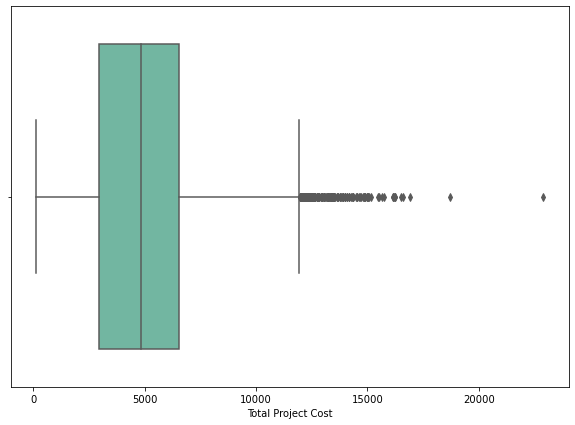

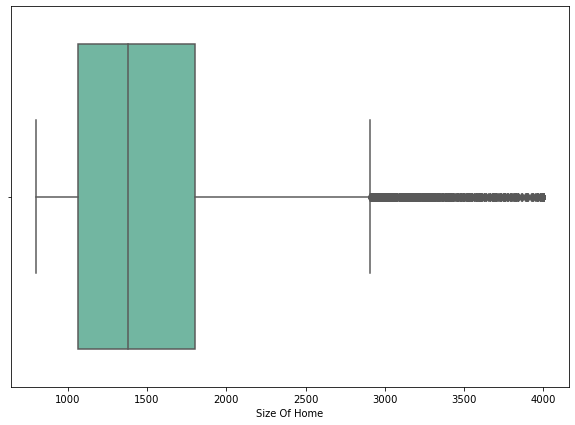

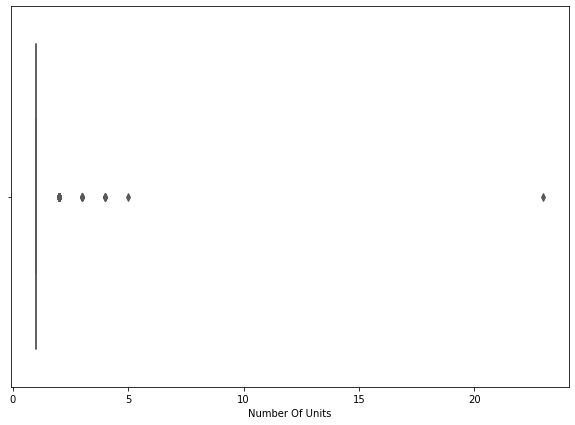

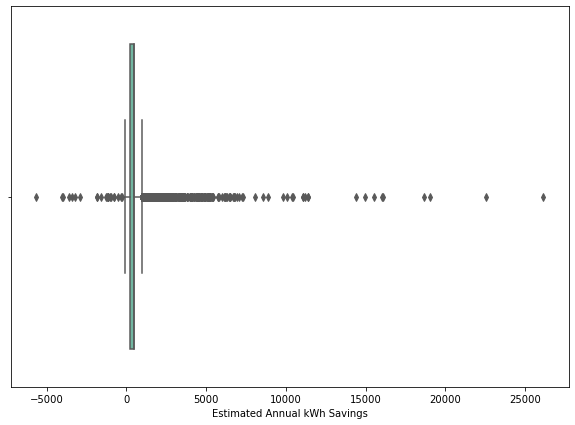

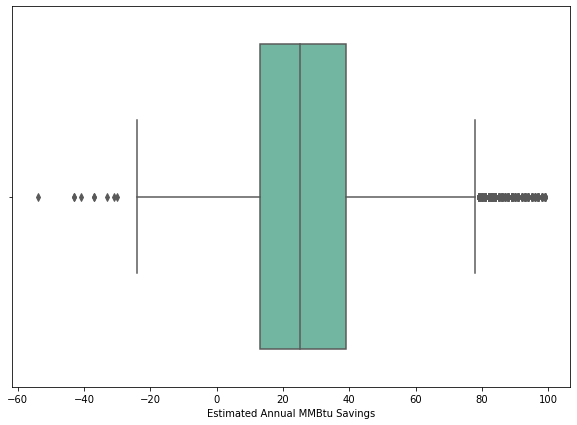

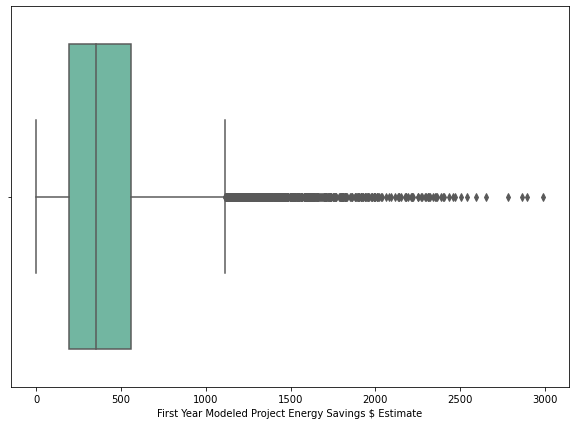

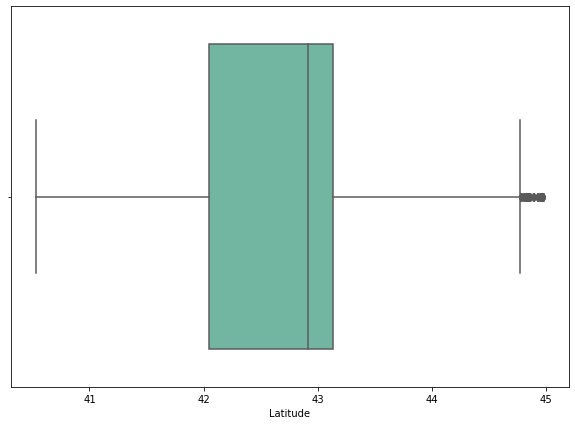

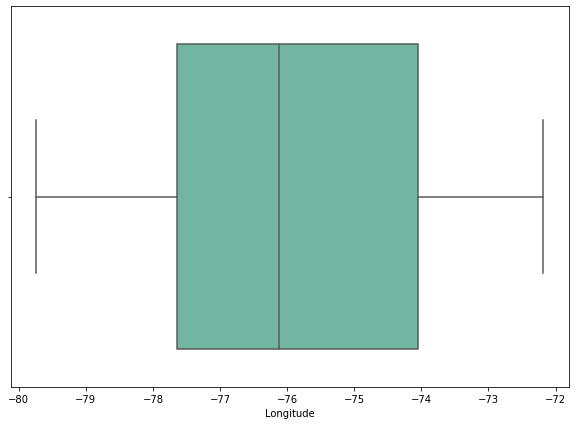

In [42]:
## checking for outliers and extreme values
for i in df.select_dtypes(np.number):
    plt.figure(figsize=(10,7))
    sns.boxplot(df[i])
    plt.show()

- Outliers shouldn't be removed as the dataset will introduce bias towards projects.
- We will further transform it to make the distributions more Gaussian-like.

In [43]:
# calculate interquartile range 

# compute the first quartile using quantile(0.25)
# use .drop() to drop the target variable 
# axis=1: specifies that the labels are dropped from the columns
Q1 = num_dat.drop(['First Year Modeled Project Energy Savings $ Estimate',
                   'Estimated Annual MMBtu Savings','Estimated Annual kWh Savings',
                   'Number Of Units','Longitude','Latitude'], axis=1).quantile(0.25)

# compute the first quartile using quantile(0.75)
# use .drop() to drop the target variable 
# axis=1: specifies that the labels are dropped from the columns
Q3 = num_dat.drop(['First Year Modeled Project Energy Savings $ Estimate',
                   'Estimated Annual MMBtu Savings','Estimated Annual kWh Savings',
                   'Number Of Units','Longitude','Latitude'], axis=1).quantile(0.75)

# calculate of interquartile range 
IQR = Q3 - Q1

# filter out the outlier values
# ~ : selects all rows which do not satisfy the condition
# |: bitwise operator OR in python
# any() : returns whether any element is True over the columns
# axis : "1" indicates columns should be altered (use "0" for 'index')
df = df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)]

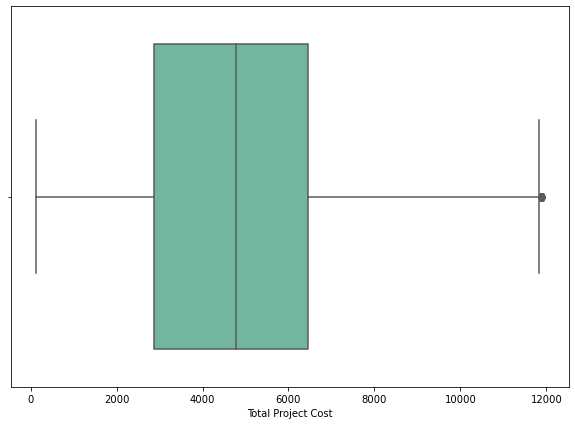

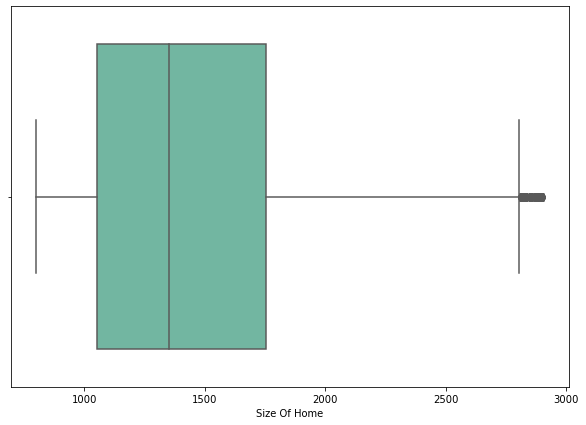

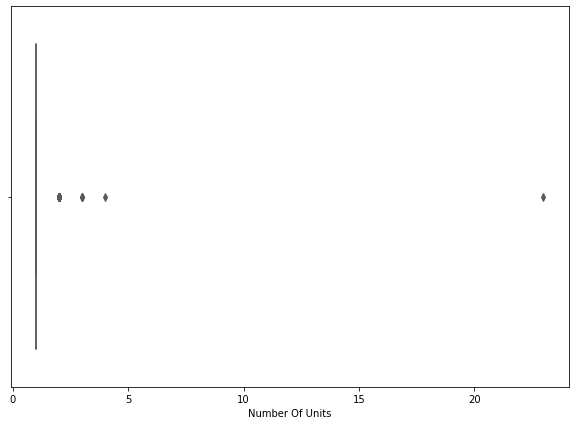

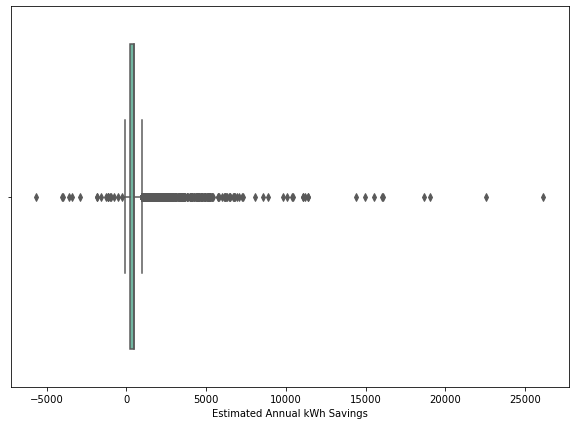

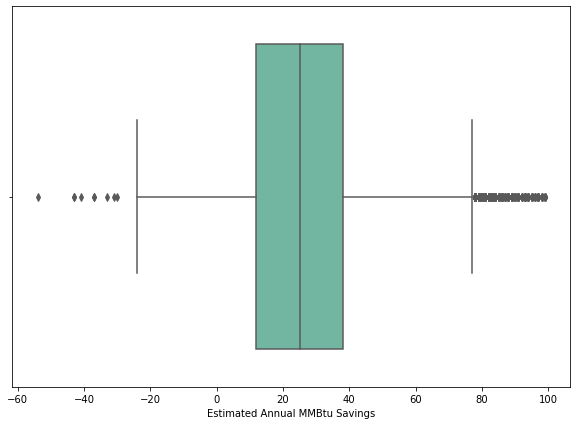

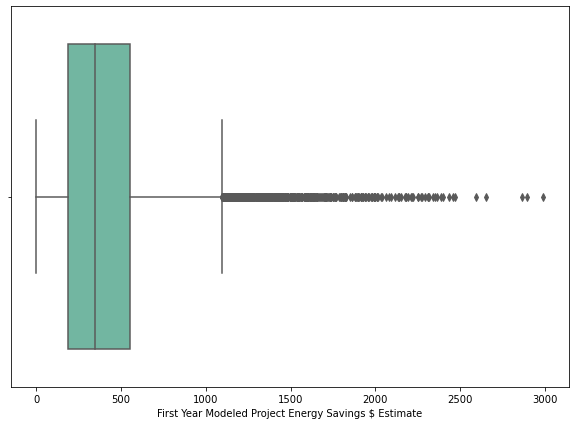

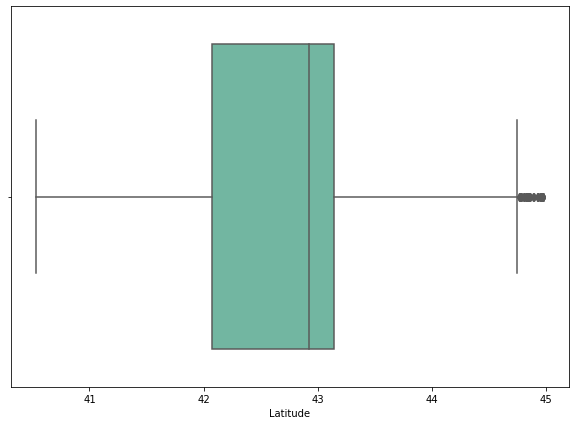

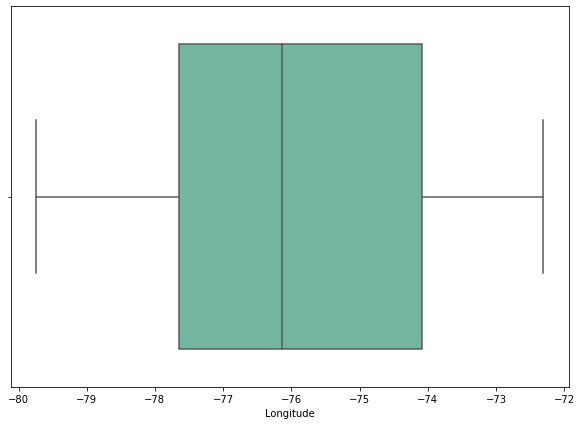

In [44]:
for i in df.select_dtypes(np.number):
    plt.figure(figsize=(10,7))
    sns.boxplot(df[i])
    plt.show()

In [45]:
df.shape

(23762, 20)

#### Case 2: Outliers Removed

In [46]:
# calculate interquartile range 

# compute the first quartile using quantile(0.25)
# use .drop() to drop the target variable 
# axis=1: specifies that the labels are dropped from the columns
Q11 = num_dat1.drop(['Longitude','Latitude'], axis=1).quantile(0.25)

# compute the first quartile using quantile(0.75)
# use .drop() to drop the target variable 
# axis=1: specifies that the labels are dropped from the columns
Q31 = num_dat1.drop(['Longitude','Latitude'], axis=1).quantile(0.75)

# calculate of interquartile range 
IQR1 = Q31 - Q11

# filter out the outlier values
# ~ : selects all rows which do not satisfy the condition
# |: bitwise operator OR in python
# any() : returns whether any element is True over the columns
# axis : "1" indicates columns should be altered (use "0" for 'index')
df1 = df1[~((df1 < (Q1 - 1.5 * IQR1)) | (df1 > (Q31 + 1.5 * IQR1))).any(axis=1)]

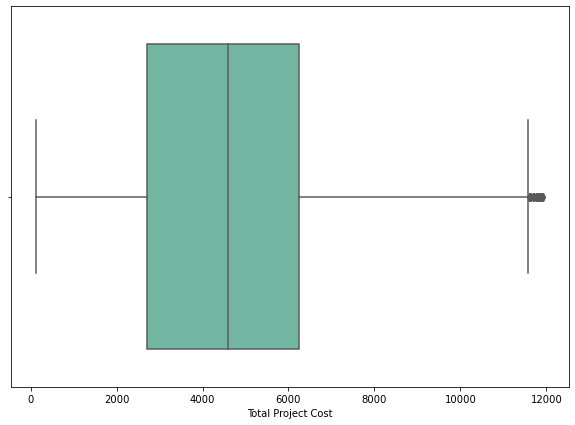

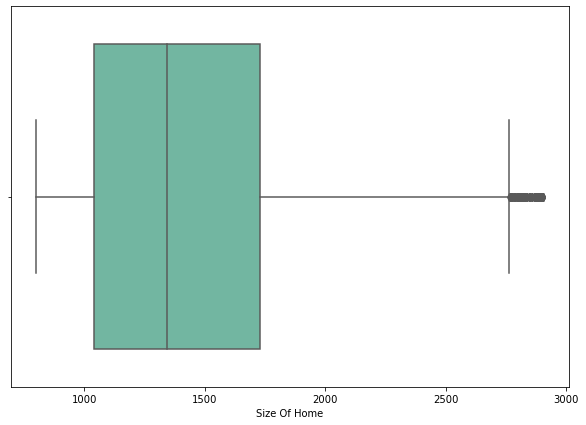

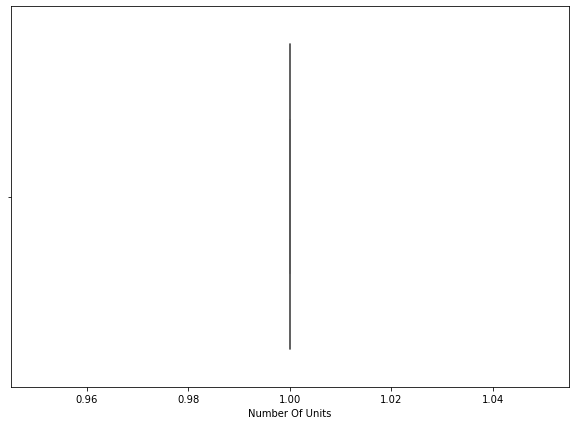

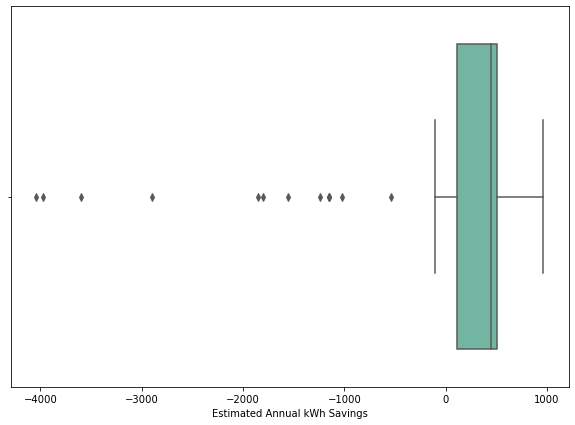

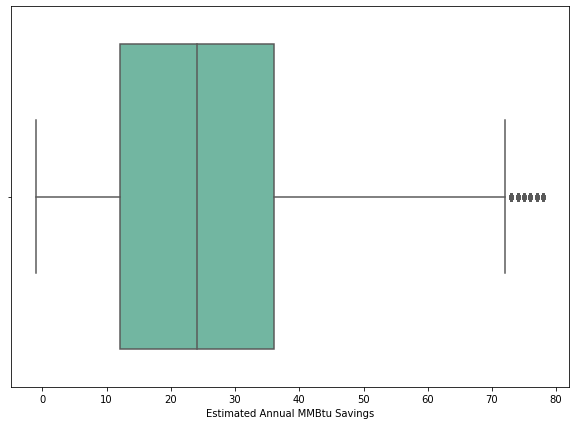

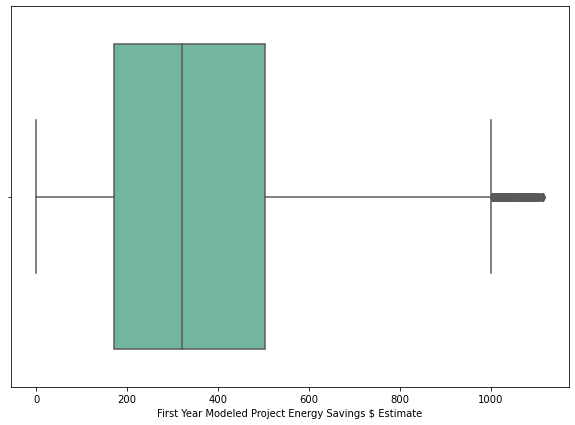

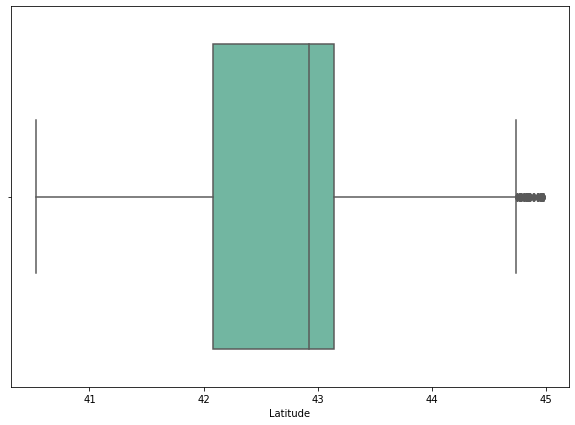

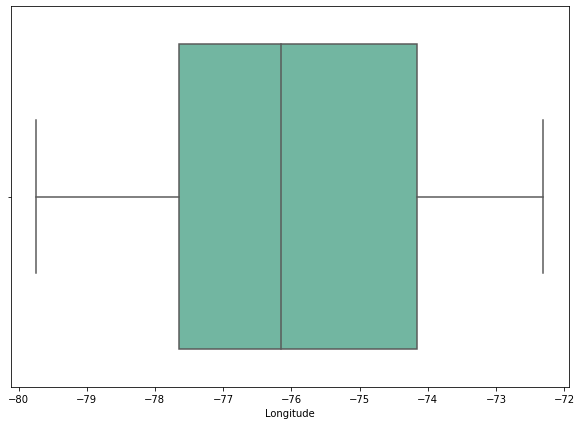

In [47]:
for i in df1.select_dtypes(np.number):
    plt.figure(figsize=(10,7))
    sns.boxplot(df1[i])
    plt.show()

In [48]:
df1.shape

(20861, 20)

### Transformation of Numerical Variables

#### Sqrt Transformation

In [49]:
#df['sqr$'] = np.sqrt(df['First Year Modeled Project Energy Savings $ Estimate'])
#df1['sqr$1'] = np.sqrt(df1['First Year Modeled Project Energy Savings $ Estimate'])

#df.isnull().sum()

In [50]:
#f, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,6))
#sns.distplot(df['sqr$'],ax=ax1)
#sns.distplot(df1['sqr$1'],ax=ax2)
#plt.tight_layout()
#plt.show()

#### Standard Scaling

In [51]:
#ss = StandardScaler() ## assigning StandardScaler

#num_t = ss.fit_transform(df.select_dtypes(np.number)) ## transforming numerical dataset with StandardScaler
#num_t_dat = pd.DataFrame(data=num_t,columns=df.select_dtypes(np.number).columns) ## creating new encoded DataFrame

#num_t1 = ss.fit_transform(df1.select_dtypes(np.number)) ## transforming numerical dataset with StandardScaler
#num_t_dat1 = pd.DataFrame(data=num_t1,columns=df1.select_dtypes(np.number).columns) ## creating new encoded DataFrame

In [52]:
## checking transformed numerical dataset information
#print(num_t_dat.info())

### Encoding Categorical Variables

In [53]:
## categorical dataset information to check for significant variables
#print(cat_dat.info())

In [54]:
## removing unnecesary variables
#cat_dat_dum = cat_dat.drop(['Project Completion Date','Project City','Project County'],axis=1)
#num_t_dat = num_t_dat.drop(['Latitude','Longitude'],axis=1)

#cat_dat_dum1 = cat_dat.drop(['Project Completion Date','Project City','Project County'],axis=1)
#num_t_dat1 = num_t_dat1.drop(['Latitude','Longitude'],axis=1)

In [55]:
## creating dummy variables for categorical dataset
#cat_dat_dumm = pd.get_dummies(cat_dat_dum,drop_first=True) ## one-hot encoding categorical dataset
#cat_dat_dumm1 = pd.get_dummies(cat_dat_dum1,drop_first=True) ## one-hot encoding categorical dataset

#print(cat_dat_dumm.shape) ## checking encoded categorical dataset shape
#print(cat_dat_dumm1.shape) ## checking encoded categorical dataset shape

In [56]:
## creating new encoded dataset which will be used for analysis
#df_en = cat_dat_dumm.join(num_t_dat,how='inner') ## using an inner-join function for creating a fully encoded dataset
#df_en1 = cat_dat_dumm1.join(num_t_dat1,how='inner') ## using an inner-join function for creating a fully encoded dataset

#df_noen = cat_dat_dumm.join(df.select_dtypes(np.number),how='inner')
#df_noen1 = cat_dat_dumm1.join(df1.select_dtypes(np.number),how='inner')
#df_noen = df_noen.drop(['Longitude','Latitude'],axis=1)
#df_noen1 = df_noen1.drop(['Longitude','Latitude'],axis=1)

#print(df_en.shape) ## checking final encoded dataset shape
#print(df_en1.shape) ## checking final encoded dataset shape
#print('\n')
#print(df_noen.shape) ## checking final encoded dataset shape
#print(df_noen1.shape) ## checking final encoded dataset shape

### Encoded Dataset

In [57]:
## Showing encoded DataFrame with outliers
#df_en.info()

In [58]:
## Showing unencoded dataframe with outliers
#df_noen.info()

## Dataframe for **Single Family Home Performance** done on **Building Shell** over homes having **Natural Gas Pre-Retrofitted Home Heating Fuel** type with only **1 Unit** served by the program

### Sort Dataset

In [59]:
# outliers

dfToD = df[df['Type Of Dwelling']=='Single Family']
print(dfToD['Type Of Dwelling'].unique())
print(dfToD.shape)
print('losing',df.shape[0]-dfToD.shape[0],'values')

print('\n')

dfJT = dfToD[dfToD['Job Type']=='Home Performance']
print(dfJT['Job Type'].unique())
print(dfJT.shape)
print('losing',df.shape[0]-dfJT.shape[0],'values')

print('\n')

dfPRF = dfJT[dfJT['Pre-Retrofit Home Heating Fuel Type']=='Natural Gas']
print(dfPRF['Pre-Retrofit Home Heating Fuel Type'].unique())
print(dfPRF.shape)
print('losing',df.shape[0]-dfPRF.shape[0],'values')
print('\n')

dfNOU = dfPRF[dfPRF['Number Of Units']==1]
print(dfNOU['Number Of Units'].unique())
print(dfNOU.shape)
print('losing',df.shape[0]-dfNOU.shape[0],'values')

print('\n')

dfMT = dfNOU[dfNOU['Measure Type']=="Building Shell"]
print(dfMT['Measure Type'].unique())
print(dfMT.shape)
print('losing',df.shape[0]-dfMT.shape[0],'values')

['Single Family']
(20543, 20)
losing 3219 values


['Home Performance']
(19178, 20)
losing 4584 values


['Natural Gas']
(14657, 20)
losing 9105 values


[1.]
(14622, 20)
losing 9140 values


['Building Shell']
(14474, 20)
losing 9288 values


In [60]:
# outliers removed

dfToD1 = df1[df1['Type Of Dwelling']=='Single Family']
print(dfToD1['Type Of Dwelling'].unique())
print(dfToD1.shape)
print('losing',df1.shape[0]-dfToD1.shape[0],'values')

print('\n')

dfJT1 = dfToD1[dfToD1['Job Type']=='Home Performance']
print(dfJT1['Job Type'].unique())
print(dfJT1.shape)
print('losing',df1.shape[0]-dfJT.shape[0],'values')

print('\n')

dfPRF1 = dfJT1[dfJT1['Pre-Retrofit Home Heating Fuel Type']=='Natural Gas']
print(dfPRF1['Pre-Retrofit Home Heating Fuel Type'].unique())
print(dfPRF1.shape)
print('losing',df1.shape[0]-dfPRF1.shape[0],'values')
print('\n')

dfNOU1 = dfPRF1[dfPRF1['Number Of Units']==1]
print(dfNOU1['Number Of Units'].unique())
print(dfNOU1.shape)
print('losing',df1.shape[0]-dfNOU1.shape[0],'values')

print('\n')

dfMT1 = dfNOU1[dfNOU1['Measure Type']=="Building Shell"]
print(dfMT1['Measure Type'].unique())
print(dfMT1.shape)
print('losing',df1.shape[0]-dfMT1.shape[0],'values')

['Single Family']
(17951, 20)
losing 2910 values


['Home Performance']
(16636, 20)
losing 1683 values


['Natural Gas']
(12914, 20)
losing 7947 values


[1.]
(12914, 20)
losing 7947 values


['Building Shell']
(12784, 20)
losing 8077 values


In [61]:
# outliers
dfMT['Region'].value_counts()

West       7178
Central    3253
South      2946
North       595
East        502
Name: Region, dtype: int64

In [62]:
# outliers removed
dfMT1['Region'].value_counts()

West       6490
Central    2951
South      2366
North       528
East        449
Name: Region, dtype: int64

In [63]:
# outliers

dfMT['Region'] = dfMT['Project County']


## West Region
dfMT['Region'] = dfMT['Region'].replace(['Niagara','Orleans','Steuben','Wyoming','Livingston',
                                             'Wayne','Chautauqua','Erie','Monroe','Allegany',
                                             'Genesee','Cattaraugus','Ontario','Yates'],'West')

## Central Region
dfMT['Region'] = dfMT['Region'].replace(['Oneida','Onondaga','Tioga','Cortland',
                                             'Chenango','Broome','Seneca',
                                             'Chemung','Madison','Otsego','Cayuga',
                                             'Tompkins','Schuyler','Essex','Lewis','Oswego',
                                         'Herkimer','Jefferson','St. Lawrence',
                                         'Clinton','Franklin','Warren', 'Hamilton'],'Central')

## East Region
dfMT['Region'] = dfMT['Region'].replace(['Suffolk','Kings','Bronx','New York','Nassau',
                                             'Queens','Orange','Putnam','Rockland','Westchester',
                                             'Richmond','Albany','Rensselaer','Delaware','Columbia','Ulster',
                                             'Dutchess','Washington','Sullivan','Fulton','Schenectady',
                                             'Saratoga','Greene','Montgomery','Schoharie'],'East')

In [64]:
# outliers removed

dfMT1['Region'] = dfMT1['Project County']


## West Region
dfMT1['Region'] = dfMT1['Region'].replace(['Niagara','Orleans','Steuben','Wyoming','Livingston',
                                             'Wayne','Chautauqua','Erie','Monroe','Allegany',
                                             'Genesee','Cattaraugus','Ontario','Yates'],'West')

## Central Region
dfMT1['Region'] = dfMT1['Region'].replace(['Oneida','Onondaga','Tioga','Cortland',
                                             'Chenango','Broome','Seneca',
                                             'Chemung','Madison','Otsego','Cayuga',
                                             'Tompkins','Schuyler','Essex','Lewis','Oswego','Herkimer','Jefferson',
                                             'St. Lawrence','Clinton','Franklin','Warren',
                                             'Hamilton'],'Central')

## East Region
dfMT1['Region'] = dfMT1['Region'].replace(['Suffolk','Kings','Bronx','New York','Nassau',
                                             'Queens','Orange','Putnam','Rockland','Westchester',
                                             'Richmond','Albany','Rensselaer','Delaware','Columbia','Ulster',
                                             'Dutchess','Washington','Sullivan','Fulton','Schenectady',
                                             'Saratoga','Greene','Montgomery','Schoharie'],'East')

In [65]:
# outliers
dfMT['Region'].value_counts()

West       7178
Central    3848
East       3448
Name: Region, dtype: int64

In [66]:
# outliers removed
dfMT1['Region'].value_counts()

West       6490
Central    3479
East       2815
Name: Region, dtype: int64

In [67]:
print('dfMT shape:',dfMT.shape)
print('dfMT1 shape:',dfMT1.shape)
print('Difference between dfMT and dfMT1',dfMT.shape[0]-dfMT1.shape[0])

dfMT shape: (14474, 20)
dfMT1 shape: (12784, 20)
Difference between dfMT and dfMT1 1690


In [68]:
# outliers
dfMT = dfMT.drop(['Type Of Dwelling','Job Type','Pre-Retrofit Home Heating Fuel Type',
                    'Type of Home Size','Number Of Units','Measure Type'],axis=1)
# outliers removed
dfMT1 = dfMT1.drop(['Type Of Dwelling','Job Type','Pre-Retrofit Home Heating Fuel Type',
                    'Type of Home Size','Number Of Units','Measure Type'],axis=1)

In [69]:
# outliers
dfMT_unenc = dfMT.drop(['Project City', 'Project County', 'Project Completion Date','Latitude','Longitude'],axis=1)

# outliers removed
dfMT_unenc1 = dfMT1.drop(['Project City', 'Project County', 'Project Completion Date','Latitude','Longitude'],axis=1)

In [70]:
print("outliers df:",dfMT_unenc.shape)
print("outliers removed df:",dfMT_unenc1.shape)

outliers df: (14474, 9)
outliers removed df: (12784, 9)


In [71]:
dfMT_unenc.head()

,Electric Utility,Total Project Cost,Size Of Home,Estimated Annual kWh Savings,Estimated Annual MMBtu Savings,First Year Modeled Project Energy Savings $ Estimate,Project Completion Year,Billing Month,Region
9,Consolidated Edison,6952.0,1560.0,748.0,44.0,731.0,2018,May,East
13,National Grid,5269.0,1350.0,5291.0,4.0,777.0,2018,June,Central
16,Municipal,1189.0,1780.0,0.0,5.0,55.0,2018,August,Central
24,National Grid,4088.0,1276.0,0.0,25.0,228.0,2018,November,East
31,National Grid,4998.0,840.0,1652.0,32.0,525.0,2019,March,Central


### Sqrt Transformation

In [72]:
# outliers
dfMT_unenc['$sqr'] = np.sqrt(dfMT_unenc['First Year Modeled Project Energy Savings $ Estimate'])

# outliers removed
dfMT_unenc1['$sqr'] = np.sqrt(dfMT_unenc1['First Year Modeled Project Energy Savings $ Estimate'])

In [73]:
# outliers
XMT = dfMT_unenc.drop(['First Year Modeled Project Energy Savings $ Estimate','$sqr'],axis=1)
yMT = dfMT_unenc['First Year Modeled Project Energy Savings $ Estimate']
yMTs = dfMT_unenc['$sqr']

# outliers removed
XMT1 = dfMT_unenc1.drop(['First Year Modeled Project Energy Savings $ Estimate','$sqr'],axis=1)
yMT1 = dfMT_unenc1['First Year Modeled Project Energy Savings $ Estimate']
yMTs1 = dfMT_unenc1['$sqr']

### OLS Base Model

#### Encoding

In [74]:
# outliers
dfMT_unenc_oh = pd.get_dummies(dfMT_unenc,drop_first=True)

# outliers removed
dfMT_unenc_oh1 = pd.get_dummies(dfMT_unenc1,drop_first=True)

In [75]:
# outliers
XMT_oh = dfMT_unenc_oh.drop(['First Year Modeled Project Energy Savings $ Estimate','$sqr'],axis=1)
yMT_oh = dfMT_unenc_oh['First Year Modeled Project Energy Savings $ Estimate']
yMT_ohs = dfMT_unenc_oh['$sqr']

# outliers removed
XMT_oh1 = dfMT_unenc_oh1.drop(['First Year Modeled Project Energy Savings $ Estimate','$sqr'],axis=1)
yMT_oh1 = dfMT_unenc_oh1['First Year Modeled Project Energy Savings $ Estimate']
yMT_ohs1 = dfMT_unenc_oh1["$sqr"]

<AxesSubplot:>

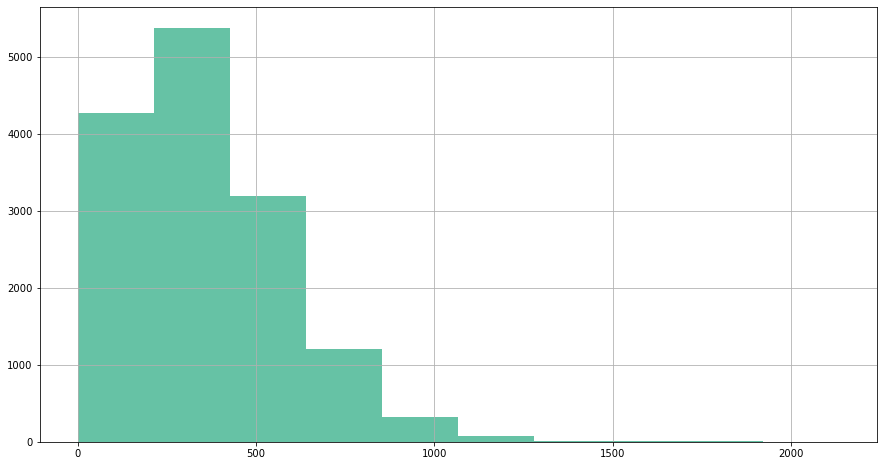

In [76]:
yMT_oh.hist()

<AxesSubplot:>

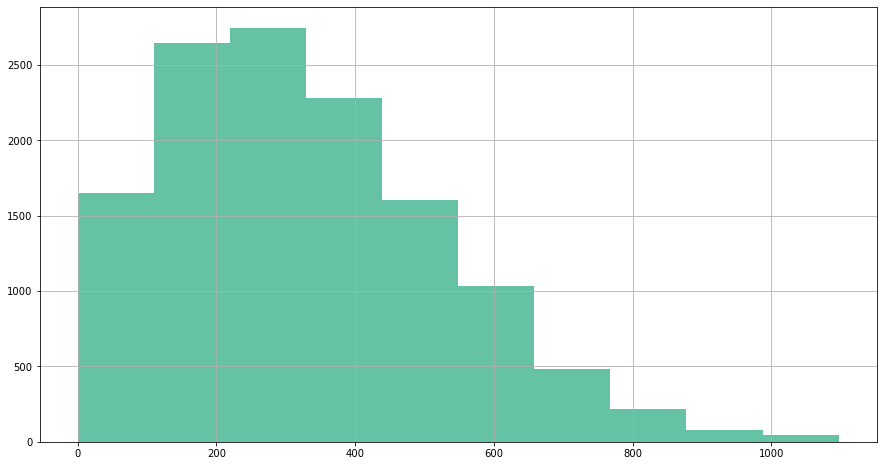

In [77]:
yMT_oh1.hist()

<AxesSubplot:>

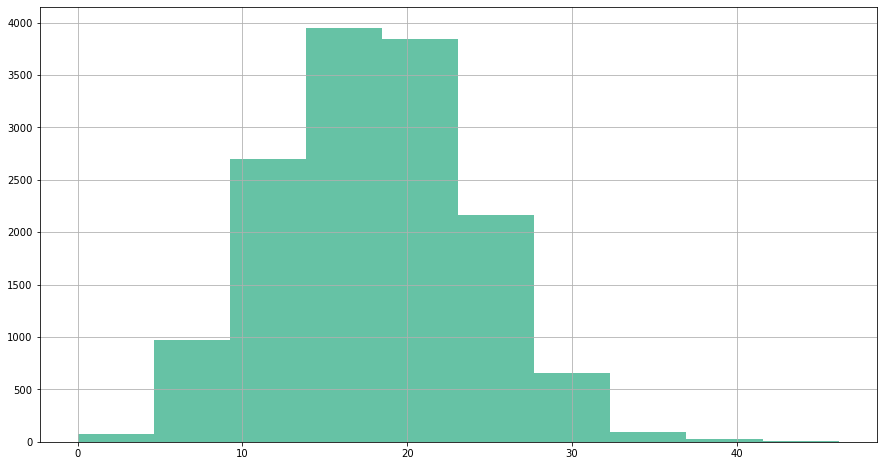

In [78]:
yMT_ohs.hist()

<AxesSubplot:>

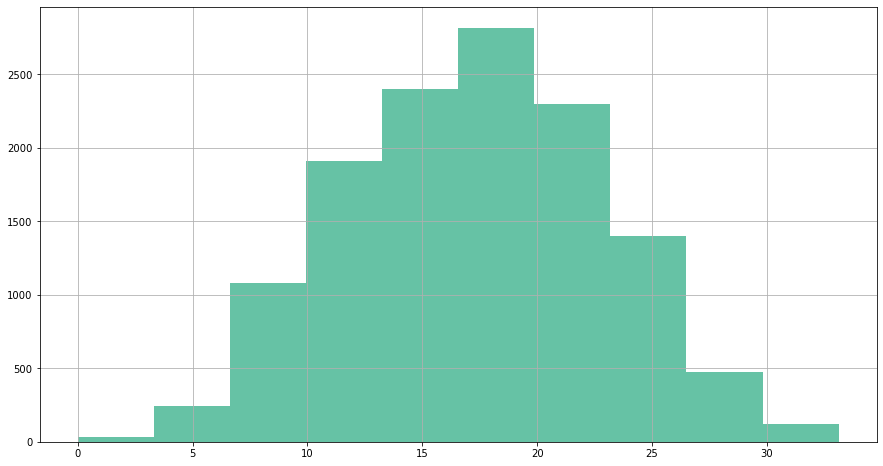

In [79]:
yMT_ohs1.hist()

#### Adding constant

In [80]:
# with outliers
XcMT_oh = sm.add_constant(XMT_oh)

# without outliers
XcMT_oh1 = sm.add_constant(XMT_oh1)

#### Fitting Base OLS Model

In [81]:
# with outliers
modelMT_oh = sm.OLS(yMT_oh,XcMT_oh).fit()

# without outliers
modelMT_oh1 = sm.OLS(yMT_oh1,XcMT_oh1).fit()

# with outliers and sqrt target
modelMT_ohs = sm.OLS(yMT_ohs,XcMT_oh).fit()

# without outliers and sqrt target
modelMT_ohs1 = sm.OLS(yMT_ohs1,XcMT_oh1).fit()

#### Defining function for backward elimination and ols models

In [82]:
def ols(Xc,X,y):
    def be(Xc,y,significance_level = 0.05):
        features = Xc.columns.tolist()
        while(len(features)>0):
            features_with_constant = sm.add_constant(Xc[features])
            p_values = sm.OLS(y,features_with_constant).fit().pvalues[1:]
            max_p_value = p_values.max()
            if(max_p_value >= significance_level):
                excluded_feature = p_values.idxmax()
                features.remove(excluded_feature)
            else:
                break
        return features
    Xc = Xc[be(Xc,y)] ## rejecting backward eliminated features
    model = sm.OLS(y,Xc).fit() ## fittind outliers
    return model.summary()

## View Base OLS models

### With outliers

In [83]:
ols(Xc=XcMT_oh,X=XMT_oh,y=yMT_oh)

<class 'statsmodels.iolib.summary.Summary'>
"""
                                             OLS Regression Results                                             
================================================================================================================
Dep. Variable:     First Year Modeled Project Energy Savings $ Estimate   R-squared:                       0.871
Model:                                                              OLS   Adj. R-squared:                  0.871
Method:                                                   Least Squares   F-statistic:                     5141.
Date:                                                  Mon, 19 Apr 2021   Prob (F-statistic):               0.00
Time:                                                          02:14:08   Log-Likelihood:                -84293.
No. Observations:                                                 14474   AIC:                         1.686e+05
Df Residuals:                                                     14454   BIC:                         1.688e+05
Df Model:                                                            19                                         
Covariance Type:                                              nonrobust                                         
==================================================================================================================
                                                     coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------
const                                            160.3582      5.374     29.840      0.000     149.825     170.892
Total Project Cost                                 0.0052      0.001     10.057      0.000       0.004       0.006
Size Of Home                                       0.0063      0.001      4.228      0.000       0.003       0.009
Estimated Annual kWh Savings                       0.1069      0.001     94.805      0.000       0.105       0.109
Estimated Annual MMBtu Savings                     9.0923      0.058    155.437      0.000       8.978       9.207
Electric Utility_Long Island Power Authority     -48.0865      9.959     -4.828      0.000     -67.608     -28.566
Electric Utility_Municipal                      -161.1276      6.634    -24.289      0.000    -174.131    -148.124
Electric Utility_National Grid                  -153.8722      4.271    -36.026      0.000    -162.244    -145.500
Electric Utility_New York State Electric & Gas  -131.6301      4.762    -27.643      0.000    -140.964    -122.297
Electric Utility_Orange & Rockland               -50.0172      4.007    -12.483      0.000     -57.871     -42.163
Electric Utility_Rochester Gas & Electric       -136.0501      4.708    -28.900      0.000    -145.278    -126.823
Project Completion Year_2019                     -43.1758      1.617    -26.709      0.000     -46.344     -40.007
Project Completion Year_2020                     -66.7809      1.838    -36.343      0.000     -70.383     -63.179
Billing Month_August                              -4.8260      2.384     -2.024      0.043      -9.499      -0.153
Billing Month_December                            -5.9452      2.686     -2.213      0.027     -11.210      -0.680
Billing Month_February                            14.6552      2.416      6.065      0.000       9.919      19.392
Billing Month_January                             15.6196      2.481      6.295      0.000      10.756      20.483
Billing Month_March                                9.1651      2.388      3.838      0.000       4.484      13.846
Region_East                                       13.4744      4.154      3.244      0.001       5.332      21.616
Region_West                                      -22.6730      1.893    -11.976      0.000     -26.384     -18.962
================================================================

In [84]:
## Multicollinearity
#residuals = model.resid
#y_pred = model.predict(XcMT_oh_be)
#vf = [vif(XcMT_oh_be.values,i) for i in range(XcMT_oh_be.shape[1])]
#vfdf = pd.DataFrame(vf, index= XcMT_oh_be.columns, columns=['VIF'])
#vfdf

In [85]:
## Autocorrelation
#residuals = model_MT_oh_be.resid
#y_pred = model_MT_oh_be.predict(XcMT_oh_be)
#fig, ax = plt.subplots(figsize=(8, 5))
#acf = smt.graphics.plot_acf(residuals,lags=30,ax=ax)
#acf.show()

In [86]:
## Homoscedasticity
#residuals = model_MT_oh_be.resid
#y_pred = model_MT_oh_be.predict(XcMT_oh_be)
#print(sms.het_goldfeldquandt(y=residuals,x=XcMT_oh_be))

In [87]:
## Normality of Residuals
#residuals = model_MT_oh_be.resid
#y_pred = model_MT_oh_be.predict(XcMT_oh_be)
#print(jarque_bera(residuals))

In [88]:
## Linearity of Relationship
#residuals = model_MT_oh_be.resid
#y_pred = model_MT_oh_be.predict(XcMT_oh_be)
#print(sm.stats.diagnostic.linear_rainbow(model_MT_oh_be))

### Without outliers

In [89]:
ols(Xc=XcMT_oh1,X=XcMT_oh1,y=yMT_oh1)

<class 'statsmodels.iolib.summary.Summary'>
"""
                                             OLS Regression Results                                             
================================================================================================================
Dep. Variable:     First Year Modeled Project Energy Savings $ Estimate   R-squared:                       0.919
Model:                                                              OLS   Adj. R-squared:                  0.919
Method:                                                   Least Squares   F-statistic:                     8477.
Date:                                                  Mon, 19 Apr 2021   Prob (F-statistic):               0.00
Time:                                                          02:14:08   Log-Likelihood:                -69650.
No. Observations:                                                 12784   AIC:                         1.393e+05
Df Residuals:                                                     12766   BIC:                         1.395e+05
Df Model:                                                            17                                         
Covariance Type:                                              nonrobust                                         
==================================================================================================================
                                                     coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------
const                                            144.3977      4.060     35.563      0.000     136.439     152.357
Total Project Cost                                 0.0032      0.000      8.183      0.000       0.002       0.004
Size Of Home                                       0.0050      0.001      4.552      0.000       0.003       0.007
Estimated Annual kWh Savings                       0.1211      0.002     57.697      0.000       0.117       0.125
Estimated Annual MMBtu Savings                     9.1558      0.047    194.861      0.000       9.064       9.248
Electric Utility_Long Island Power Authority     -37.5557      7.277     -5.161      0.000     -51.819     -23.293
Electric Utility_Municipal                      -145.6702      4.860    -29.976      0.000    -155.196    -136.145
Electric Utility_National Grid                  -144.4923      3.158    -45.759      0.000    -150.682    -138.303
Electric Utility_New York State Electric & Gas  -119.0381      3.501    -33.998      0.000    -125.901    -112.175
Electric Utility_Orange & Rockland               -34.2744      2.962    -11.571      0.000     -40.081     -28.468
Electric Utility_Rochester Gas & Electric       -127.3923      3.459    -36.831      0.000    -134.172    -120.612
Project Completion Year_2019                     -37.9369      1.182    -32.102      0.000     -40.253     -35.620
Project Completion Year_2020                     -59.3981      1.341    -44.308      0.000     -62.026     -56.770
Billing Month_February                            17.6361      1.740     10.137      0.000      14.226      21.046
Billing Month_January                             17.7743      1.765     10.070      0.000      14.315      21.234
Billing Month_March                               12.4081      1.707      7.270      0.000       9.063      15.754
Region_East                                        6.4692      3.026      2.138      0.033       0.538      12.400
Region_West                                      -17.1891      1.368    -12.563      0.000     -19.871     -14.507
==============================================================================
Omnibus:                     9660.065   Durbin-Watson:                   1.998
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           464451.770
Skew:                           3.171   Prob(JB):        

In [90]:
#fig = sm.graphics.plot_ccpr(prestige_model, "education")
#fig.tight_layout(pad=1.0)

In [91]:
## Normality of Residuals
#residuals = model_MT_oh_be1.resid
#y_pred = model_MT_oh_be1.predict(XcMT_oh_be1)
#print(jarque_bera(residuals))

In [92]:
## Homoscedasticity
#y_pred = model_MT_oh_be1.predict(XcMT_oh_be1)
#residuals = model_MT_oh_be1.resid
#print(sms.het_goldfeldquandt(y=residuals,x=XcMT_oh_be1))

In [93]:
## Linearity of Relationship
#residuals = model_MT_oh_be1.resid
#y_pred = model_MT_oh_be1.predict(XcMT_oh_be1)
#print(sm.stats.diagnostic.linear_rainbow(model_MT_oh_be1))

### With outliers and sqrt target

In [94]:
ols(Xc=XcMT_oh,X=XcMT_oh,y=yMT_ohs)

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   $sqr   R-squared:                       0.903
Model:                            OLS   Adj. R-squared:                  0.903
Method:                 Least Squares   F-statistic:                     5859.
Date:                Mon, 19 Apr 2021   Prob (F-statistic):               0.00
Time:                        02:14:08   Log-Likelihood:                -29604.
No. Observations:               14474   AIC:                         5.926e+04
Df Residuals:                   14450   BIC:                         5.944e+04
Df Model:                          23                                         
Covariance Type:            nonrobust                                         
==================================================================================================================
                                                     coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------
const                                             12.3711      0.153     80.955      0.000      12.072      12.671
Total Project Cost                                 0.0003   1.17e-05     29.036      0.000       0.000       0.000
Estimated Annual kWh Savings                       0.0026   2.58e-05    102.598      0.000       0.003       0.003
Estimated Annual MMBtu Savings                     0.2293      0.001    171.095      0.000       0.227       0.232
Electric Utility_Consolidated Edison               0.4132      0.142      2.916      0.004       0.135       0.691
Electric Utility_Municipal                        -4.0325      0.181    -22.251      0.000      -4.388      -3.677
Electric Utility_National Grid                    -3.6695      0.140    -26.296      0.000      -3.943      -3.396
Electric Utility_New York State Electric & Gas    -3.1023      0.145    -21.433      0.000      -3.386      -2.819
Electric Utility_Orange & Rockland                -0.6008      0.159     -3.775      0.000      -0.913      -0.289
Electric Utility_Rochester Gas & Electric         -3.1977      0.146    -21.914      0.000      -3.484      -2.912
Project Completion Year_2019                      -1.2179      0.037    -32.931      0.000      -1.290      -1.145
Project Completion Year_2020                      -1.9479      0.042    -46.018      0.000      -2.031      -1.865
Billing Month_August                              -0.3536      0.078     -4.538      0.000      -0.506      -0.201
Billing Month_December                            -0.4129      0.083     -4.962      0.000      -0.576      -0.250
Billing Month_February                             0.2926      0.079      3.716      0.000       0.138       0.447
Billing Month_January                              0.3372      0.080      4.222      0.000       0.181       0.494
Billing Month_July                                -0.2289      0.082     -2.796      0.005      -0.389      -0.068
Billing Month_June                                -0.1593      0.080     -1.982      0.048      -0.317      -0.002
Billing Month_March                                0.1810      0.078      2.315      0.021       0.028       0.334
Billing Month_May                                 -0.1740      0.084     -2.065      0.039      -0.339      -0.009
Billing Month_November                            -0.3289      0.086     -3.820      0.000      -0.498      -0.160
Billing Month_October                             -0.2675      0.078     -3.425      0.001      -0.421      -0.114
Billing Month_September                           -0.2527      0.079     -3.205      0.001      -0.407      -0.098
Region_West                                       -0.6299      0.042    -14.919      0.000   

In [95]:
## Homoscedasticity
#residuals = model_MT_oh_bes.resid
#y_pred = model_MT_oh_bes.predict(XcMT_oh_bes)
#print(sms.het_goldfeldquandt(y=residuals,x=XcMT_oh_bes))

In [96]:
## Normality of Residuals
#residuals = model_MT_oh_bes.resid
#y_pred = model_MT_oh_bes.predict(XcMT_oh_bes)
#print(jarque_bera(residuals))

In [97]:
## Linearity of Relationship
#residuals = model_MT_oh_bes.resid
#y_pred = model_MT_oh_bes.predict(XcMT_oh_bes)
#print(sm.stats.diagnostic.linear_rainbow(model_MT_oh_bes))

### Without outliers and sqrt target

In [98]:
ols(Xc=XcMT_oh1,X=XcMT_oh1,y=yMT_ohs1)

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   $sqr   R-squared:                       0.929
Model:                            OLS   Adj. R-squared:                  0.929
Method:                 Least Squares   F-statistic:                     7962.
Date:                Mon, 19 Apr 2021   Prob (F-statistic):               0.00
Time:                        02:14:09   Log-Likelihood:                -23249.
No. Observations:               12784   AIC:                         4.654e+04
Df Residuals:                   12762   BIC:                         4.671e+04
Df Model:                          21                                         
Covariance Type:            nonrobust                                         
==================================================================================================================
                                                     coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------
const                                             11.7409      0.060    195.165      0.000      11.623      11.859
Total Project Cost                                 0.0002   1.03e-05     23.958      0.000       0.000       0.000
Estimated Annual kWh Savings                       0.0039   5.57e-05     69.859      0.000       0.004       0.004
Estimated Annual MMBtu Savings                     0.2490      0.001    199.495      0.000       0.247       0.251
Electric Utility_Municipal                        -3.6390      0.106    -34.342      0.000      -3.847      -3.431
Electric Utility_National Grid                    -3.6357      0.043    -84.614      0.000      -3.720      -3.551
Electric Utility_New York State Electric & Gas    -2.9271      0.054    -54.437      0.000      -3.033      -2.822
Electric Utility_Orange & Rockland                -0.5410      0.078     -6.909      0.000      -0.695      -0.388
Electric Utility_Rochester Gas & Electric         -3.2090      0.056    -57.492      0.000      -3.318      -3.100
Project Completion Year_2019                      -1.1356      0.031    -36.160      0.000      -1.197      -1.074
Project Completion Year_2020                      -1.7658      0.036    -49.508      0.000      -1.836      -1.696
Billing Month_August                              -0.4616      0.054     -8.620      0.000      -0.567      -0.357
Billing Month_December                            -0.5132      0.059     -8.700      0.000      -0.629      -0.398
Billing Month_February                             0.2049      0.054      3.794      0.000       0.099       0.311
Billing Month_January                              0.2090      0.055      3.825      0.000       0.102       0.316
Billing Month_July                                -0.3617      0.057     -6.302      0.000      -0.474      -0.249
Billing Month_June                                -0.3052      0.057     -5.383      0.000      -0.416      -0.194
Billing Month_May                                 -0.2473      0.060     -4.089      0.000      -0.366      -0.129
Billing Month_November                            -0.4373      0.061     -7.115      0.000      -0.558      -0.317
Billing Month_October                             -0.4589      0.054     -8.577      0.000      -0.564      -0.354
Billing Month_September                           -0.3923      0.055     -7.190      0.000      -0.499      -0.285
Region_West                                       -0.5456      0.035    -15.405      0.000      -0.615      -0.476
==============================================================================
Omnibus:                     4658.192   Durbin-Watson:                   1.992
Prob(Omnibus):                  0.000   Jarque-Ber

In [99]:
## Homoscedasticity
#residuals = model_MT_oh_bes1.resid
#y_pred = model_MT_oh_bes1.predict(XcMT_oh_bes1)
#print(sms.het_goldfeldquandt(y=residuals,x=XcMT_oh_bes1))

In [100]:
## Normality of Residuals
#residuals = model_MT_oh_bes1.resid
#y_pred = model_MT_oh_bes1.predict(XcMT_oh_bes1)
#print(jarque_bera(residuals))

In [101]:
## Linearity of Relationship
#residuals = model_MT_oh_bes1.resid
#y_pred = model_MT_oh_bes1.predict(XcMT_oh_bes1)
#print(sm.stats.diagnostic.linear_rainbow(model_MT_oh_bes1))

In [102]:
#fig = sm.graphics.influence_plot(model_MT_oh_be, criterion="cooks")
#fig.tight_layout(pad=1.0)

In [103]:
#fig = sm.graphics.plot_ccpr(model_MT_oh_bes1, "Total Project Cost")
#fig.tight_layout(pad=1.0)

In [104]:
#model_MT_oh_be1

### LR Model

#### Train Test Split

In [105]:
# outliers
X_trainMT, X_testMT, y_trainMT, y_testMT = train_test_split(XMT, yMT, test_size=0.30, random_state=10)

# outliers removed
X_trainMT1, X_testMT1, y_trainMT1, y_testMT1 = train_test_split(XMT1, yMT1, test_size=0.30, random_state=10)

# outliers sqrt
X_trainMTs, X_testMTs, y_trainMTs, y_testMTs = train_test_split(XMT, yMTs, test_size=0.30, random_state=10)

#outliers removed sqrt
X_trainMTs1, X_testMTs1, y_trainMTs1, y_testMTs1 = train_test_split(XMT1, yMTs1, test_size=0.30, random_state=10)

#### Encoding for LR Model

In [106]:
# outliers
X_trainMT_oh = pd.get_dummies(X_trainMT,drop_first=True)
X_testMT_oh = pd.get_dummies(X_testMT,drop_first=True)
X_trainMT_ohs = pd.get_dummies(X_trainMTs,drop_first=True)
X_testMT_ohs = pd.get_dummies(X_testMTs,drop_first=True)

# outliers removed
X_trainMT_oh1 = pd.get_dummies(X_trainMT1,drop_first=True)
X_testMT_oh1 = pd.get_dummies(X_testMT1,drop_first=True)
X_trainMT_ohs1 = pd.get_dummies(X_trainMTs1,drop_first=True)
X_testMT_ohs1 = pd.get_dummies(X_testMTs1,drop_first=True)

In [107]:
# outliers
print('outliers:')
print("X_trainMT_oh:",X_trainMT_oh.shape)
print("X_testMT_oh:",X_testMT_oh.shape)
print("y_trainMT:",y_trainMT.shape)
print("y_testMT:",y_testMT.shape)

print('\n')

# outliers removed
print('outliers removed:')
print("X_trainMT_oh1:",X_trainMT_oh1.shape)
print("X_testMT_oh1:",X_testMT_oh1.shape)
print("y_trainMT1:",y_trainMT1.shape)
print("y_testMT1:",y_testMT1.shape)

outliers:
X_trainMT_oh: (10131, 26)
X_testMT_oh: (4343, 26)
y_trainMT: (10131,)
y_testMT: (4343,)


outliers removed:
X_trainMT_oh1: (8948, 26)
X_testMT_oh1: (3836, 26)
y_trainMT1: (8948,)
y_testMT1: (3836,)


In [108]:
## outliers and sqrt target
print('outliers and sqrt target:')
print("X_trainMT_ohs:",X_trainMT_ohs.shape)
print("X_testMT_ohs:",X_testMT_ohs.shape)
print("y_trainMTs:",y_trainMTs.shape)
print("y_testMTs:",y_testMTs.shape)

print('\n')

## outliers removed and sqrt target
print('outliers removed and sqrt target:')
print("X_trainMT_ohs1:",X_trainMT_ohs1.shape)
print("X_testMT_ohs1:",X_testMT_ohs1.shape)
print("y_trainMTs1:",y_trainMTs1.shape)
print("y_testMTs1:",y_testMTs1.shape)

outliers and sqrt target:
X_trainMT_ohs: (10131, 26)
X_testMT_ohs: (4343, 26)
y_trainMTs: (10131,)
y_testMTs: (4343,)


outliers removed and sqrt target:
X_trainMT_ohs1: (8948, 26)
X_testMT_ohs1: (3836, 26)
y_trainMTs1: (8948,)
y_testMTs1: (3836,)


### Defining Functions

In [109]:
# create a generalized function to calculate the MSE values for train set
def get_train_mse(model,X_train,y_train):
    
    # For training set:

    # predict the output of the target variable from the train data 
    train_pred = model.predict(X_train)

    # calculate the MSE using the "mean_squared_error" function

    # MSE for the train data
    mse_train = mean_squared_error(y_train, train_pred)

    # take the square root of the MSE to calculate the RMSE
    rmse_train = round(np.sqrt(mse_train), 4)
    
    # return the training MSE
    return(mse_train)

# create a generalized function to calculate the RMSE values test set
def get_test_mse(model,X_test,y_test):
    
    # For testing set:

    # predict the output of the target variable from the test data
    test_pred = model.predict(X_test)

    # MSE for the test data
    mse_test = mean_squared_error(y_test, test_pred)

    # take the square root of the MSE to calculate the RMSE
    rmse_test = round(np.sqrt(mse_test), 4)

    # return the test MSE
    return(mse_test)

## Create a generalized function to calculate the MAPE for test set.

# define a function to calculate MAPE
def mape(actual, predicted):
    return (np.mean(np.abs((actual - predicted) / actual)) * 100)

def get_test_mape(model,X_test,y_test):
    
    # For testing set:

    # predict the output of the target variable from the test data
    test_pred = model.predict(X_test)
    
    # calculate the mape using the "mape()" function created above
    mape_test = mape(y_test, test_pred)

    # return the MAPE for the test set
    return(mape_test)

## Create a generalized function to calculate the R-Squared and Adjusted R- Squared

# define a function to get R-squared and adjusted R-squared value
def get_score(model,X_train,y_train):
    
    # score() returns the R-squared value
    r_sq = model.score(X_train, y_train)
    
    # calculate adjusted R-squared value
    n = X_train.shape[0]
    
    # 'k' denotes number of variables in train set
    # 'shape[1]' returns number of columns
    k = X_train.shape[1]
    
    # calculate adjusted R-squared using the formula
    r_sq_adj = 1 - ((1-r_sq)*(n-1)/(n-k-1))
    
    # return the R-squared and adjusted R-squared value 
    return ([r_sq, r_sq_adj])

## Create a generalized function to create a dataframe containing the scores from all the models

# create an empty dataframe to store the scores for various algorithms
score_card = pd.DataFrame(columns=['Model_Name', 'Alpha (Wherever Required)', 'l1-ratio', 'R-Squared',
                                       'Adj. R-Squared', 'Train_MSE', 'Test_MSE'])

# create a function to update the score card for comparision of the scores from different algorithms
def update_score_card(algorithm_name, model, X_train, y_train, X_test, y_test ,alpha = '-', l1_ratio = '-'):
    
    # assign 'score_card' as global variable
    global score_card

    # append the results to the dataframe 'score_card'
    score_card = score_card.append({'Model_Name': algorithm_name,
                       'Alpha (Wherever Required)': alpha, 
                       'l1-ratio': l1_ratio,
                       'Train_MSE': get_train_mse(model,X_train,y_train),
                       'Test_MSE': get_test_mse(model,X_test,y_test), 
                       'R-Squared': get_score(model,X_train,y_train)[0], 
                       'Adj. R-Squared': get_score(model,X_train,y_train)[1]}, ignore_index = True)

## Create a generalized function to plot a barchart for the coefficients

# define a function to plot a barplot
def plot_coefficients(model, X, algorithm_name):
    
    # create a dataframe of variable names and their corresponding value of coefficients obtained from model
    df_coeff = pd.DataFrame({'Variable': X.columns, 'Coefficient': model.coef_})

    # sort the dataframe in descending order
    sorted_coeff = df_coeff.sort_values('Coefficient', ascending = False)

    # plot a bar plot with Coefficient on the x-axis and Variable names on y-axis
    sns.barplot(x = "Coefficient", y = "Variable", data = sorted_coeff)
    
    # add x-axis label
    plt.xlabel("Coefficients from {}".format(algorithm_name), fontsize = 15)

    # add y-axis label
    plt.ylabel('Features', fontsize = 15)

## With Outliers

### Linear Regression Base Model

In [110]:
# define model
lr = LinearRegression()
# build the model using X_train and y_train
# use fit() to fit the regression model
modelMT_oh = lr.fit(X_trainMT_oh,y_trainMT)
print('R-Squared:',modelMT_oh.score(X_trainMT_oh,y_trainMT))

R-Squared: 0.8776261856834093


In [111]:
# print training RMSE
print('MSE on train set: ', get_train_mse(modelMT_oh,X_trainMT_oh,y_trainMT))
# print training RMSE
print('MSE on test set: ', get_test_mse(modelMT_oh,X_testMT_oh,y_testMT))
# calculate the difference between train and test set MSE
difference = abs(get_test_mse(modelMT_oh,X_testMT_oh,y_testMT) - get_train_mse(modelMT_oh,X_trainMT_oh,y_trainMT))
# print the difference between train and test set MSE
print('Difference between MSE on train and test set: ', difference)

MSE on train set:  6337.019066347357
MSE on test set:  7640.922189515255
Difference between MSE on train and test set:  1303.9031231678982


In [112]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Linear Regression', model = modelMT_oh, X_train = X_trainMT_oh, y_train = y_trainMT,
                  X_test = X_testMT_oh, y_test = y_testMT)

# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.92219


### Ridge Regularization

#### alpha = 1

In [113]:
# use Ridge() to perform ridge regression
modelMT_oh_rig1 = Ridge(alpha = 1, max_iter = 500)

# fit the model on train set
modelMT_oh_rig1.fit(X_trainMT_oh, y_trainMT)

# print RMSE for test set
print('MSE on test set:', get_test_mse(modelMT_oh_rig1,X_testMT_oh,y_testMT))

MSE on test set: 7636.944111207421


In [114]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Ridge Regression (alpha = 1)', alpha = '1', model = modelMT_oh_rig1,
                  X_train = X_trainMT_oh, y_train = y_trainMT,
                  X_test = X_testMT_oh, y_test = y_testMT)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111


#### alpha = 2

In [115]:
# use Ridge() to perform ridge regression
modelMT_oh_rig2 = Ridge(alpha = 2, max_iter = 500)

# fit the model on train set
modelMT_oh_rig2.fit(X_trainMT_oh, y_trainMT)


# print RMSE for test set
# call the function 'get_test_rmse'
print('MSE on test set:', get_test_mse(modelMT_oh_rig2,X_testMT_oh,y_testMT))

MSE on test set: 7634.481186446627


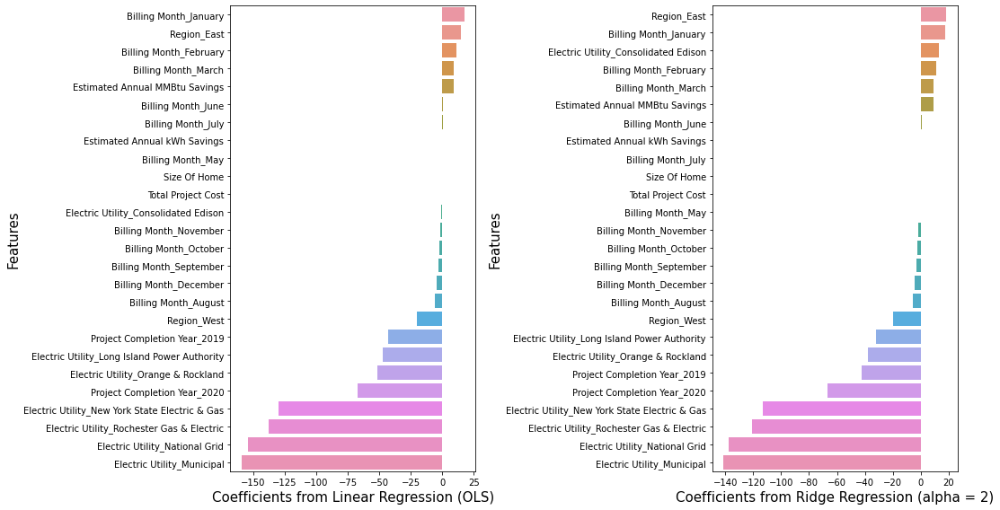

In [116]:
# subplot() is used to plot the multiple plots as a subplot
plt.subplot(1,2,1)
plot_coefficients(modelMT_oh, X_trainMT_oh,'Linear Regression (OLS)')

# pass the index of the plot as the third parameter of subplot()
plt.subplot(1,2,2)
plot_coefficients(modelMT_oh_rig2, X_trainMT_oh,'Ridge Regression (alpha = 2)')

# to adjust the subplots
plt.tight_layout()

# display the plot
plt.show()

In [117]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Ridge Regression (alpha = 2)', alpha = '2', model = modelMT_oh_rig2,
                  X_train = X_trainMT_oh, y_train = y_trainMT,
                  X_test = X_testMT_oh, y_test = y_testMT)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186


#### Ridge GridSearchCV

In [118]:
# create a dictionary with hyperparameters and its values
tuned_paramaters = [{'alpha':[1e-15, 1e-10, 1e-8, 1e-4,1e-3, 1e-2, 0.1, 1, 5, 10, 20, 40, 60, 80, 100]}]
 
# initiate the ridge regression model
ridge = Ridge()

# use GridSearchCV() to find the optimal value of alpha
modelMT_oh_rigCV = GridSearchCV(estimator = ridge, 
                          param_grid = tuned_paramaters, 
                          cv = 10)

# fit the model on X_train and y_train using fit()
modelMT_oh_rigCV.fit(X_trainMT_oh, y_trainMT)

# get the best parameters
print('Best parameters for Ridge Regression: ', modelMT_oh_rigCV.best_params_, '\n')

# print the RMSE for test set using the model having optimal value of alpha
print('MSE on test set:', get_test_mse(modelMT_oh_rigCV,X_testMT_oh,y_testMT))

Best parameters for Ridge Regression:  {'alpha': 0.1} 

MSE on test set: 7640.436081340234


In [119]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Ridge Regression (GridSearchCV)',
                  alpha = modelMT_oh_rigCV.best_params_.get('alpha'),
                  model = modelMT_oh_rigCV,
                  X_train = X_trainMT_oh, y_train = y_trainMT,
                  X_test = X_testMT_oh, y_test = y_testMT)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081


### Lasso Regularization

In [120]:
# use Lasso() to perform lasso regression
modelMT_oh_las = Lasso(alpha = 0.01, max_iter = 500)

# fit the model on train set
modelMT_oh_las.fit(X_trainMT_oh, y_trainMT)

# print RMSE for test set
print('MSE on test set:', get_test_mse(modelMT_oh_las,X_testMT_oh,y_testMT))

MSE on test set: 7637.819790859962


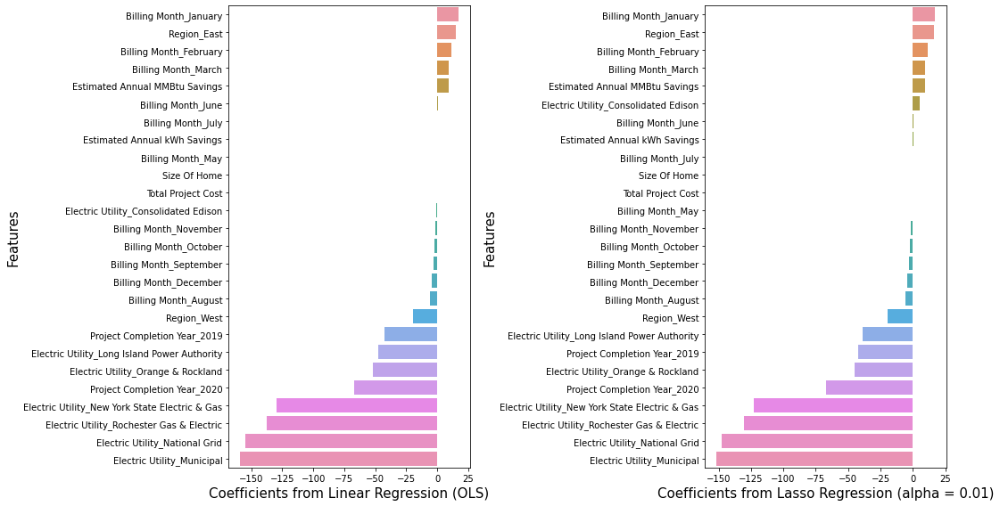

In [121]:
# subplot() is used to plot the multiple plots as a subplot
plt.subplot(1,2,1)
plot_coefficients(modelMT_oh, X_trainMT_oh, 'Linear Regression (OLS)')

# pass the index of the plot as the third parameter of subplot()
plt.subplot(1,2,2)
plot_coefficients(modelMT_oh_las, X_trainMT_oh, 'Lasso Regression (alpha = 0.01)')

# to adjust the subplots
plt.tight_layout()

# display the plot
plt.show()

In [122]:
# create a dataframe to store the variable names and their corresponding coefficient values.
df_lasso_coeff = pd.DataFrame({'Variable': X_trainMT_oh.columns, 'Coefficient': modelMT_oh_las.coef_})

# print the variables having the coefficient value equal to zero
print('Insignificant variables obtained from Lasso Regression when alpha is 0.01')
df_lasso_coeff.Variable[df_lasso_coeff.Coefficient == 0].to_list()

Insignificant variables obtained from Lasso Regression when alpha is 0.01


['Billing Month_May']

In [123]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Lasso Regression',alpha = '0.01', model = modelMT_oh_las,
                  X_train = X_trainMT_oh, y_train = y_trainMT,
                  X_test = X_testMT_oh, y_test = y_testMT)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791


#### Lasso GridSearchCV

In [124]:
# create a dictionary with hyperparameters and its values
tuned_paramaters = [{'alpha':[1e-15,1e-10,1e-8,0.0001,0.001,0.01,0.1,1,2,4,5,7,10,20]}]
                     
# 'max_iter':100,500,1000,1500,2000
 
# initiate the lasso regression model 
lasso = Lasso()

# use GridSearchCV() to find the optimal value of alpha
modelMT_oh_lasCV = GridSearchCV(estimator = lasso, 
                          param_grid = tuned_paramaters, 
                          cv = 10)

# fit the model on X_train and y_train using fit()
modelMT_oh_lasCV.fit(X_trainMT_oh, y_trainMT)

# get the best parameters
print('Best parameters for Lasso Regression: ', modelMT_oh_lasCV.best_params_, '\n')

# print the RMSE for the test set using the model having optimal value of alpha
print('MSE on test set:', get_test_mse(modelMT_oh_lasCV,X_testMT_oh,y_testMT))

Best parameters for Lasso Regression:  {'alpha': 0.01} 

MSE on test set: 7637.819790859962


In [125]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Lasso Regression (GridSearchCV)',
                  alpha = modelMT_oh_rigCV.best_params_.get('alpha'),
                  model = modelMT_oh_lasCV,
                  X_train = X_trainMT_oh, y_train = y_trainMT,
                  X_test = X_testMT_oh, y_test = y_testMT)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791


### Elastic Net Regularisation

In [126]:
# use ElasticNet() to perform Elastic Net regression
modelMT_oh_enet = ElasticNet(alpha = 0.1, l1_ratio = 0.01, max_iter = 500)

# fit the model on train data
modelMT_oh_enet.fit(X_trainMT_oh, y_trainMT)


# print RMSE for test set
print('MSE on test set:', get_test_mse(modelMT_oh_enet,X_testMT_oh,y_testMT))

MSE on test set: 8095.864889323355


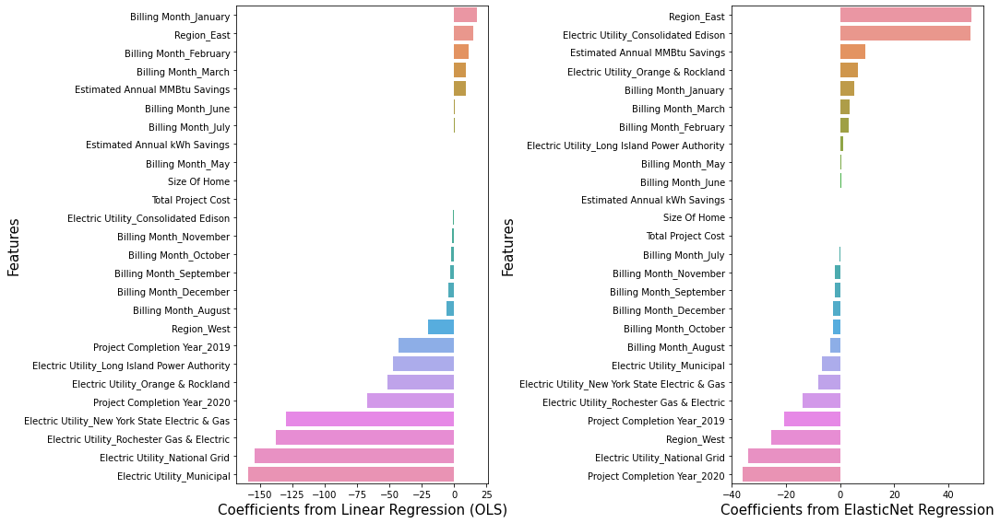

In [127]:
# subplot() is used to plot the multiple plots as a subplot
plt.subplot(1,2,1)
plot_coefficients(modelMT_oh, X_trainMT_oh, 'Linear Regression (OLS)')

# pass the index of the plot as the third parameter of subplot()
plt.subplot(1,2,2)
plot_coefficients(modelMT_oh_enet, X_trainMT_oh, 'ElasticNet Regression')

# to adjust the subplots
plt.tight_layout()

# display the plot
plt.show()

In [128]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'ElasticNet Regression',alpha = '0.1', l1_ratio = '0.01', model = modelMT_oh_enet,
                  X_train = X_trainMT_oh, y_train = y_trainMT,
                  X_test = X_testMT_oh, y_test = y_testMT)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889


#### Elastic Net GridSearchCV

In [129]:
# create a dictionary with hyperparameters and its values
tuned_paramaters = [{'alpha':[0.0001, 0.001, 0.01, 0.1, 1, 5, 10, 20, 40, 60],
                      'l1_ratio':[0.0001, 0.0002, 0.001, 0.01, 0.1, 0.2]}]

# initiate the elastic net regression model  
enet = ElasticNet()

# use GridSearchCV() to find the optimal value of alpha and l1_ratio
modelMT_oh_enetCV = GridSearchCV(estimator = enet, 
                          param_grid = tuned_paramaters, 
                          cv = 10)

# fit the model on X_train and y_train using fit()
modelMT_oh_enetCV.fit(X_trainMT_oh, y_trainMT)

# get the best parameters
print('Best parameters for ElasticNet Regression: ', modelMT_oh_enetCV.best_params_, '\n')

# print the RMSE for the test set using the model having optimal value of alpha and l1-ratio
print('MSE on test set:', get_test_mse(modelMT_oh_enetCV,X_testMT_oh,y_testMT))

Best parameters for ElasticNet Regression:  {'alpha': 0.0001, 'l1_ratio': 0.2} 

MSE on test set: 7637.557368343069


In [130]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'ElasticNet Regression (GridSearchCV)',
                  alpha = modelMT_oh_enetCV.best_params_.get('alpha'),
                  l1_ratio = modelMT_oh_enetCV.best_params_.get('l1_ratio'),
                  model = modelMT_oh_enetCV,
                  X_train = X_trainMT_oh, y_train = y_trainMT,
                  X_test = X_testMT_oh, y_test = y_testMT)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368


### Decision Tree Regression

In [131]:
modelMT_oh_dt = DecisionTreeRegressor(random_state=10) 
modelMT_oh_dt.fit(X_trainMT_oh,y_trainMT)

y_tr_pred = modelMT_oh_dt.predict(X_trainMT_oh)
tr_mse = mean_squared_error(y_trainMT,y_tr_pred)
y_te_pred = modelMT_oh_dt.predict(X_testMT_oh)
te_mse = mean_squared_error(y_testMT,y_te_pred)

print('train mse decision tree regressor:',np.sqrt(tr_mse))
print('test mse decision tree regressor:',te_mse)

train mse decision tree regressor: 0.05663899293489516
test mse decision tree regressor: 12557.990329265485


#### Decision Tree GridSearchCV

In [132]:
# Setup the parameters 
param_dist = {"max_depth": [3,4,5,6,7,8,9,10,11,15,19,20,22,24,26],
              "max_features": [2,3,5,6,9,10,12,14,17,19,21,23,25],
              "min_samples_split": [5,10,20,40,80,100,120,140],
              "min_samples_leaf": [10,20,40,50,60,70,80,90],
              'random_state': [10]}


tree = DecisionTreeRegressor()

# Instantiate the GridSearchCV object: tree_cv
tree_cv = GridSearchCV(tree,param_dist,scoring='r2',cv=5,n_jobs=-1)
tree_cv.fit(X_trainMT_oh,y_trainMT)


print("Tuned Decision Tree Parameters: {}".format(tree_cv.best_params_))
print("Best score is {}".format(tree_cv.best_score_))

Tuned Decision Tree Parameters: {'max_depth': 15, 'max_features': 23, 'min_samples_leaf': 10, 'min_samples_split': 5, 'random_state': 10}
Best score is 0.8714225372304014


In [133]:
modelMT_oh_dtCV = DecisionTreeRegressor(**tree_cv.best_params_) # fitting with optimal parameter values
modelMT_oh_dtCV.fit(X_trainMT_oh,y_trainMT)

y_tr_pred = modelMT_oh_dtCV.predict(X_trainMT_oh)
tr_mse = mean_squared_error(y_trainMT,y_tr_pred)
y_te_pred = modelMT_oh_dtCV.predict(X_testMT_oh)
te_mse = mean_squared_error(y_testMT,y_te_pred)

print('train mse decision tree regressor with best parameters:',tr_mse)
print('test mse decision tree regressor with best parameters:',te_mse)

train mse decision tree regressor with best parameters: 4610.0633098179505
test mse decision tree regressor with best parameters: 7201.719311639925


In [134]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Decision Tree Regression (GridSearchCV)', model = modelMT_oh_dtCV,
                  X_train = X_trainMT_oh, y_train = y_trainMT,
                  X_test = X_testMT_oh, y_test = y_testMT)
# print the dataframe 12
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312


## Without Outliers

### Linear Regression Base Model (w/o Outliers)

In [135]:
# define model
lr = LinearRegression()
# build the model using X_train and y_train
modelMT_oh1 = lr.fit(X_trainMT_oh1,y_trainMT1)
print('R-Squared:',modelMT_oh1.score(X_trainMT_oh1,y_trainMT1))

R-Squared: 0.9212258156147473


In [136]:
# print training RMSE
print('MSE on train set: ', get_train_mse(modelMT_oh1,X_trainMT_oh1,y_trainMT1))
# print training RMSE
print('MSE on test set: ', get_test_mse(modelMT_oh1,X_testMT_oh1,y_testMT1))
# calculate the difference between train and test set MSE
difference = abs(get_test_mse(modelMT_oh1,X_testMT_oh1,y_testMT1) - get_train_mse(modelMT_oh1,X_trainMT_oh1,y_trainMT1))
# print the difference between train and test set MSE
print('Difference between MSE on train and test set: ', difference)

MSE on train set:  3054.717727168954
MSE on test set:  3406.0246094095924
Difference between MSE on train and test set:  351.3068822406385


In [137]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Linear Regression (w/o Outliers)',
                  model = modelMT_oh1,
                  X_train = X_trainMT_oh1, y_train = y_trainMT1,
                  X_test = X_testMT_oh1, y_test = y_testMT1)

# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312
9,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609


### Ridge Regularization (w/o Outliers)

#### alpha = 1 (w/o Outliers)

In [138]:
# use Ridge() to perform ridge regression
modelMT_oh_rig11 = Ridge(alpha = 1, max_iter = 500)

# fit the model on train set
modelMT_oh_rig11.fit(X_trainMT_oh1, y_trainMT1)

# print RMSE for test set
print('MSE on test set:', get_test_mse(modelMT_oh_rig11,X_testMT_oh1,y_testMT1))

MSE on test set: 3403.3550724220745


In [139]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Ridge Regression (alpha = 1 w/o Outliers)',
                  alpha = '1',
                  model = modelMT_oh_rig11,
                  X_train = X_trainMT_oh1, y_train = y_trainMT1,
                  X_test = X_testMT_oh1, y_test = y_testMT1)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312
9,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609


#### alpha = 2 (w/o Outliers)

In [140]:
# use Ridge() to perform ridge regression
modelMT_oh_rig21 = Ridge(alpha = 2, max_iter = 500)

# fit the model on train set
modelMT_oh_rig21.fit(X_trainMT_oh1, y_trainMT1)


# print RMSE for test set
print('MSE on test set:', get_test_mse(modelMT_oh_rig21,X_testMT_oh1,y_testMT1))

MSE on test set: 3402.0583940361466


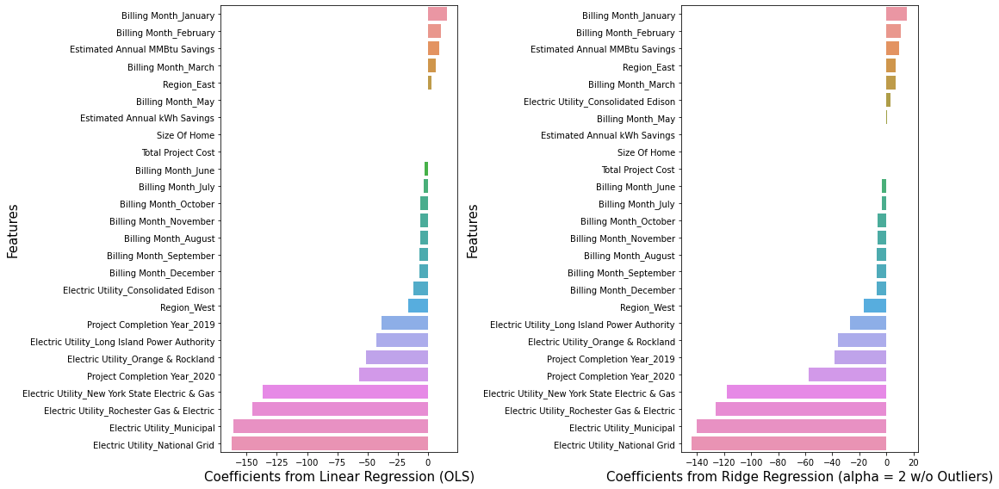

In [141]:
# subplot() is used to plot the multiple plots as a subplot
plt.subplot(1,2,1)
plot_coefficients(modelMT_oh1, X_trainMT_oh1,'Linear Regression (OLS)')

# pass the index of the plot as the third parameter of subplot()
plt.subplot(1,2,2)
plot_coefficients(modelMT_oh_rig21, X_trainMT_oh1,'Ridge Regression (alpha = 2 w/o Outliers)')

# to adjust the subplots
plt.tight_layout()

# display the plot
plt.show()

In [142]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Ridge Regression (alpha = 2 w/o Outliers)',
                  alpha = '2',
                  model = modelMT_oh_rig21,
                  X_train = X_trainMT_oh1, y_train = y_trainMT1,
                  X_test = X_testMT_oh1, y_test = y_testMT1)

# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312
9,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609


#### Ridge GridSearchCV (w/o Outliers)

In [143]:
# create a dictionary with hyperparameters and its values
tuned_paramaters = [{'alpha':[1e-15, 1e-10, 1e-8, 1e-4,1e-3, 1e-2, 0.1, 1, 5, 10, 20, 40, 60, 80, 100]}]
 
# initiate the ridge regression model
ridge = Ridge()

# use GridSearchCV() to find the optimal value of alpha
modelMT_oh_rigCV1 = GridSearchCV(estimator = ridge, 
                          param_grid = tuned_paramaters, 
                          cv = 10)

# fit the model on X_train and y_train using fit()
modelMT_oh_rigCV1.fit(X_trainMT_oh1, y_trainMT1)

# get the best parameters
print('Best parameters for Ridge Regression: ', modelMT_oh_rigCV1.best_params_, '\n')

# print the RMSE for test set using the model having optimal value of alpha
print('MSE on test set:', get_test_mse(modelMT_oh_rigCV1,X_testMT_oh1,y_testMT1))

Best parameters for Ridge Regression:  {'alpha': 0.1} 

MSE on test set: 3405.674397351239


In [144]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Ridge Regression (GridSearchCV w/o Outliers)',
                  alpha = modelMT_oh_rigCV1.best_params_.get('alpha'),
                  model = modelMT_oh_rigCV1,
                  X_train = X_trainMT_oh1, y_train = y_trainMT1,
                  X_test = X_testMT_oh1, y_test = y_testMT1)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312
9,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609


### Lasso Regularization (w/o Outliers)

In [145]:
# use Lasso() to perform lasso regression
modelMT_oh_las1 = Lasso(alpha = 0.01, max_iter = 500)

# fit the model on train set
modelMT_oh_las1.fit(X_trainMT_oh1, y_trainMT1)

# print RMSE for test set
print('MSE on test set:', get_test_mse(modelMT_oh_las1,X_testMT_oh1,y_testMT1))

MSE on test set: 3404.595658741522


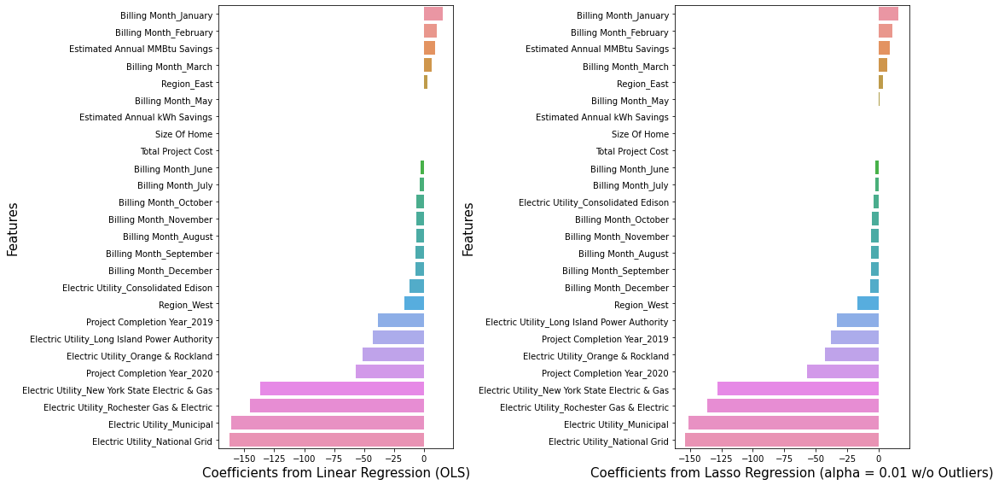

In [146]:
# subplot() is used to plot the multiple plots as a subplot
plt.subplot(1,2,1)
plot_coefficients(modelMT_oh1, X_trainMT_oh1, 'Linear Regression (OLS)')

# pass the index of the plot as the third parameter of subplot()
plt.subplot(1,2,2)
plot_coefficients(modelMT_oh_las1, X_trainMT_oh1, 'Lasso Regression (alpha = 0.01 w/o Outliers)')

# to adjust the subplots
plt.tight_layout()

# display the plot
plt.show()

In [147]:
# create a dataframe to store the variable names and their corresponding coefficient values.
df_lasso_coeff1 = pd.DataFrame({'Variable': X_trainMT_oh1.columns, 'Coefficient': modelMT_oh_las1.coef_})

# print the variables having the coefficient value equal to zero
print('Insignificant variables obtained from Lasso Regression when alpha is 0.01 and whitout Outliers')
df_lasso_coeff1.Variable[df_lasso_coeff1.Coefficient == 0].to_list()

Insignificant variables obtained from Lasso Regression when alpha is 0.01 and whitout Outliers


[]

In [148]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Lasso Regression (w/o Outliers)',
                  alpha = '0.01',
                  model = modelMT_oh_las1,
                  X_train = X_trainMT_oh1, y_train = y_trainMT1,
                  X_test = X_testMT_oh1, y_test = y_testMT1)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312
9,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609


#### Lasso GridSearchCV (w/o Outliers)

In [149]:
# create a dictionary with hyperparameters and its values
tuned_paramaters = [{'alpha':[1e-15,1e-10,1e-8,0.0001,0.001,0.01,0.1,1,2,4,5,7,10,20]}]
                     
# 'max_iter':100,500,1000,1500,2000
 
# initiate the lasso regression model 
lasso = Lasso()

# use GridSearchCV() to find the optimal value of alpha
modelMT_oh_lasCV1 = GridSearchCV(estimator = lasso, 
                          param_grid = tuned_paramaters, 
                          cv = 10)

# fit the model on X_train and y_train using fit()
modelMT_oh_lasCV1.fit(X_trainMT_oh1, y_trainMT1)

# get the best parameters
print('Best parameters for Lasso Regression: ', modelMT_oh_lasCV1.best_params_, '\n')

# print the RMSE for the test set using the model having optimal value of alpha
print('MSE on test set:', get_test_mse(modelMT_oh_lasCV1,X_testMT_oh1,y_testMT1))

Best parameters for Lasso Regression:  {'alpha': 0.001} 

MSE on test set: 3405.8321169209357


In [150]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Lasso Regression (GridSearchCV w/o Outliers)',
                  alpha = modelMT_oh_rigCV1.best_params_.get('alpha'),
                  model = modelMT_oh_lasCV1,
                  X_train = X_trainMT_oh1, y_train = y_trainMT1,
                  X_test = X_testMT_oh1, y_test = y_testMT1)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312
9,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609


### Elastic Net Regularisation (w/o Outliers)

In [151]:
# use ElasticNet() to perform Elastic Net regression
modelMT_oh_enet1 = ElasticNet(alpha = 0.1, l1_ratio = 0.01, max_iter = 500)

# fit the model on train data
modelMT_oh_enet1.fit(X_trainMT_oh1, y_trainMT1)


# print RMSE for test set
print('MSE on test set:', get_test_mse(modelMT_oh_enet1,X_testMT_oh1,y_testMT1))

MSE on test set: 3759.539320329954


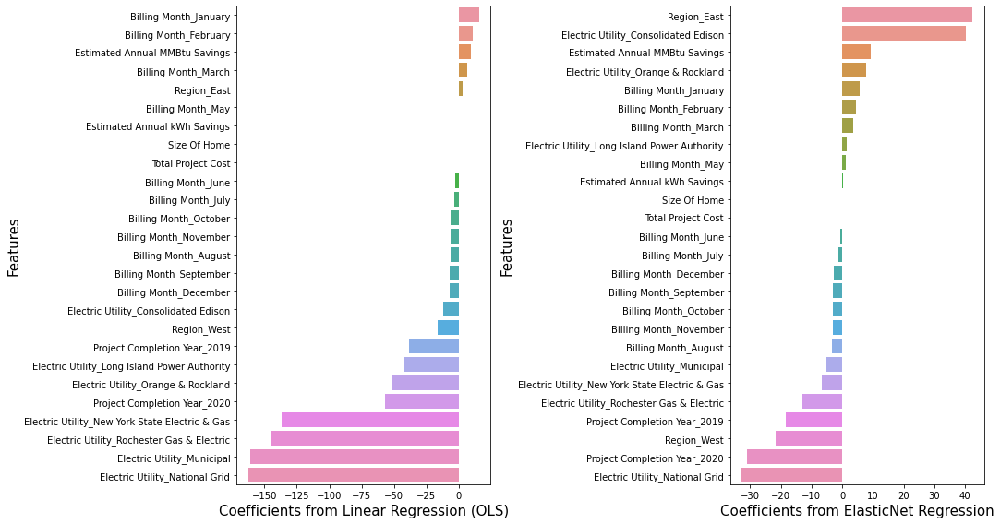

In [152]:
# subplot() is used to plot the multiple plots as a subplot
plt.subplot(1,2,1)
plot_coefficients(modelMT_oh1, X_trainMT_oh1, 'Linear Regression (OLS)')

# pass the index of the plot as the third parameter of subplot()
plt.subplot(1,2,2)
plot_coefficients(modelMT_oh_enet1, X_trainMT_oh1, 'ElasticNet Regression')

# to adjust the subplots
plt.tight_layout()

# display the plot
plt.show()

In [153]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'ElasticNet Regression (w/o Outliers)',
                  alpha = '0.1',
                  l1_ratio = '0.01',
                  model = modelMT_oh_enet1,
                  X_train = X_trainMT_oh1, y_train = y_trainMT1,
                  X_test = X_testMT_oh1, y_test = y_testMT1)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312
9,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609


#### Elastic Net GridSearchCV (w/o Outliers)

In [154]:
# create a dictionary with hyperparameters and its values
tuned_paramaters = [{'alpha':[0.0001, 0.001, 0.01, 0.1, 1, 5, 10, 20, 40, 60],
                      'l1_ratio':[0.0001, 0.0002, 0.001, 0.01, 0.1, 0.2]}]

# initiate the elastic net regression model  
enet = ElasticNet()

# use GridSearchCV() to find the optimal value of alpha and l1_ratio
# estimator: pass the elastic net regression model
# param_grid: pass the list 'tuned_parameters'
# cv: number of folds in k-fold i.e. here cv = 10
modelMT_oh_enetCV1 = GridSearchCV(estimator = enet, 
                          param_grid = tuned_paramaters, 
                          cv = 10)

# fit the model on X_train and y_train using fit()
modelMT_oh_enetCV1.fit(X_trainMT_oh1, y_trainMT1)

# get the best parameters
print('Best parameters for ElasticNet Regression: ', modelMT_oh_enetCV1.best_params_, '\n')

# print the RMSE for the test set using the model having optimal value of alpha and l1-ratio
print('MSE on test set:', get_test_mse(modelMT_oh_enetCV1,X_testMT_oh1,y_testMT1))

Best parameters for ElasticNet Regression:  {'alpha': 0.0001, 'l1_ratio': 0.2} 

MSE on test set: 3403.9419046105368


In [155]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'ElasticNet Regression (GridSearchCV w/o Outliers)',
                  alpha = modelMT_oh_enetCV1.best_params_.get('alpha'),
                  l1_ratio = modelMT_oh_enetCV1.best_params_.get('l1_ratio'),
                  model = modelMT_oh_enetCV1,
                  X_train = X_trainMT_oh1, y_train = y_trainMT1,
                  X_test = X_testMT_oh1, y_test = y_testMT1)
# print the dataframe
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312
9,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609


### Decision Tree Regression (w/o Outliers)

In [156]:
modelMT_oh_dt1 = DecisionTreeRegressor(random_state=10) 
modelMT_oh_dt1.fit(X_trainMT_oh1,y_trainMT1)

y_tr_pred1 = modelMT_oh_dt1.predict(X_trainMT_oh1)
tr_mse1 = mean_squared_error(y_trainMT1,y_tr_pred1)
y_te_pred1 = modelMT_oh_dt1.predict(X_testMT_oh1)
te_mse1 = mean_squared_error(y_testMT1,y_te_pred1)

print('train mse decision tree regressor:',tr_mse1)
print('test mse decision tree regressor:',te_mse1)

train mse decision tree regressor: 0.0027380420205632542
test mse decision tree regressor: 5012.22314911366


#### Decision Tree GridSearchCV (w/o Outliers)

In [157]:
# Setup the parameters 
param_dist = {"max_depth": [3,4,5,6,7,8,9,10,11,15,19,20,22,24,26],
              "max_features": [2,3,5,6,9,10,12,14,17,19,21,23,25],
              "min_samples_split": [5,10,20,40,80,100,120,140],
              "min_samples_leaf": [10,20,40,50,60,70,80,90],
              "random_state": [10]}


tree = DecisionTreeRegressor()

# Instantiate the GridSearchCV object: tree_cv
tree_cv = GridSearchCV(tree,param_dist,scoring='r2',cv=5,n_jobs=-1)
tree_cv.fit(X_trainMT_oh1,y_trainMT1)


print("Tuned Decision Tree Parameters: {}".format(tree_cv.best_params_))
print("Best score is {}".format(tree_cv.best_score_))

Tuned Decision Tree Parameters: {'max_depth': 11, 'max_features': 21, 'min_samples_leaf': 10, 'min_samples_split': 5, 'random_state': 10}
Best score is 0.9233500401674103


In [158]:
modelMT_oh_dtCV1 = DecisionTreeRegressor(**tree_cv.best_params_) # fitting with optimal parameter values
modelMT_oh_dtCV1.fit(X_trainMT_oh1,y_trainMT1)

y_tr_pred1 = modelMT_oh_dtCV1.predict(X_trainMT_oh1)
tr_mse1 = mean_squared_error(y_trainMT1,y_tr_pred1)
y_te_pred1 = modelMT_oh_dtCV1.predict(X_testMT_oh1)
te_mse1 = mean_squared_error(y_testMT1,y_te_pred1)

print('train mse decision tree regressor with best parameters:',tr_mse1)
print('test mse decision tree regressor with best parameters:',te_mse1)

train mse decision tree regressor with best parameters: 2180.7366681041794
test mse decision tree regressor with best parameters: 3437.121467311989


In [159]:
# update the dataframe 'score_card'
update_score_card(algorithm_name = 'Decision Tree Regression (GridSearchCV w/o Outliers)',
                  model = modelMT_oh_dtCV1,
                  X_train = X_trainMT_oh1, y_train = y_trainMT1,
                  X_test = X_testMT_oh1, y_test = y_testMT1)
# print the dataframe 12
score_card

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Linear Regression,-,-,0.877626,0.877311,6337.019066,7640.922190
1,Ridge Regression (alpha = 1),1,-,0.877615,0.877300,6337.576732,7636.944111
2,Ridge Regression (alpha = 2),2,-,0.877590,0.877275,6338.913356,7634.481186
3,Ridge Regression (GridSearchCV),0.1,-,0.877626,0.877311,6337.025613,7640.436081
4,Lasso Regression,0.01,-,0.877619,0.877304,6337.394995,7637.819791
5,Lasso Regression (GridSearchCV),0.1,-,0.877619,0.877304,6337.394995,7637.819791
6,ElasticNet Regression,0.1,0.01,0.868150,0.867810,6827.753459,8095.864889
7,ElasticNet Regression (GridSearchCV),0.0001,0.2,0.877619,0.877304,6337.398888,7637.557368
8,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312
9,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609


### RandomForest Regression 

In [160]:
modelMT_oh_rf = RandomForestRegressor(random_state=10) 
modelMT_oh_rf.fit(X_trainMT_oh,y_trainMT)

y_tr_pred_rf = modelMT_oh_rf.predict(X_trainMT_oh)
tr_mse_rf = mean_squared_error(y_trainMT,y_tr_pred_rf)
y_te_pred_rf = modelMT_oh_rf.predict(X_testMT_oh)
te_mse_rf = mean_squared_error(y_testMT,y_te_pred_rf)

print('train mse decision tree regressor:',tr_mse_rf)
print('test mse decision tree regressor:',te_mse_rf)

train mse decision tree regressor: 773.2798506772339
test mse decision tree regressor: 6536.7407532710495


#### RandomForest GridSearchCV

In [161]:
## Setup the parameters 
#param_dist = {"max_depth": [3,4,5,6,7,8,9,10,11,15,19,20,22,24,26],
#              "max_features": [2,3,5,6,9,10,12,14,17,19,21,23,25],
#              "min_samples_split": [5,10,20,40,80,100,120,140],
#               "min_samples_leaf": [10,20,40,50,60,70,80,90],
#              "random_state": [10]}


#rtree = RandomForestRegressor(random_state=10)

## Instantiate the GridSearchCV object: tree_cv
#rtree_cv = GridSearchCV(rtree,param_dist,scoring='r2',cv=5,n_jobs=-1)
#rtree_cv.fit(X_trainMT_oh,y_trainMT)


#print("Tuned Decision Tree Parameters: {}".format(rtree_cv.best_params_))
#print("Best score is {}".format(rtree_cv.best_score_))

In [162]:
#modelMT_oh_rfCV = DecisionTreeRegressor(**rtree_cv.best_params_) # fitting with optimal parameter values
#modelMT_oh_rfCV.fit(X_trainMT_oh,y_trainMT)

#y_tr_pred_rfCV = modelMT_oh_rfCV.predict(X_trainMT_oh)
#tr_mse_rfCV = mean_squared_error(y_trainMT,y_tr_pred)
#y_te_pred_rfCV = modelMT_oh_rfCV.predict(X_testMT_oh)
#te_mse_rfCV = mean_squared_error(y_testMT,y_te_pred)

#print('train mse decision tree regressor with best parameters:',tr_mse_rfCV)
#print('test mse decision tree regressor with best parameters:',te_mse_rfCV)

In [163]:
## update the dataframe 'score_card'
#update_score_card(algorithm_name = 'RandomForestRegressor (GridSearchCV)',
#                  model = modelMT_oh_rfCV,
#                  X_train = X_trainMT_oh, y_train = y_trainMT,
#                  X_test = X_testMT_oh, y_test = y_testMT)
# print the dataframe 12
#score_card

In [164]:
#ind=np.argsort(modelMT_oh_dtCV.feature_importances_)
## print(ind)
#desc = np.sort(modelMT_oh_dtCV.feature_importances_)[::-1]
## print(desc)
#print('feature importances----------------------->')
#for ii,i in enumerate(ind):
#    print(X_trainMT_oh.columns[i],end='  :')
#    print(desc[ii],end='\n')

In [165]:
def impplot(X_train,model):
    
    # 'feature_importances_' returns the features based on the average gain 
    important_features = pd.DataFrame({'Features': X_train.columns,
                                       'Importance': model.feature_importances_})
    
    # sort the dataframe in the descending order according to the feature importance
    important_features = important_features.sort_values('Importance', ascending = False)
    important_features = important_features[important_features['Importance']>0.0]
    
    # create a barplot to visualize the features based on their importance
    sns.barplot(x = 'Importance', y = 'Features', data = important_features)
    
    # add plot and axes labels
    plt.title('Feature Importance', fontsize = 15)
    plt.xlabel('Importance', fontsize = 15)
    plt.ylabel('Features', fontsize = 15)
    
    # display the plot
    plt.show()

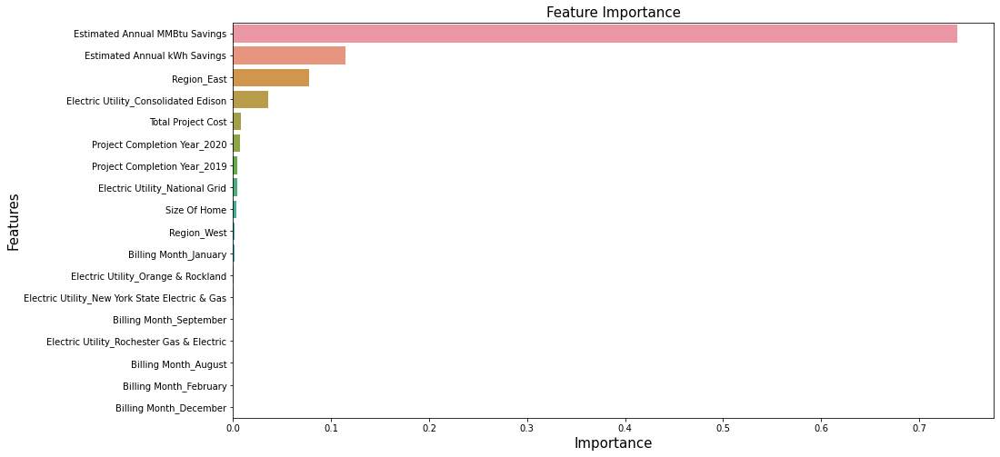

In [166]:
impplot(X_trainMT_oh,modelMT_oh_dtCV)

| Algorithm | Encoding | Test RMSE |
| --- | --- | --- |
| Base Model | (Irrespective) | 92908 |
| KNN Regressor (on original data) | One hot Encoding | 146.3 |
| KNN Regressor (on original data) | Frequency Encoding | 155.2 |
| Decision Tree Regressor (on original data) | One hot Encoding | 139.8 |
| Decision Tree Regressor (on original data) | Frequency Encoding | 133.7 |
| Decision Tree Regressor (with outliers) | One hot encoding | 84.8|
| Random Forest Regressor (with outliers) | One hot encoding | 84.9 |
| Ridge Regressor (with outliers) | One hot encoding | 87.3 |
| Lasso Regressor and elastic net Regressor (with outliers) | One hot encoding | 87.4 |
| Ridge Regression(w/o outliers) | One hot encoding | 58.3 |
| ElasticNet Regression (w/o outliers) | One hot encoding | 58.4 |
| Lasso Regression (w/o outliers) | One hot encoding | 58.4 |
| Linear Regression (w/o outliers) | One hot encoding | 58.3 |
| Decision Tree Regression (w/o outliers) | One hot encoding | 58.6 |
| Decision Tree Regression (w/o outliers) | frequency encoding | 56.3 |
| KNN Regressor (w/o outliers) | One hot encoding | 63.6 |
| KNN Regressor (w/o outliers) | frequency encoding | 73.6 |

In the view of possible bias and sampling precision which are the two critical factors affecting the underlying reliability of evaluation results, the procedure that was taken in the above analysis to address these is : sampling precision can be ruled out in this case study as the datset has the total population (participants with sufficient billing history) included for analysis and no samples were taken. In the view of bias, this will be very possible because participants without sufficient consumption history were excluded in the analysis . Also, the 'external influences' like weather, home occupancy patterns can create change in energy usage and affect the results of billing analysis. Since we are going with fixed effects regression model, external influences are not included in the feature set and so bias is very much possible.

In the view of the bias thats possible in the dataset, we have developed three datasets i.e. 1) original data 2) with a few extreme outliers removed 3) with all possible outliers removed we have done modelling on all these three datasets to understand the performance which in turn helps in understanding realisation rates . Also, we have developed two feature sets one with one hot encoded categorical variables and another with frequency encoded categorical variables as tree-based models perform better with freqeuncy encoded features.

The above table shows the results with all three datasets and different encoding techniques.

1. It is clear that Decision Tree Regressor on dataset with all outliers removed and frequency encoded performed better with 56.3 RMSE value.

2. Also,the rmse values of the three datasets overall are in the order without outliers > with partial outliers > original data in the order of performance.

3. therefore, it is understandable since all simple to complex models on original data(with whole population,bias(attrition)) havent performed better than that on other two datasets. indicating the modelling software shows a lower realisation rate in reality with whole population involved due to possible bias (-> attrition and external influences) in original data.

4. from the modelling analysis, it is also clear that 'type_of_dwelling(mobile)','pre-retrofit fuel type(natural gas)','kerosene' etc emerged important features which hasnt changed much over the years from 2007-08 to 2018 and very much inline with 2007-08 impact analysis though the realisation rates have improved.

Overall, when the bias in the dataset can be addressed to some extent(by removing outliers etc), then the results the modelling will give on any real-world input for the 'estimated 1st year annual savings' will be a better estimate with better realisation rate in realtime.

#### Sorting Score Card

In [167]:
## sort the dataframe 'score_card' on 'Test_RMSE' in an ascending order using 'sort_values' 
score_card = score_card.sort_values('Test_MSE').reset_index(drop = True)

## color the cell in the column 'Test_RMSE' having minimum RMSE value
score_card.style.highlight_min(color = 'lightblue', subset = 'Test_MSE')

,Model_Name,Alpha (Wherever Required),l1-ratio,R-Squared,Adj. R-Squared,Train_MSE,Test_MSE
0,Ridge Regression (alpha = 2 w/o Outliers),2,-,0.921161,0.920932,3057.212791,3402.058394
1,Ridge Regression (alpha = 1 w/o Outliers),1,-,0.921207,0.920977,3055.460206,3403.355072
2,ElasticNet Regression (GridSearchCV w/o Outliers),0.000100,0.200000,0.921215,0.920986,3055.120552,3403.941905
3,Lasso Regression (w/o Outliers),0.01,-,0.921209,0.920980,3055.361814,3404.595659
4,Ridge Regression (GridSearchCV w/o Outliers),0.100000,-,0.921226,0.920996,3054.726546,3405.674397
5,Lasso Regression (GridSearchCV w/o Outliers),0.100000,-,0.921226,0.920996,3054.724168,3405.832117
6,Linear Regression (w/o Outliers),-,-,0.921226,0.920996,3054.717727,3406.024609
7,Decision Tree Regression (GridSearchCV w/o Outliers),-,-,0.943764,0.943600,2180.736668,3437.121467
8,ElasticNet Regression (w/o Outliers),0.1,0.01,0.909729,0.909466,3500.552609,3759.539320
9,Decision Tree Regression (GridSearchCV),-,-,0.910975,0.910746,4610.063310,7201.719312


## Pandas Profiling

In [168]:
profile = ProfileReport(dfMT, title='Pandas Profiling Report', explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/28 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Plots

**Note:-**
- Using 'dfMT' for plotting exploration

#### Defining Functions for Plots

In [169]:
## defining function to plot against important features vs the target feature

def targetbar(x1,x2,x3,x4,x5,dat):
    f, ax = plt.subplots(3, 2,figsize=(20,25))
    
    ax[0][0].bar(x=x1,height=x2,data=dat)
    ax[0][0].set_title(label = x2+' '+'by'+' '+x1)
    ax[0][0].set_xlabel(x1)
    ax[0][0].set_ylabel(x2)
    ax[0][0].tick_params(axis='x',labelrotation=45)
    ax[0][0].grid()
    
    sns.countplot(x=x1,data=dat,ax=ax[0][1])
    ax[0][1].set_title('Count of'+' '+x1)
    ax[0][1].tick_params(axis='x',labelrotation=45)
    ax[0][1].grid()
    
    ax[1][0].bar(x=x1,height=x3,data=dat)
    ax[1][0].set_title(x3+' '+'by'+' '+x1)
    ax[1][0].set_xlabel(x1)
    ax[1][0].set_ylabel(x3)
    ax[1][0].tick_params(axis='x',labelrotation=45)
    ax[1][0].grid()
    
    ax[1][1].bar(x=x1,height=x4,data=dat)
    ax[1][1].set_title(x4+' '+'by'+' '+x1)
    ax[1][1].set_xlabel(x1)
    ax[1][1].set_ylabel(x4)
    ax[1][1].tick_params(axis='x',labelrotation=45)
    ax[1][1].grid()
    
    ax[2][0].bar(x=x1,height=x5,data=dat)
    ax[2][0].set_title(x5+' '+'by'+' '+x1)
    ax[2][0].set_xlabel(x1)
    ax[2][0].set_ylabel(x5)
    ax[2][0].tick_params(axis='x',labelrotation=45)
    ax[2][0].grid()
    
    plt.tight_layout()
    plt.show()
    return

def targetbox(x1,x2,x3,x4,x5,dat):
    f, ax = plt.subplots(3, 2,figsize=(20,25))
    
    sns.boxplot(x=x1,y=x2,data=dat,ax=ax[0][0])
    ax[0][0].set_title(label = x2+' '+'by'+' '+x1)
    ax[0][0].set_xlabel(x1)
    ax[0][0].set_ylabel(x2)
    ax[0][0].tick_params(axis='x',labelrotation=45)
    ax[0][0].grid()
    
    sns.countplot(x=x1,data=dat,ax=ax[0][1])
    ax[0][1].set_title('Count of'+' '+x1)
    ax[0][1].tick_params(axis='x',labelrotation=45)
    ax[0][1].grid()
    
    sns.boxplot(x=x1,y=x3,data=dat,ax=ax[1][0])
    ax[1][0].set_title(x3+' '+'by'+' '+x1)
    ax[1][0].set_xlabel(x1)
    ax[1][0].set_ylabel(x3)
    ax[1][0].tick_params(axis='x',labelrotation=45)
    ax[1][0].grid()
    
    sns.boxplot(x=x1,y=x4,data=dat,ax=ax[1][1])
    ax[1][1].set_title(x4+' '+'by'+' '+x1)
    ax[1][1].set_xlabel(x1)
    ax[1][1].set_ylabel(x4)
    ax[1][1].tick_params(axis='x',labelrotation=45)
    ax[1][1].grid()
    
    sns.boxplot(x=x1,y=x5,data=dat,ax=ax[2][0])
    ax[2][0].set_title(x5+' '+'by'+' '+x1)
    ax[2][0].set_xlabel(x1)
    ax[2][0].set_ylabel(x5)
    ax[2][0].tick_params(axis='x',labelrotation=45)
    ax[2][0].grid()
    
    plt.tight_layout()
    plt.show()
    return

def targetreg(x1,x2,x3,x4,x5,dat):
    f, (ax1,ax2,ax3,ax4) = plt.subplots(4, 1,figsize=(10,30),sharex=False,sharey=False)
    
    sns.regplot(x=x1,y=x2,line_kws={"color": "pink","alpha":0.7,"lw":5},data=dat,ax=ax1)
    ax1.set_title(label = x2+' '+'by'+' '+x1)
    ax1.grid()
    
    sns.regplot(x=x1,y=x3,line_kws={"color": "pink","alpha":0.7,"lw":5},data=dat,ax=ax2)
    ax2.set_title(x3+' '+'by'+' '+x1)
    ax2.grid()
    
    sns.regplot(x=x1,y=x4,line_kws={"color": "pink","alpha":0.7,"lw":5},data=dat,ax=ax3)
    ax3.set_title(x4+' '+'by'+' '+x1)
    ax3.grid()
    
    sns.regplot(x=x1,y=x5,line_kws={"color": "pink","alpha":0.7,"lw":5},data=dat,ax=ax4)
    ax4.set_title(x5+' '+'by'+' '+x1)
    ax4.grid()
    
    plt.tight_layout()
    plt.show()
    return

### Correlation Heat Map

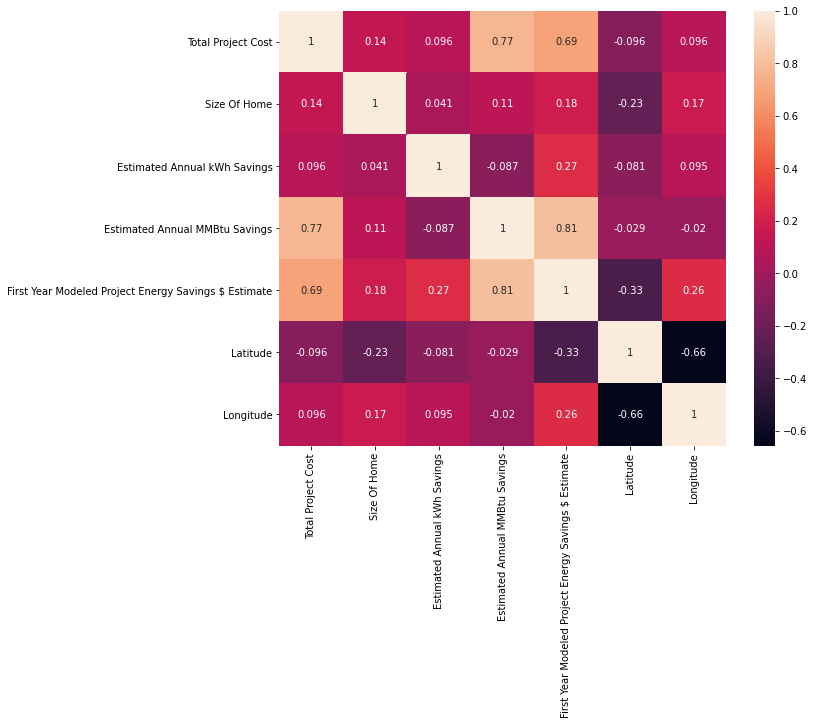

In [170]:
plt.figure(figsize=(10,8))
#sns.color_palette("cubehelix", as_cmap=True)
sns.heatmap(dfMT.corr(),annot=True)
plt.show()

### Pair Plot

<Figure size 3600x3600 with 0 Axes>

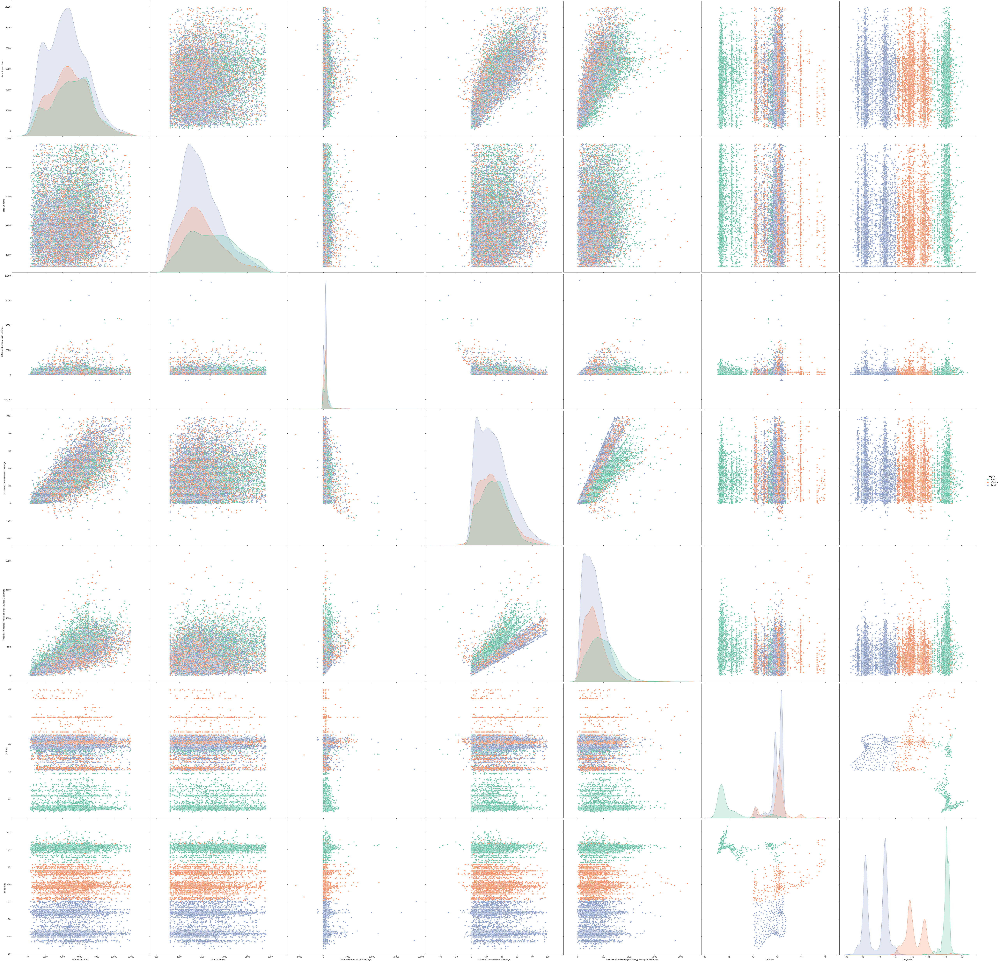

In [171]:
plt.figure(figsize=(50,50))
pp = sns.pairplot(dfMT,hue='Region',height=10)
pp.add_legend()
plt.show()

### Location Scatter Plots

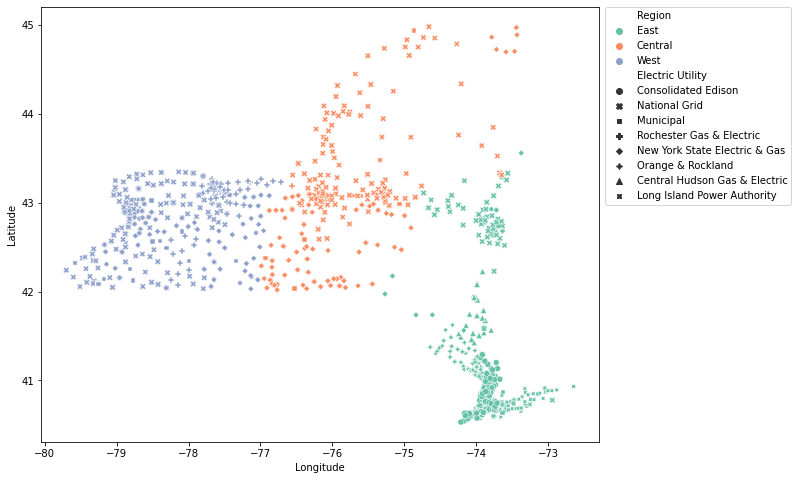

In [172]:
## plot a scatter plot on the world map
fig = px.scatter_mapbox(dfMT, lat="Latitude", lon="Longitude", hover_name =dfMT["Project City"],
                        hover_data=dfMT[["Project County","Electric Utility","Size Of Home"]],
                        color_discrete_sequence=["fuchsia"], zoom=5.7, height=600)

## set the layout of the map
fig.update_layout(
    mapbox_style="white-bg",
    mapbox_layers=[
        {   "below": 'traces',
            "sourcetype": "raster",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"]
        }
      ])
## set magin width to 0 to avoid margins
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

plt.figure(figsize=(10,8))
sns.scatterplot(dfMT['Longitude'],dfMT['Latitude'],hue = dfMT['Region'],style = dfMT['Electric Utility'])
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
plt.show()

### Understanding Imbalances

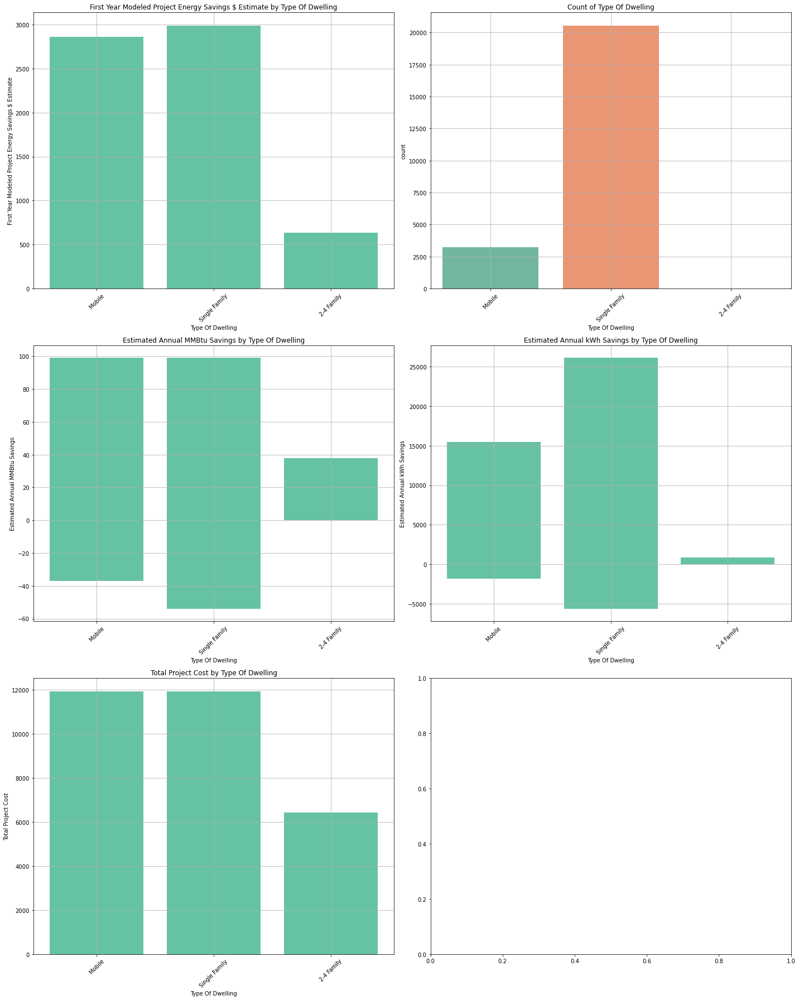

In [173]:
x1='Type Of Dwelling'
x2='First Year Modeled Project Energy Savings $ Estimate'
x3='Estimated Annual MMBtu Savings'
x4='Estimated Annual kWh Savings'
x5='Total Project Cost'
dat=df
targetbar(x1,x2,x3,x4,x5,dat)

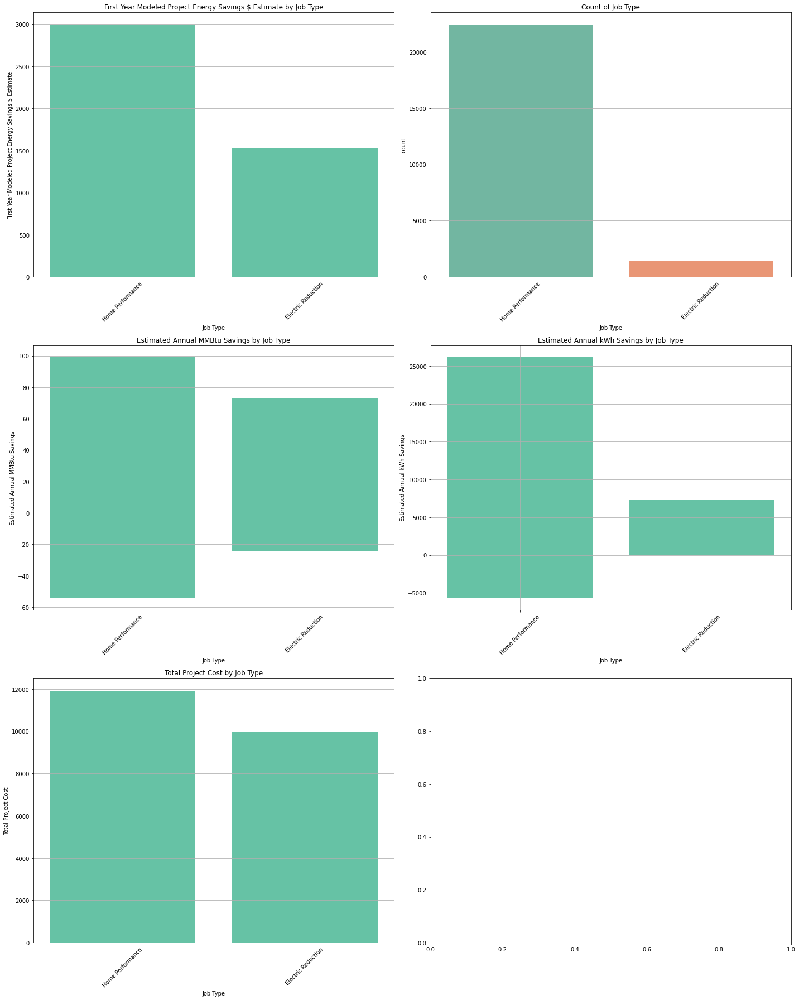

In [174]:
x1='Job Type'
x2='First Year Modeled Project Energy Savings $ Estimate'
x3='Estimated Annual MMBtu Savings'
x4='Estimated Annual kWh Savings'
x5='Total Project Cost'
dat=df
targetbar(x1,x2,x3,x4,x5,dat)

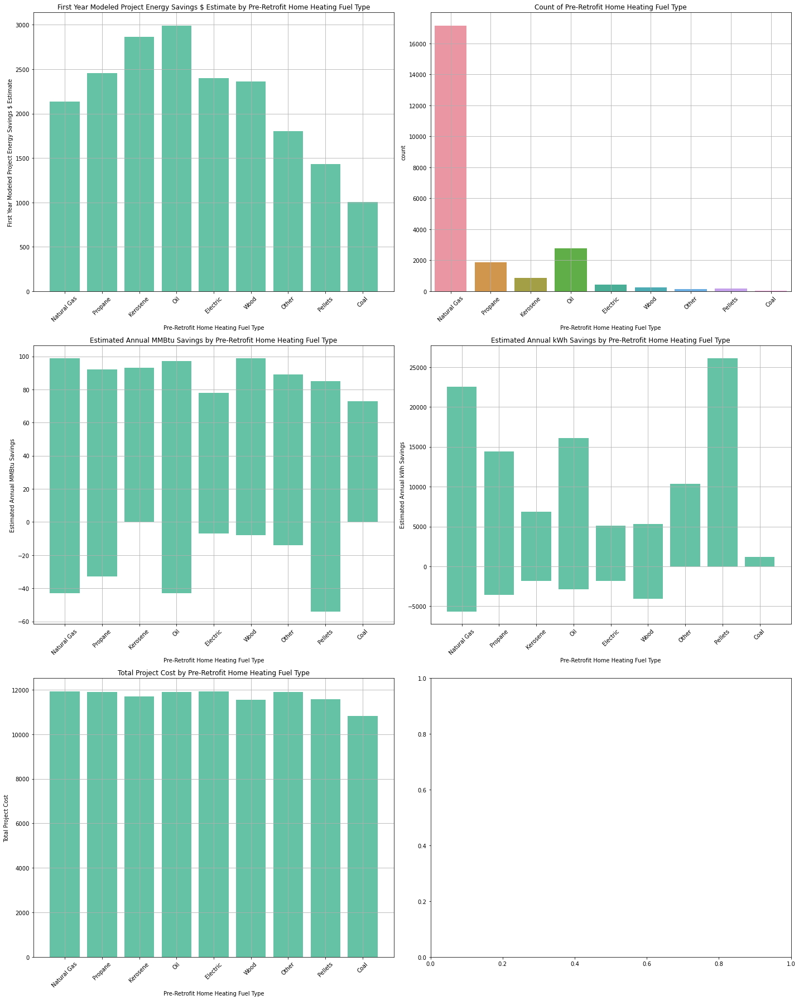

In [175]:
x1='Pre-Retrofit Home Heating Fuel Type'
x2='First Year Modeled Project Energy Savings $ Estimate'
x3='Estimated Annual MMBtu Savings'
x4='Estimated Annual kWh Savings'
x5='Total Project Cost'
dat=df
targetbar(x1,x2,x3,x4,x5,dat)

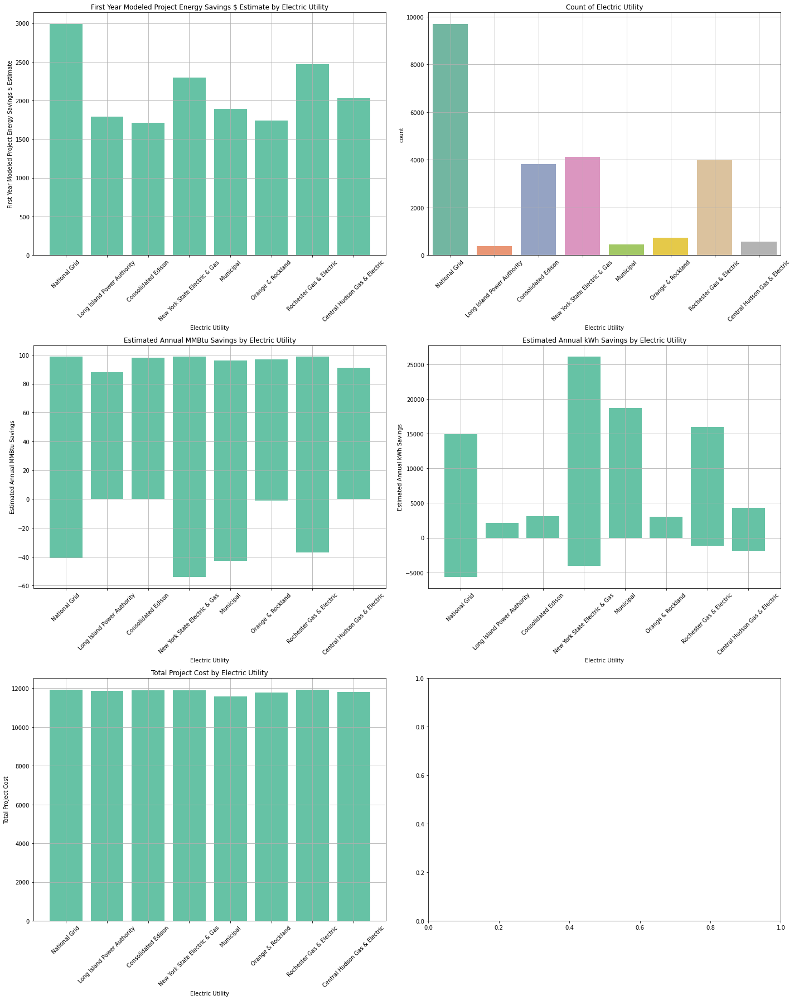

In [176]:
x1="Electric Utility"
x2='First Year Modeled Project Energy Savings $ Estimate'
x3='Estimated Annual MMBtu Savings'
x4='Estimated Annual kWh Savings'
x5='Total Project Cost'
dat=df
targetbar(x1,x2,x3,x4,x5,dat)

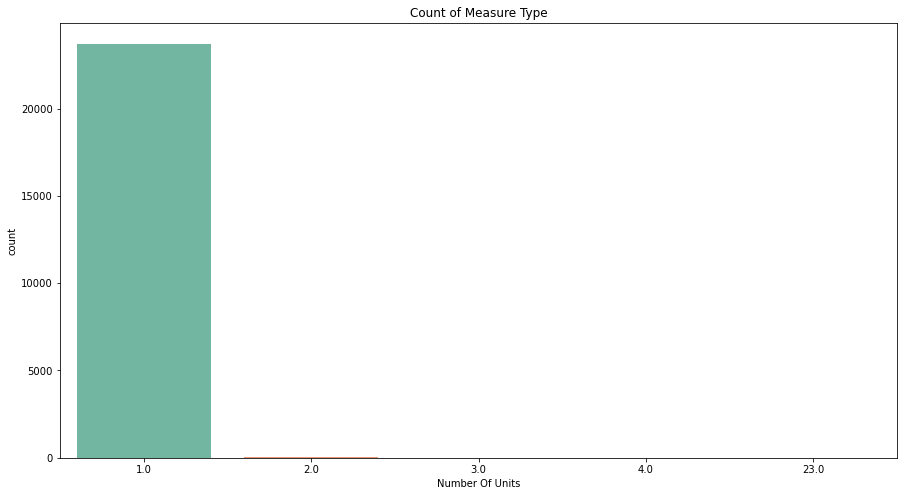

In [177]:
sns.countplot(x='Number Of Units',data = df)
plt.title('Count of Measure Type')
plt.show()

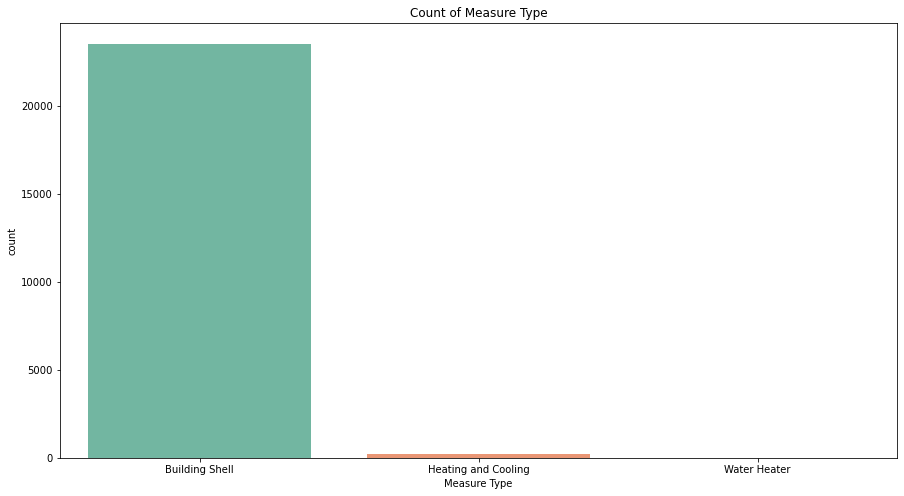

In [179]:
sns.countplot(x='Measure Type',data = df)
plt.title('Count of Measure Type')
plt.show()

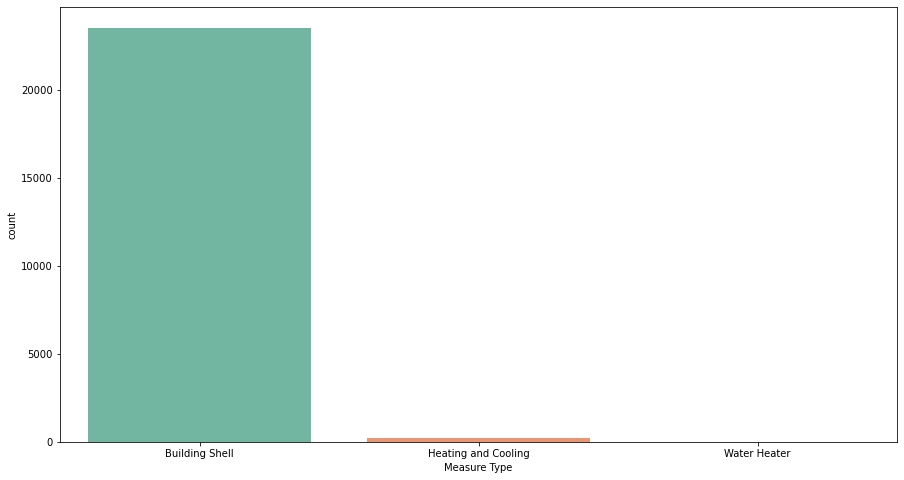

In [180]:
sns.countplot(x='Measure Type',data = df)
plt.show()

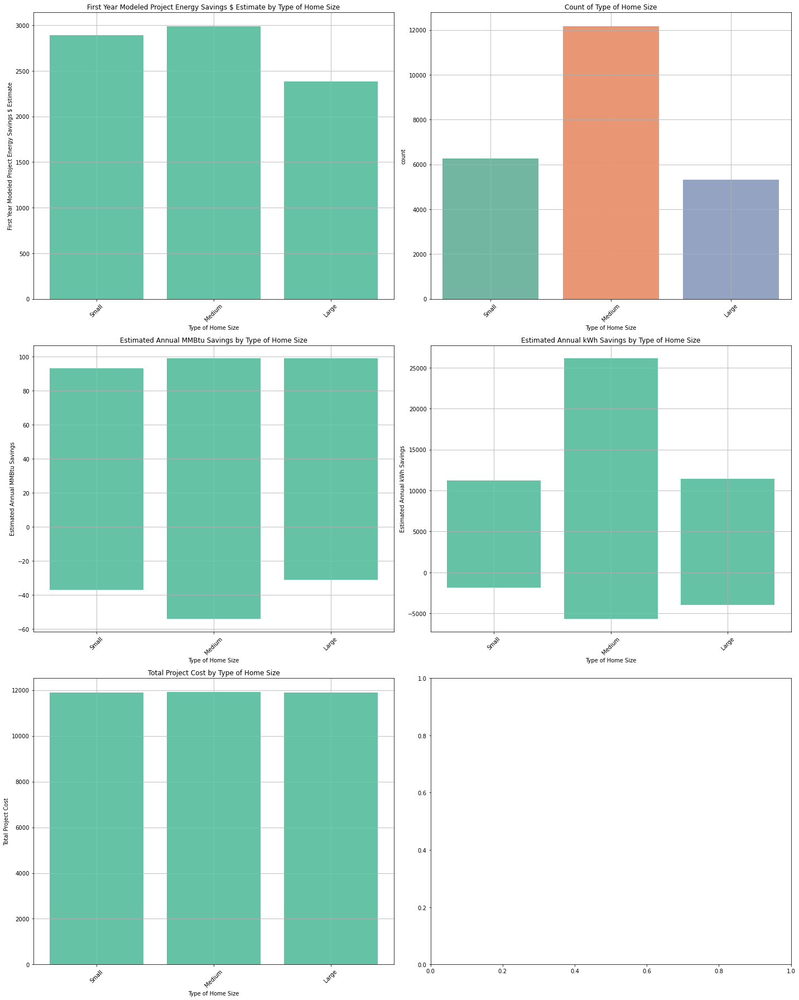

In [181]:
## bar plots and count plot with respect to Type of Home Size
x1='Type of Home Size'
x2='First Year Modeled Project Energy Savings $ Estimate'
x3='Estimated Annual MMBtu Savings'
x4='Estimated Annual kWh Savings'
x5='Total Project Cost'
dat=df
targetbar(x1,x2,x3,x4,x5,dat)

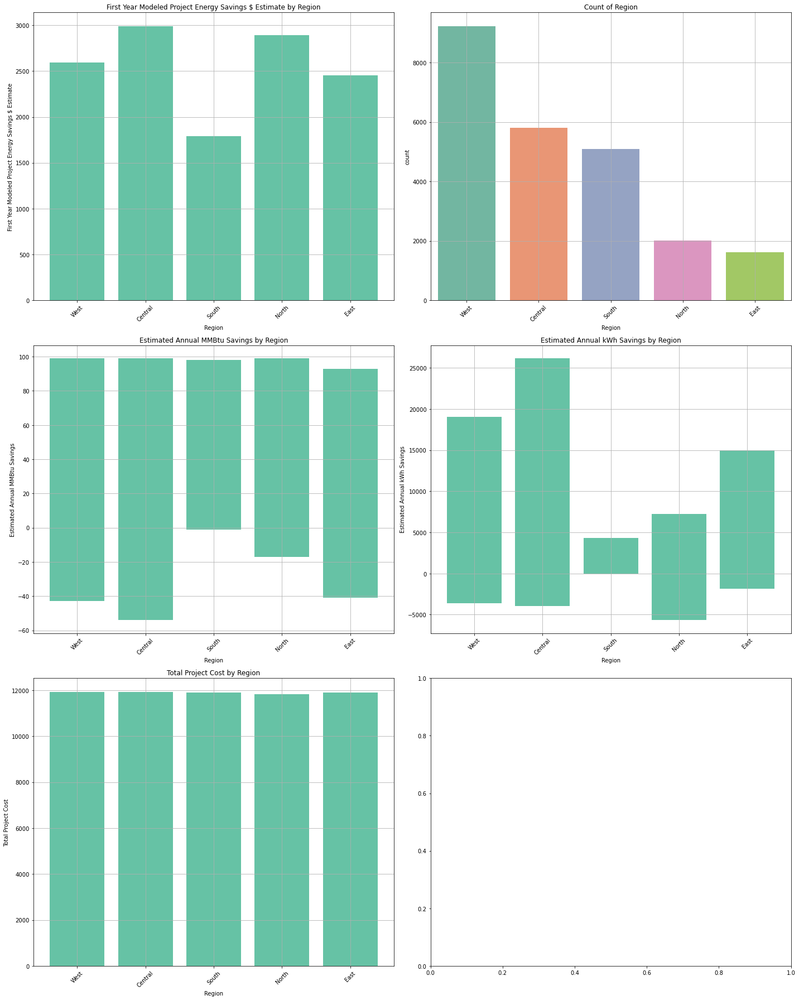

In [182]:
## bar plots and count plot with respect to Region
## bar plots and count plot with Respect to Year
x1='Region'
x2='First Year Modeled Project Energy Savings $ Estimate'
x3='Estimated Annual MMBtu Savings'
x4='Estimated Annual kWh Savings'
x5='Total Project Cost'
dat=df
targetbar(x1,x2,x3,x4,x5,dat)

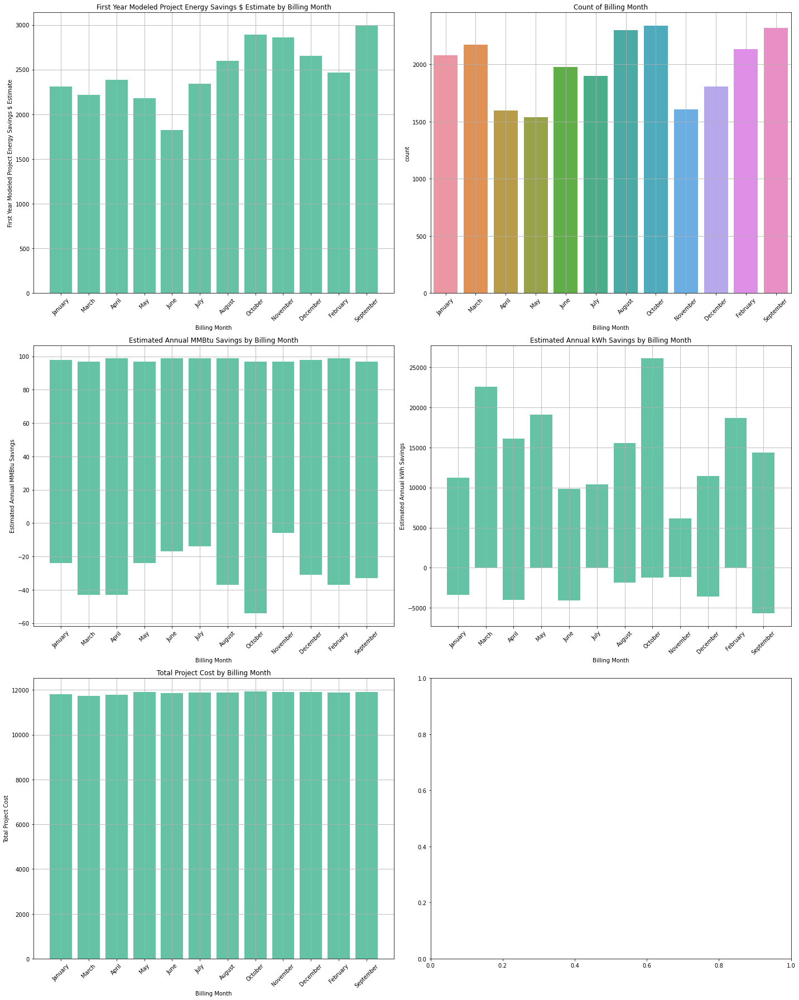

In [183]:
## bar plots and count plot with respect to Billing Month
x1 = 'Billing Month'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Total Project Cost'
dat = df
targetbar(x1,x2,x3,x4,x5,dat)

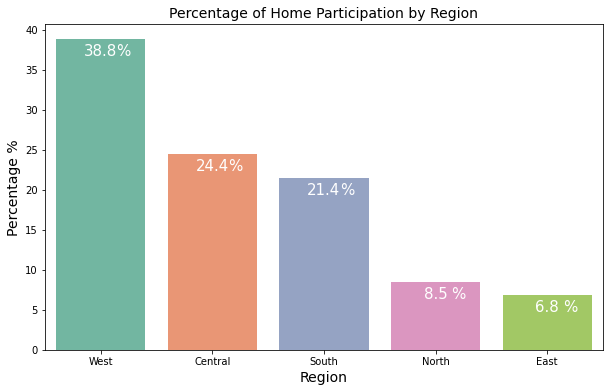

In [184]:
s = df['Region']
counts = s.value_counts()
percent = s.value_counts(normalize=True)
percent100 = s.value_counts(normalize=True).mul(100).round(1).astype(str) + '%'
a = pd.DataFrame({'counts': counts, 'per': percent, 'per100': percent100})
b = pd.DataFrame (data = (a['per']*100),index=a.index,columns=['per'])

f,ax = plt.subplots(figsize=(10,6))
ax = sns.barplot(x=a.index,y=round((a['per']*100),2),data=df)
ax.set_title('Percentage of Home Participation by Region',fontsize=14)
ax.set_ylabel('Percentage %',fontsize=14)
ax.set_xlabel('Region',fontsize=14)

for p in ax.patches:
    ax.annotate(format(p.get_height(), '.1f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center',
                   color='white', 
                   size=15,
                   xytext = (0, -12), 
                   textcoords = 'offset points')
    
for p in ax.patches:
    ax.annotate(('%'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center',
                   color='white', 
                   size=15,
                   xytext = (23, -12), 
                   textcoords = 'offset points')

plt.show()

### Bivariate: Categorical-Numerical  

#### Barplot

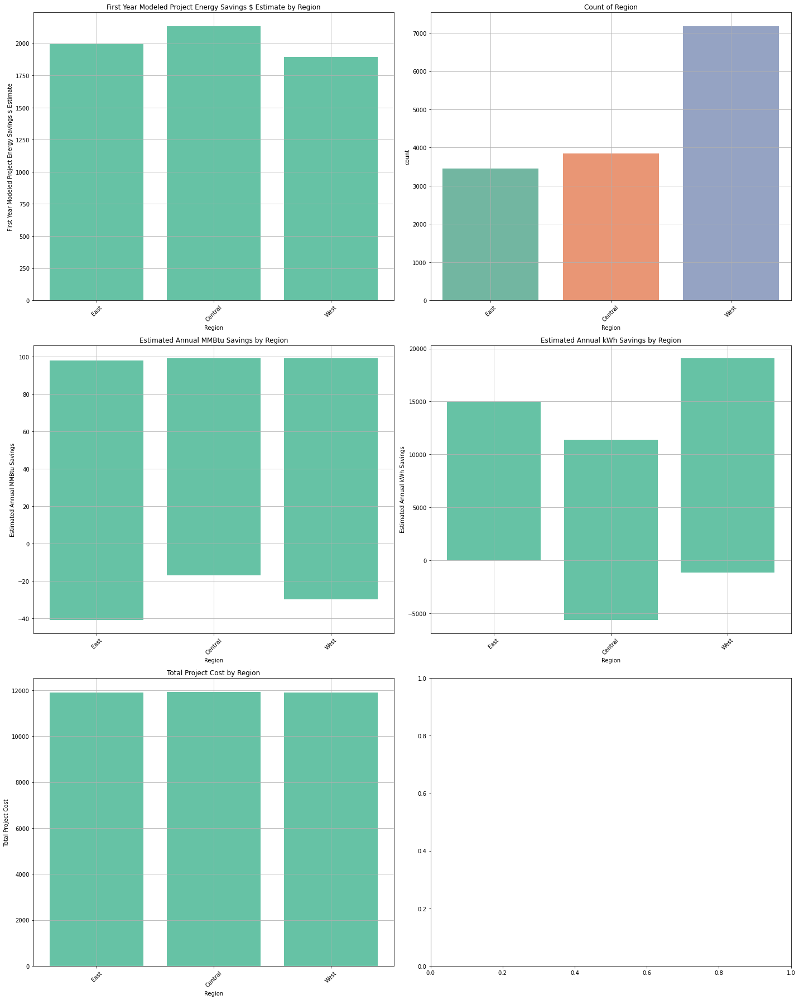

In [185]:
x1 = 'Region'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Total Project Cost'
dat = dfMT
targetbar(x1,x2,x3,x4,x5,dat)

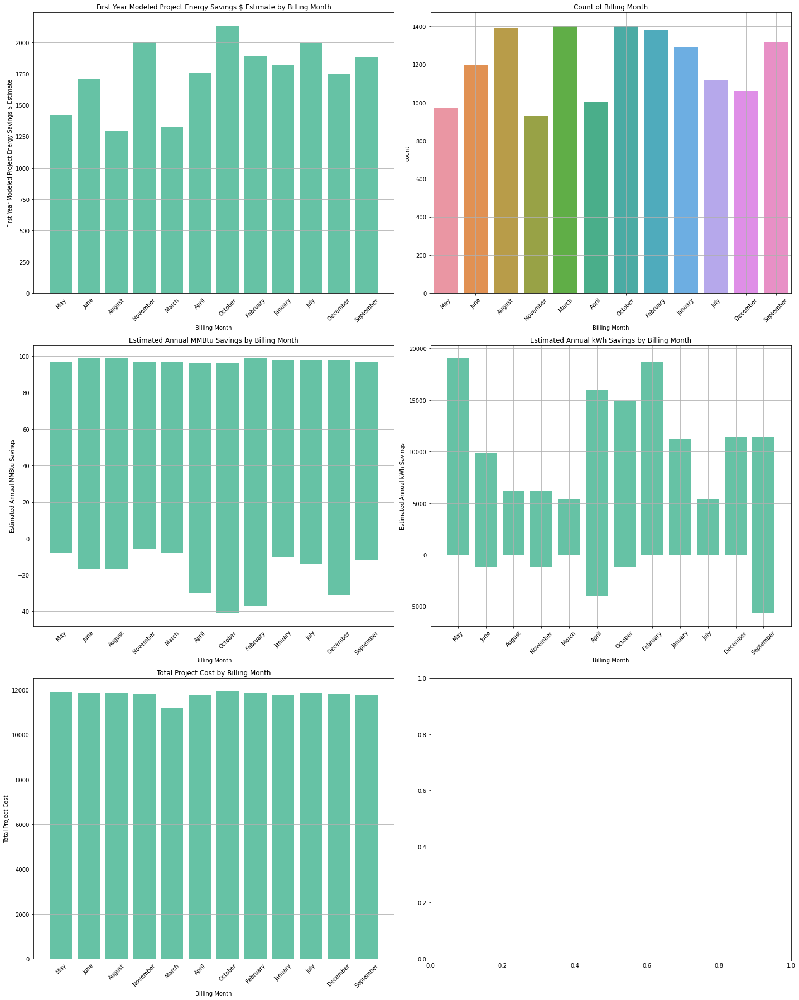

In [186]:
## bar plots and count plot with respect to Billing Month
x1 = 'Billing Month'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Total Project Cost'
dat = dfMT
targetbar(x1,x2,x3,x4,x5,dat)

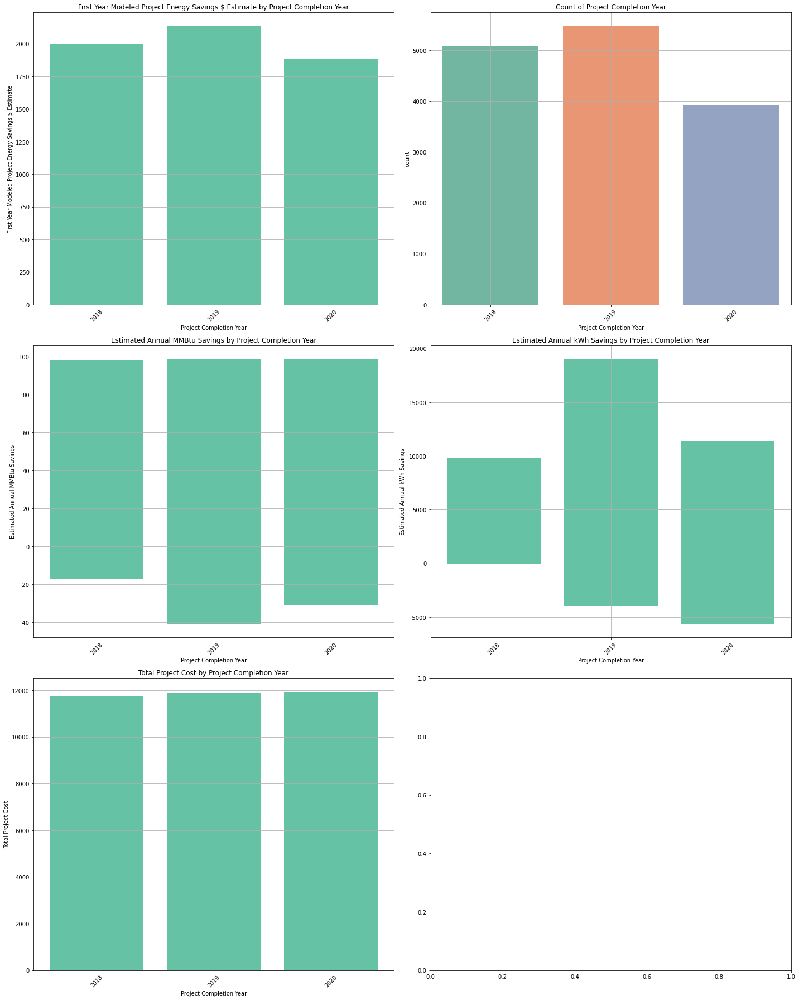

In [187]:
## bar plots and count plot with respect to Billing Month
x1 = 'Project Completion Year'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Total Project Cost'
dat = dfMT
targetbar(x1,x2,x3,x4,x5,dat)

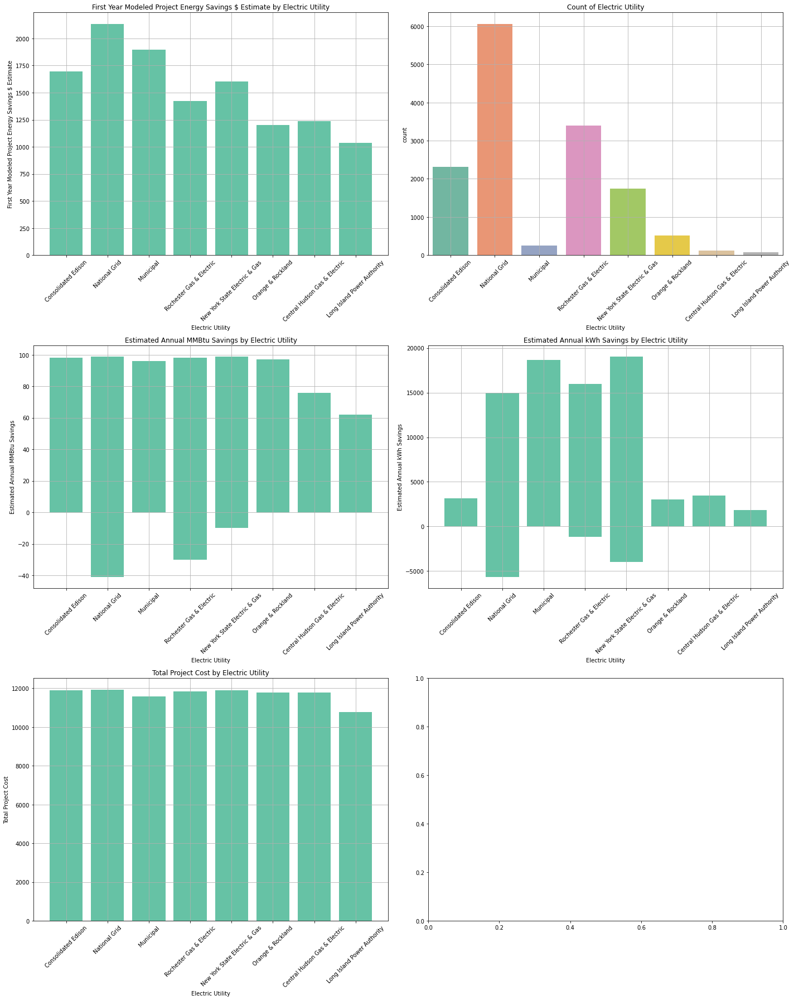

In [188]:
x1 = 'Electric Utility'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Total Project Cost'
dat = dfMT
targetbar(x1,x2,x3,x4,x5,dat)

#### Boxplot

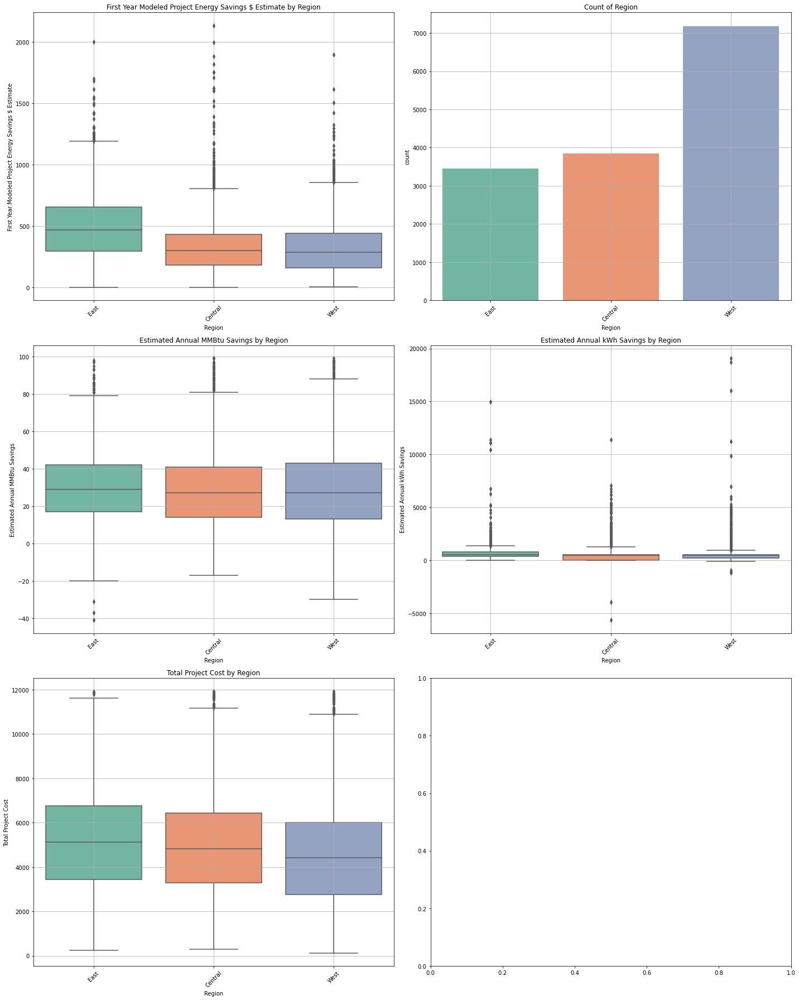

In [189]:
x1 = 'Region'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Total Project Cost'
dat = dfMT
targetbox(x1,x2,x3,x4,x5,dat)

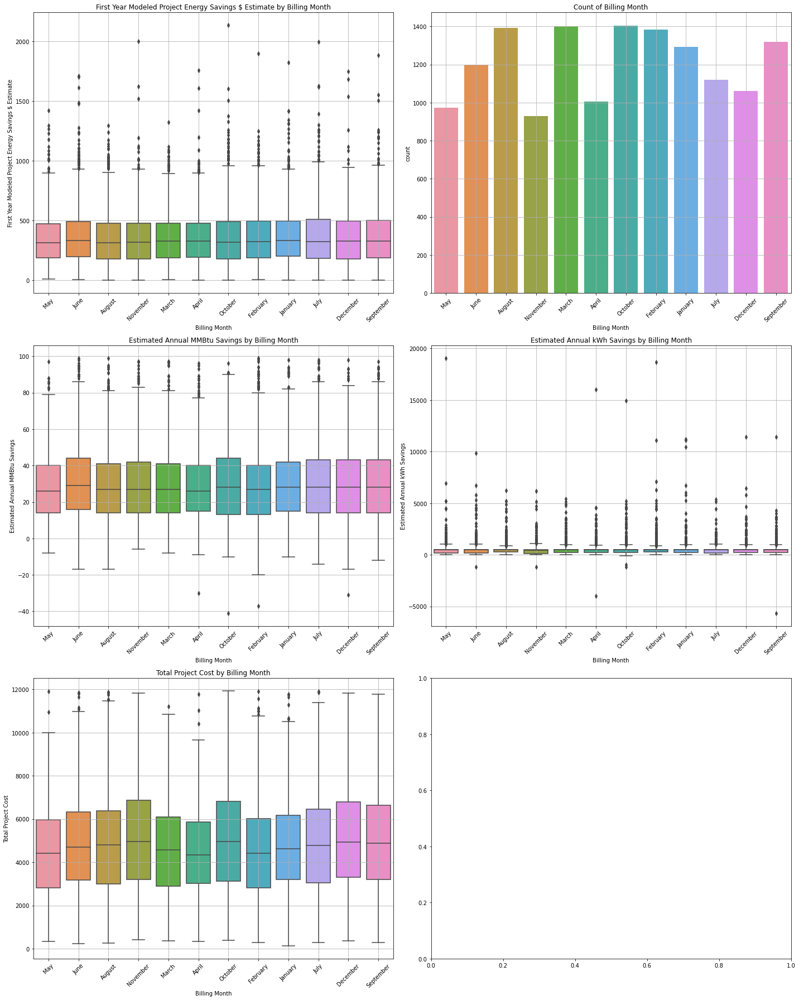

In [190]:
## bar plots and count plot with respect to Billing Month
x1 = 'Billing Month'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Total Project Cost'
dat = dfMT
targetbox(x1,x2,x3,x4,x5,dat)

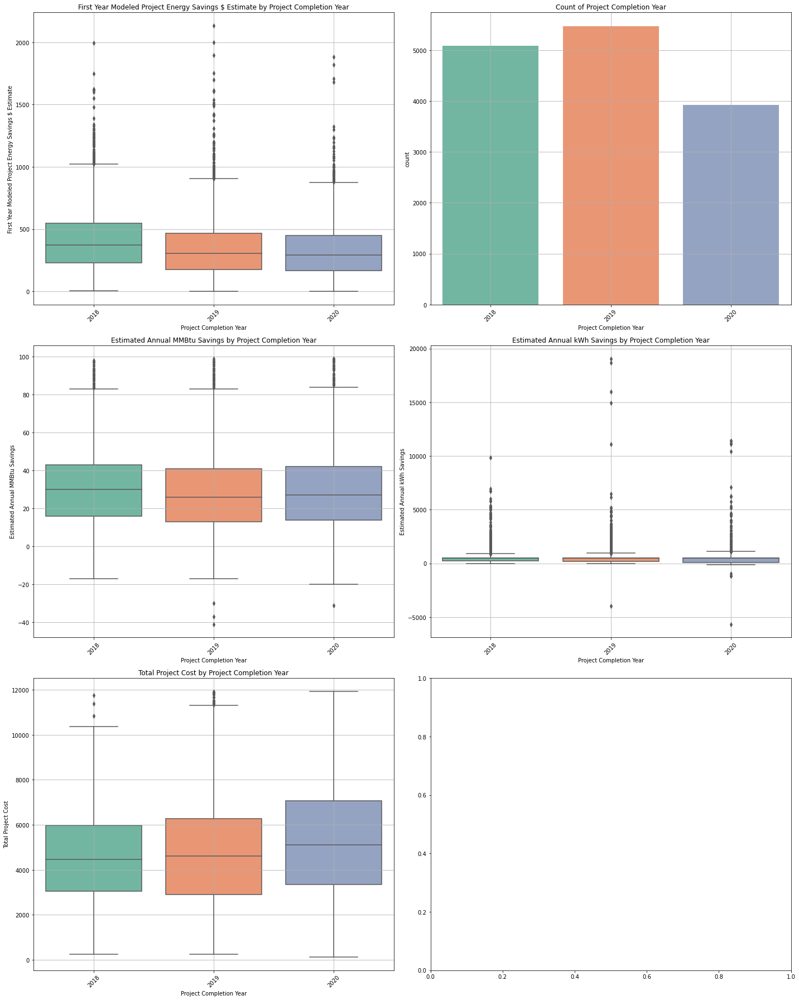

In [191]:
## bar plots and count plot with respect to Billing Month
x1 = 'Project Completion Year'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Total Project Cost'
dat = dfMT
targetbox(x1,x2,x3,x4,x5,dat)

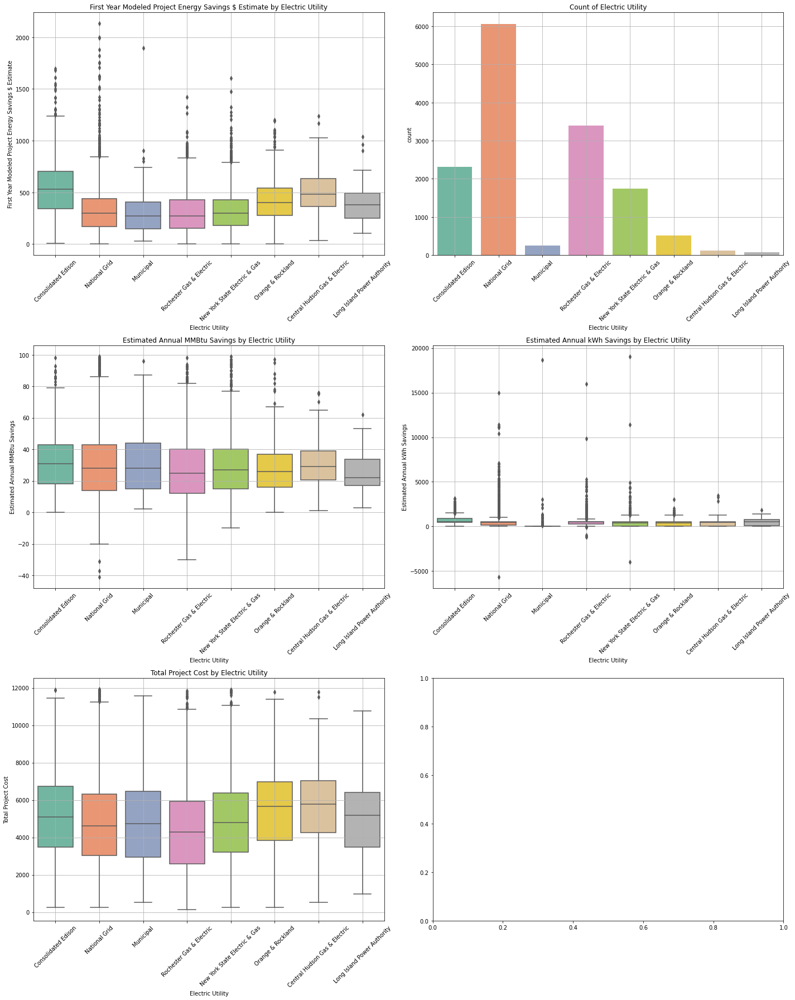

In [192]:
x1 = 'Electric Utility'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Total Project Cost'
dat = dfMT
targetbox(x1,x2,x3,x4,x5,dat)

### Multivariate: Categorical-Numerical

#### Barplot

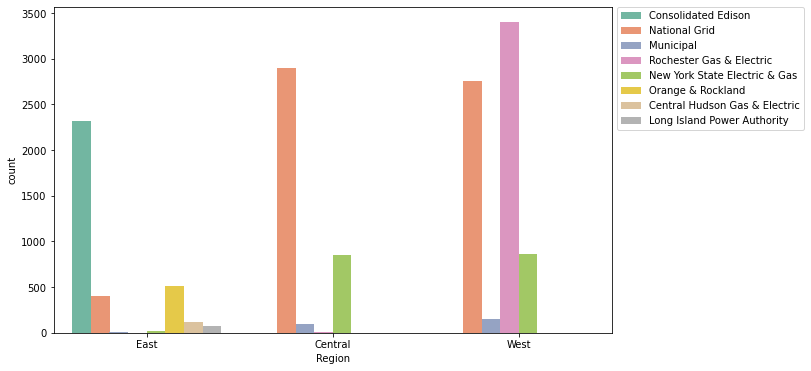

In [193]:
plt.figure(figsize=(10,6))
sns.countplot(x=dfMT['Region'],
              hue = dfMT['Electric Utility'])
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
plt.show()

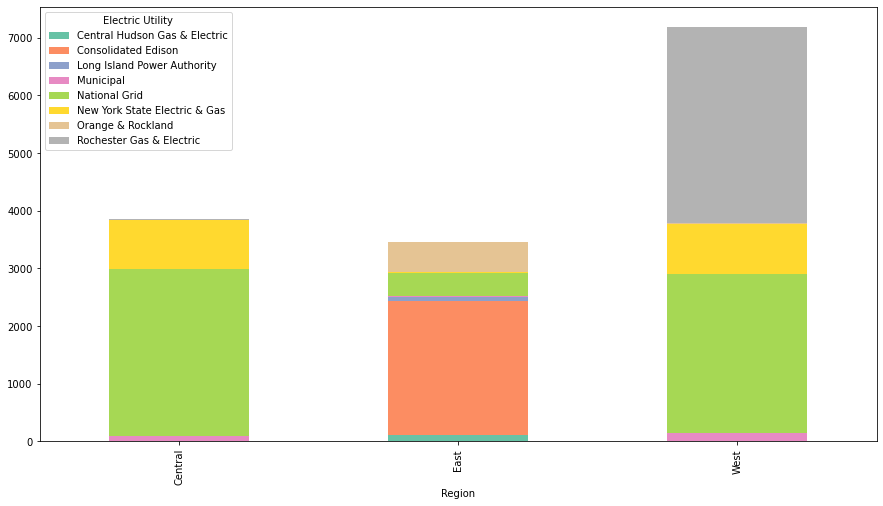

In [194]:
pd.crosstab(dfMT['Region'],dfMT['Electric Utility']).plot(kind = 'bar',stacked = True)
plt.show()

### Bivariate: Numerical-Numerical

#### Lineplot

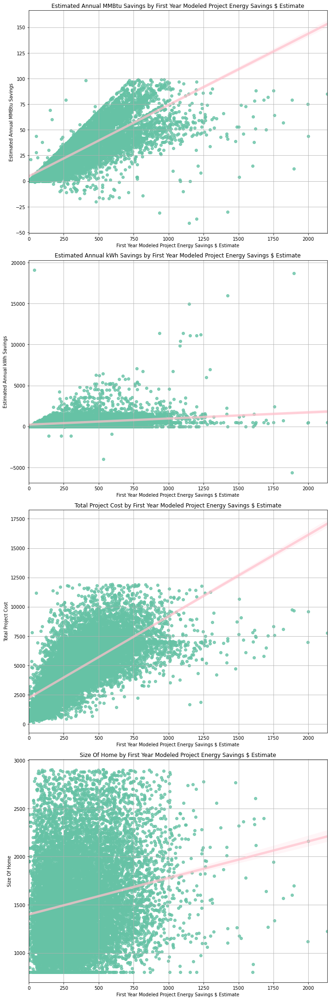

In [195]:
x1 = 'First Year Modeled Project Energy Savings $ Estimate'
x2 = 'Estimated Annual MMBtu Savings'
x3 = 'Estimated Annual kWh Savings'
x4 = 'Total Project Cost'
x5 = 'Size Of Home'
dat = dfMT

targetreg(x1,x2,x3,x4,x5,dat)

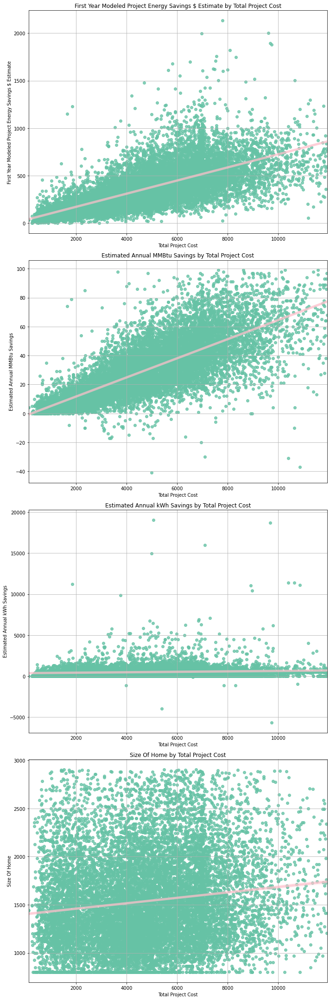

In [196]:
x1 = 'Total Project Cost'
x2 = 'First Year Modeled Project Energy Savings $ Estimate'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'Size Of Home'
dat = dfMT
targetreg(x1,x2,x3,x4,x5,dat)

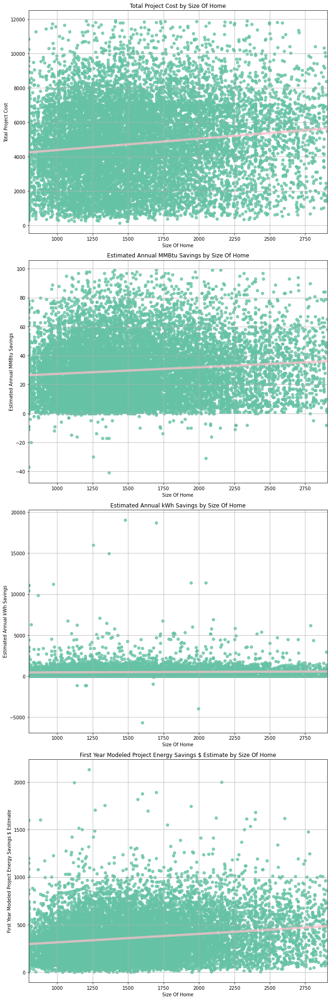

In [197]:
x1 = 'Size Of Home'
x2 = 'Total Project Cost'
x3 = 'Estimated Annual MMBtu Savings'
x4 = 'Estimated Annual kWh Savings'
x5 = 'First Year Modeled Project Energy Savings $ Estimate'
dat = dfMT
targetreg(x1,x2,x3,x4,x5,dat)

### Multivariate: Numerical-Numerical-Categorical

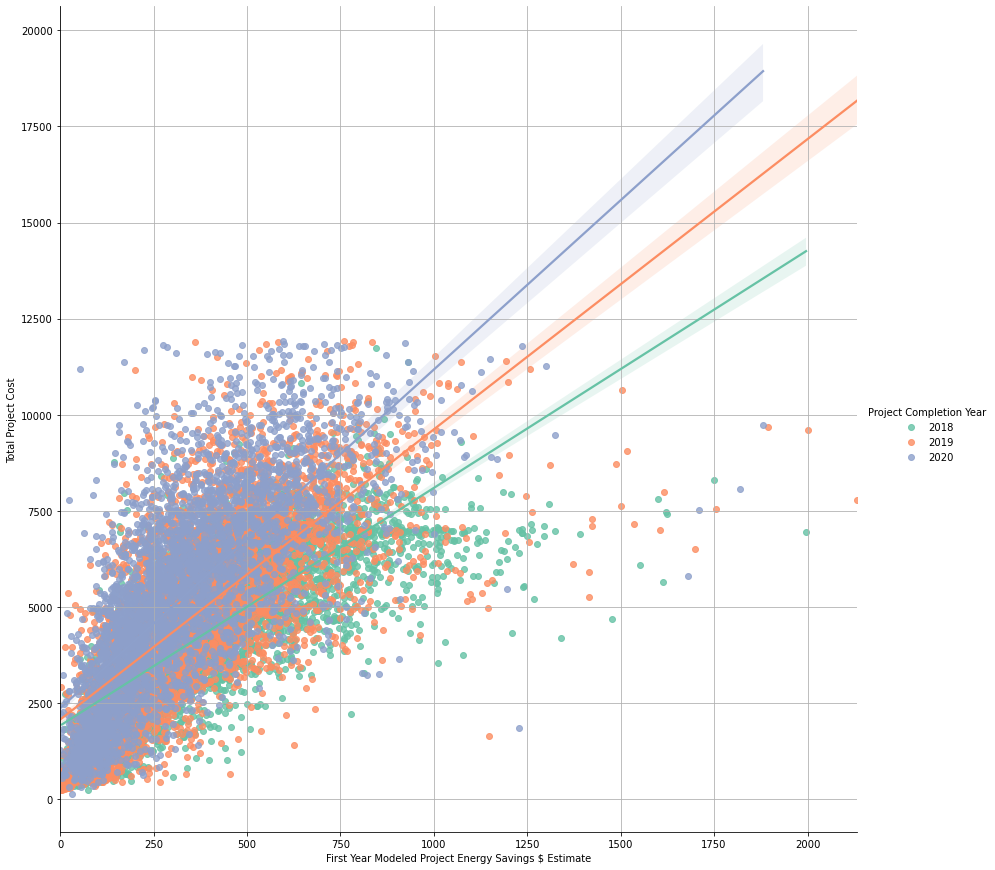

In [198]:
sns.lmplot(x='First Year Modeled Project Energy Savings $ Estimate',y='Total Project Cost',
           hue='Project Completion Year',data=dfMT,size=12)
plt.grid()
plt.show()

# Statistical Significance

## Descriptive Statistics

In [199]:
df.drop(['Latitude','Longitude'],axis=1).describe()

,Total Project Cost,Size Of Home,Number Of Units,Estimated Annual kWh Savings,Estimated Annual MMBtu Savings,First Year Modeled Project Energy Savings $ Estimate
count,23762.000000,23762.000000,23762.000000,23762.000000,23762.000000,23762.000000
mean,4702.562411,1445.439357,1.003072,477.069775,26.882964,408.359061
std,2459.766635,487.733311,0.151973,653.972554,19.085001,298.569023
min,129.000000,800.000000,1.000000,-5656.000000,-54.000000,0.000000
25%,2879.500000,1054.000000,1.000000,208.000000,12.000000,188.000000
50%,4788.500000,1353.000000,1.000000,460.000000,25.000000,347.000000
75%,6464.000000,1755.000000,1.000000,510.000000,38.000000,551.000000
max,11927.000000,2904.000000,23.000000,26141.000000,99.000000,2989.000000


In [200]:
dfMT.drop(['Latitude','Longitude'],axis=1).describe()

,Total Project Cost,Size Of Home,Estimated Annual kWh Savings,Estimated Annual MMBtu Savings,First Year Modeled Project Energy Savings $ Estimate
count,14474.000000,14474.000000,14474.000000,14474.000000,14474.000000
mean,4737.985077,1536.298397,489.043457,29.799157,361.057966
std,2285.957406,471.341213,636.102769,19.669502,227.959461
min,129.000000,800.000000,-5656.000000,-41.000000,0.000000
25%,3057.000000,1180.000000,208.000000,14.000000,187.000000
50%,4695.000000,1454.000000,486.000000,28.000000,325.000000
75%,6360.000000,1830.000000,510.000000,42.000000,490.000000
max,11927.000000,2904.000000,19066.000000,99.000000,2133.000000


## Checking for Normality

### Distribution Plots

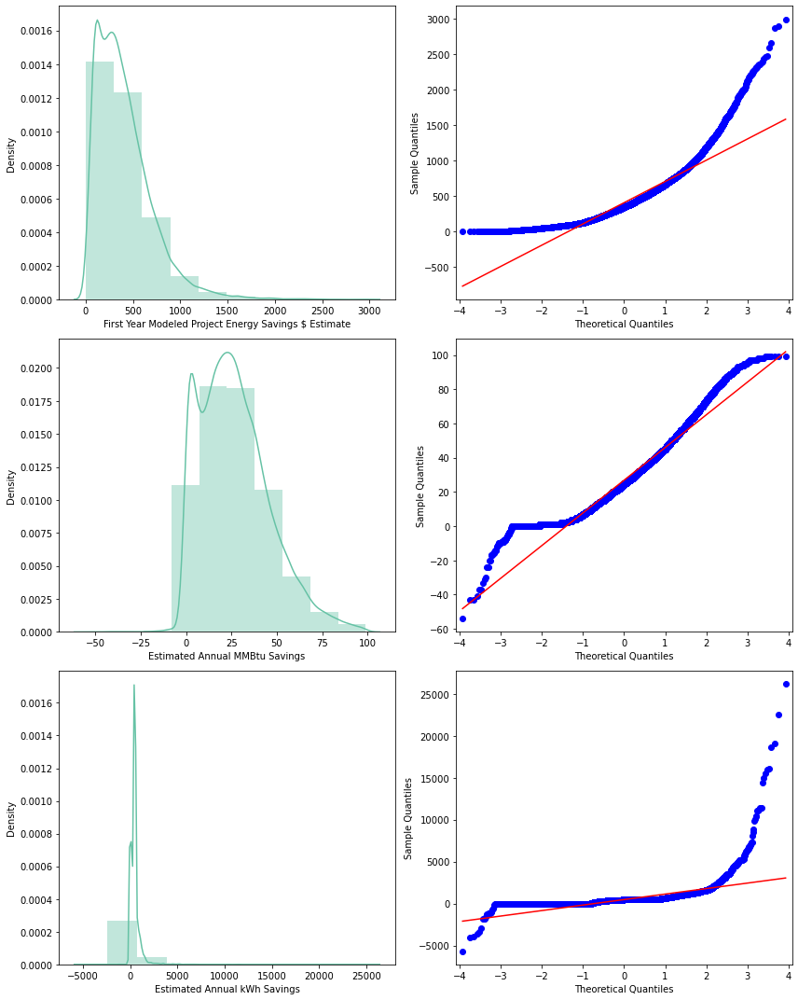

In [201]:
fig, ax = plt.subplots(3,2,figsize=(12,15))
sns.distplot(df['First Year Modeled Project Energy Savings $ Estimate'],hist=True,kde=True,bins=10,ax=ax[0,0])
qqplot(df['First Year Modeled Project Energy Savings $ Estimate'], line='s',ax=ax[0,1])
sns.distplot(df['Estimated Annual MMBtu Savings'],hist=True,kde=True,bins=10,ax=ax[1,0])
qqplot(df['Estimated Annual MMBtu Savings'], line='s',ax=ax[1,1])
sns.distplot(df['Estimated Annual kWh Savings'],hist=True,kde=True,bins=10,ax=ax[2,0])
qqplot(df['Estimated Annual kWh Savings'], line='s',ax=ax[2,1])
plt.tight_layout()
plt.show()

- Heavily skewed towards right.
- Not normally distributed

In [202]:
sns.distplot(y_trainMT_sqr,hist=True,kde=True,bins=10)
qqplot(y_trainMT_sqr, line='s')
plt.tight_layout()
plt.show()

NameError: name 'y_trainMT_sqr' is not defined

In [ ]:
sns.distplot(y_trainMT_sqr1,hist=True,kde=True,bins=10)
qqplot(y_trainMT_sqr1, line='s')
plt.tight_layout()
plt.show()

In [ ]:
stat, p = shapiro(df["First Year Modeled Project Energy Savings $ Estimate"])

print(stat,p)

In [ ]:
stat, p = shapiro(y_trainMT_sqr)

print(stat,p)

In [ ]:
stat, p = shapiro(y_trainMT_sqr1)

print(stat,p)

### Shapiro-Wilk Test

**The null and alternate hypothesis of Shapiro test are as follows:**

H0: The data is normally distributed

H1: The data is not normally distributed

In [ ]:
# normality test using shapiro()
# the test returns the the test statistics and the p-value of the test
stat, p = shapiro(df["First Year Modeled Project Energy Savings $ Estimate"])
stat1,p1 = shapiro(df["Estimated Annual MMBtu Savings"])
stat2,p2 = shapiro(df["Estimated Annual kWh Savings"])

# display the conclusion
# set the level of significance to 0.05
alpha = 0.05

# to print the numeric outputs of the Jarque-Bera test upto 3 decimal places
# %.3f: returns the a floating point with 3 decimal digit accuracy
# the '%' holds the place where the number is to be printed
# if the p-value is greater than alpha print we accept alpha 
# if the p-value is less than alpha print we reject alpha

print('Statistics=%.3f, P-Value=%.3f' % (stat, p))
if p > alpha:
    print('The data for First Year Modeled Project Energy Savings $ Estimate is normally distributed (fail to reject H0)')
else:
    print('The data for First Year Modeled Project Energy Savings $ Estimate is not normally distributed (reject H0)')
print('\n')
print('Statistics=%.3f, P-Value=%.3f' % (stat1, p1))
if p1 > alpha:
    print('The data for Estimated Annual MMBtu Savings is normally distributed (fail to reject H0)')
else:
    print('The data is for Estimated Annual MMBtu Savings not normally distributed (reject H0)')
print('\n')
print('Statistics=%.3f, P-Value=%.3f' % (stat2, p2))
if p2 > alpha:
    print('The data for Estimated Annual kWh Savings is normally distributed (fail to reject H0)')
else:
    print('The data for Estimated Annual kWh Savings is not normally distributed (reject H0)')

# Initial Modelling

In [ ]:
df_modelling=copy.deepcopy(df)
df_modelling.head()

In [ ]:
# remove 'project county','project city','latitude','longitude','type of home size'

df_modelling.drop(['Project County','Project City','Latitude','Longitude','Type of Home Size'],axis=1,inplace=True)
df_modelling.head()

In [ ]:
X = df_modelling.drop(['First Year Modeled Project Energy Savings $ Estimate'],axis=1)
y = df_modelling['First Year Modeled Project Energy Savings $ Estimate']

X.head()

In [ ]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42)
print(X_train.shape,y_train.shape)
print(X_test.shape,y_test.shape)

In [ ]:
# dropping 'project completion date' as we have 'project completion year' in place

X_train.drop(['Project Completion Date'],axis=1,inplace=True)
X_test.drop(['Project Completion Date'],axis=1,inplace=True)
X_train.head()

In [ ]:
# reporting period for all the records is 2021.
# therefore, reporting_period-project_completion_year is the num_of_yrs_since_completion which makes more sense

X_train['num_yrs_since_proj_completion'] = X_train['Project Completion Year'].astype('int64').apply(lambda x: 2021-x)
X_train.drop(['Project Completion Year'],axis=1,inplace=True)

X_test['num_yrs_since_proj_completion'] = X_test['Project Completion Year'].astype('int64').apply(lambda x: 2021-x)
X_test.drop(['Project Completion Year'],axis=1,inplace=True)

print(X_train.head())
print(X_test.head())

## Feature Sets

### Feature Set 1: One Hot Encoded

In [ ]:
import copy
X_train_ohe = copy.deepcopy(X_train)
X_test_ohe = copy.deepcopy(X_test)
print(X_train_ohe.shape)
print(X_test_ohe.shape)

In [ ]:
cat_dat_tr = X_train_ohe.select_dtypes(include='object')
cat_dat_te = X_test_ohe.select_dtypes(include='object')

cat_dat_tr

In [ ]:
train_objs_num = len(X_train)
dataset = pd.concat(objs=[cat_dat_tr,cat_dat_te], axis=0)

dataset = pd.get_dummies(dataset,drop_first=True)
X_tr_cat_dat = copy.deepcopy(dataset[:train_objs_num])
X_te_cat_dat = copy.deepcopy(dataset[train_objs_num:])

print(X_tr_cat_dat.shape)
print(X_te_cat_dat.shape)

In [ ]:
##### encoding/scaling numerical data
X_tr_num_dat = X_train_ohe.select_dtypes(include=np.number)
X_te_num_dat = X_test_ohe.select_dtypes(include=np.number)

In [ ]:
# scaling numerical data  using standard scaler

for i in X_tr_num_dat.columns:
    ss=StandardScaler()
    X_tr_num_dat[i] = ss.fit_transform(X_tr_num_dat[[i]])
    X_te_num_dat[i] = ss.transform(X_te_num_dat[[i]])
    
print(X_tr_num_dat.shape)
print(X_te_num_dat.shape)

In [ ]:
X_train_ohe = X_tr_cat_dat.join(X_tr_num_dat,how='inner') 
X_test_ohe = X_te_cat_dat.join(X_te_num_dat,how='inner')

print(X_train_ohe.shape)
X_test_ohe.shape

In [ ]:
print(y_train.shape)
print(y_test.shape)

### Feature Set 2: Frequency Encoded

In [ ]:
X_train_freq = copy.deepcopy(X_train)
X_test_freq = copy.deepcopy(X_test)

In [ ]:
cat_dat_tr = X_train_freq.select_dtypes(include='object')
cat_dat_te = X_test_freq.select_dtypes(include='object')

cat_dat_tr

In [ ]:
c=copy.deepcopy(cat_dat_tr)
for i in cat_dat_tr.columns:
    d = dict(cat_dat_tr[i].value_counts(normalize=True))
    print(d)
    cat_dat_tr[i]=cat_dat_tr[i].apply(lambda x:d[x])

cat_dat_tr

In [ ]:
def return_freq(d,x):
    try:
        return d[x]
    except:
        return 0
for i in cat_dat_te.columns:
    d = dict(c[i].value_counts(normalize=True))
    print(d)
    cat_dat_te[i]=cat_dat_te[i].apply(lambda x:return_freq(d,x))

cat_dat_te.head()

In [ ]:
X_train_freq = cat_dat_tr.join(X_tr_num_dat,how='inner') 
X_test_freq = cat_dat_te.join(X_te_num_dat,how='inner')

print(X_train_freq.shape)
X_test_freq.shape

## Base Models

### OLS Base Model

#### Base OLS Model after Backward Elimination

In [ ]:
Xc1 = Xc[selected_features]
model1 = sm.OLS(y,Xc1).fit()
model1.summary()

In [ ]:
Xc1 = Xc[selected_features]
model1 = sm.OLS(y,Xc1).fit()
model1.summary()

In [ ]:
residuals = model1.resid
y_pred = model1.predict(Xc1)

### Testing for Assumptions for OLS Base Model

#### Assumption 1: Multicollinearity

In [ ]:
vf = [vif(Xc1.values,i) for i in range(Xc1.shape[1])]
vfdf = pd.DataFrame(vf, index= Xc1.columns, columns=['vif'])
vfdf

#### Assumption 2: Normality of Residuals

In [ ]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
stats.probplot(residuals,plot=plt)
plt.subplot(1,2,2)
#skewnorm.fit(residuals)
sns.distplot(residuals,fit=skewnorm,kde=True,hist=False,label='Skewed Normal')
#norm.fit(residuals)
#sns.distplot(residuals,fit=norm,kde=True,hist=False,color='red',label='Standard Normal')
#plt.legend()
plt.show()

##### Jarque Berra Test for checking goodness of fit

In [ ]:
jarque_bera(residuals)

~~~
H0: Residuals are normally distributed
H1: Residuals are not normally distributed
~~~
- Since P-Value(0.0) is less than significance level, we will reject H0 to conclude that residuals are not normally distributed.

#### Assumption 3: Homoscedasticity

In [ ]:
plt.figure(figsize=(8,5))
sns.regplot(x=y_pred,y=residuals, lowess=True, line_kws={'color':'red'})
plt.xlabel('y_pred')
plt.ylabel('residuals')
plt.show()

##### Goldfeld Quandt Test for checking Homoscedasticity

In [ ]:
test = sms.het_goldfeldquandt(y=residuals,x=Xc1)
test

~~~
H0: Variance of residuals is constant across the range of data
H1: Variance of residuals is not constant across the range of  data
~~~
- Since P-Value(2.0360055000948948e-07) is less than significance level, we will reject H0 to conclude that variance of residuals is not constant.

#### Assumption 4: Auto-Correlation

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
acf = smt.graphics.plot_acf(residuals,lags=30,ax=ax)
acf.show()

#### Assumption 5: Linearity of Relationship

In [ ]:
plt.figure(figsize=(10,10))
plt.subplot(2,1,1)
sns.regplot(x=y_pred,y=y,lowess=True,line_kws={'color':'red'})
plt.subplot(2,1,2)
sns.regplot(x=y_pred,y=residuals, lowess=True, line_kws={'color':'red'})
plt.xlabel('y_pred')
plt.ylabel('residuals')
plt.show()

In [ ]:
sm.stats.diagnostic.linear_rainbow(model1)

~~~
H0: Fit of model using full sample = Fit of model using a central subset (linear relationship)
H1: Fit of model using full sample is worse compared to fit of model using a central subset.
~~~
- Since P-Value(7.385520188495804e-34) is lower than significance level, we will reject the H0 to conclude that Fit of model using full sample is worse compared to fit of model using a central subset. We need to improve our model.

### Model 1: K Nearest Neighbors Regression

#### 1.1: KNN regression with One-Hot Encoded features

In [ ]:
neigh = KNeighborsRegressor()
neigh.fit(X_train_ohe,y_train)

y_tr_pred = neigh.predict(X_train_ohe)
print('train rmse knn regression:',np.sqrt(mean_squared_error(y_train,y_tr_pred)))

y_te_pred = neigh.predict(X_test_ohe)
print('test rmse knn regression:',np.sqrt(mean_squared_error(y_test,y_te_pred)))

In [ ]:
# finding best value of 'n' by manual tuning
train_mse=[]
test_mse=[]
for n in range(20):
    n = n+1
    model = KNeighborsRegressor(n_neighbors = n)
    
    model.fit(X_train_ohe, y_train)  #fit the model
    y_tr_pred=model.predict(X_train_ohe) #make prediction on test set
    tr_mse = mean_squared_error(y_train,y_tr_pred) #calculate rmse
    train_mse.append(tr_mse)
    
    y_te_pred=model.predict(X_test_ohe) #make prediction on test set
    te_mse = mean_squared_error(y_test,y_te_pred)
    test_mse.append(te_mse)
    print('test RMSE value for n =' , n , 'is:', np.sqrt(te_mse))

In [ ]:
n = [i for i in range(1,21)]
plt.plot(n,test_mse,color='g',label='test mse')
plt.plot(n,train_mse,color='r',label='train mse')
plt.xticks([1,3,5,7,9,11,13,15,17,19])
plt.legend()
plt.show()

- from the manual hyper parameter tuning, knn regressor with neighbours=7 gave the best mean squared error on test data

In [ ]:
# Setup the parameters 
k_range = list(range(1, 21))
param_grid = dict(n_neighbors=k_range)


knn = KNeighborsRegressor()

# Instantiate the GridSearchCV object: knn_cv
knn_cv = GridSearchCV(knn,param_grid,scoring='r2',cv=5,n_jobs=-1)
knn_cv.fit(X_train_ohe,y_train)


print("Tuned Decision Tree Parameters: {}".format(knn_cv.best_params_))
print("Best score is {}".format(knn_cv.best_score_))

In [ ]:
neigh = KNeighborsRegressor(**knn_cv.best_params_) # picking optimal k as 9 from random search
neigh.fit(X_train_ohe,y_train)

y_tr_pred = neigh.predict(X_train_ohe)
print('train rmse knn regression with best parameters:',np.sqrt(mean_squared_error(y_train,y_tr_pred)))

y_te_pred = neigh.predict(X_test_ohe)
print('test rmse knn regression with best parameters:',np.sqrt(mean_squared_error(y_test,y_te_pred)))

#### 1.2: KNN regression with Frequency Encoded Feature Set

In [ ]:
neigh = KNeighborsRegressor()
neigh.fit(X_train_freq,y_train)

y_tr_pred = neigh.predict(X_train_freq)
print('train rmse knn regression:',np.sqrt(mean_squared_error(y_train,y_tr_pred)))

y_te_pred = neigh.predict(X_test_freq)
print('test rmse knn regression:',np.sqrt(mean_squared_error(y_test,y_te_pred)))

In [ ]:
train_mse=[]
test_mse=[]
for n in range(20):
  n = n+1
  model = KNeighborsRegressor(n_neighbors = n)

  model.fit(X_train_freq, y_train)  #fit the model
  y_tr_pred=model.predict(X_train_freq) #make prediction on test set
  tr_mse = mean_squared_error(y_train,y_tr_pred) #calculate rmse
  train_mse.append(tr_mse)

  y_te_pred=model.predict(X_test_freq) #make prediction on test set
  te_mse = mean_squared_error(y_test,y_te_pred)
  test_mse.append(te_mse)
  print('test RMSE value for n =' , n , 'is:', np.sqrt(te_mse))

In [ ]:
n = [i for i in range(1,21)]
plt.plot(n,test_mse,color='g',label='test mse')
plt.plot(n,train_mse,color='r',label='train mse')
plt.xticks([1,3,5,7,9,11,13,15,17,19])
plt.legend()
plt.show()

- n=10 looks optimal

In [ ]:
# Setup the parameters 
k_range = list(range(1, 21))
param_grid = dict(n_neighbors=k_range)


knn = KNeighborsRegressor()

# Instantiate the GridSearchCV object: knn_cv
knn_cv = GridSearchCV(knn,param_grid,scoring='r2',cv=5,n_jobs=-1)
knn_cv.fit(X_train_freq,y_train)


print("Tuned Decision Tree Parameters: {}".format(knn_cv.best_params_))
print("Best score is {}".format(knn_cv.best_score_))

In [ ]:
neigh = KNeighborsRegressor(**knn_cv.best_params_) # fitting with optimal 'n' picked
neigh.fit(X_train_freq,y_train)

y_tr_pred = neigh.predict(X_train_freq)
print('train rmse knn regression with best parameters:',np.sqrt(mean_squared_error(y_train,y_tr_pred)))

y_te_pred = neigh.predict(X_test_freq)
print('test rmse knn regression with best parameters:',np.sqrt(mean_squared_error(y_test,y_te_pred)))

- From the  train and test root_mean_squared_error values of base model and knn regression, it is evident that knn regressor showed a significant improvement over the base model

### Model 2: Decision Tree Regression

#### 2.1: DT regression with One-Hot Encoded Feature Set

In [ ]:
dtreg = DecisionTreeRegressor(random_state=42) 
dtreg.fit(X_train_ohe,y_train) # fitting regressor with ohe encoded features

y_tr_pred = dtreg.predict(X_train_ohe)
tr_mse = mean_squared_error(y_train,y_tr_pred)
y_te_pred = dtreg.predict(X_test_ohe)
te_mse = mean_squared_error(y_test,y_te_pred)

print('train rmse decision tree regressor:',np.sqrt(tr_mse))
print('test rmse decision tree regressor:',np.sqrt(te_mse))

In [ ]:
# Setup the parameters 
param_dist = {"max_depth": [3,4,5,6,7,8,9,10,11,15,19,20,None],
              "max_features": [5,7,9,10,14,15,19,20,22,25,27],
              "min_samples_split": [5,10,20,40,80,100,120,140],
              "min_samples_leaf": [10,20,40,50,60,70,80,90]
              }


tree = DecisionTreeRegressor()

# Instantiate the GridSearchCV object: tree_cv
tree_cv = GridSearchCV(tree,param_dist,scoring='r2',cv=5,n_jobs=-1)
tree_cv.fit(X_train_ohe,y_train)


print("Tuned Decision Tree Parameters: {}".format(tree_cv.best_params_))
print("Best score is {}".format(tree_cv.best_score_))

In [ ]:
dtreg = DecisionTreeRegressor(**tree_cv.best_params_) # fitting with optimal parameter values
dtreg.fit(X_train_ohe,y_train)

y_tr_pred = dtreg.predict(X_train_ohe)
tr_mse = mean_squared_error(y_train,y_tr_pred)
y_te_pred = dtreg.predict(X_test_ohe)
te_mse = mean_squared_error(y_test,y_te_pred)

print('train rmse decision tree regressor with best parameters:',np.sqrt(tr_mse))
print('test rmse decision tree regressor with best parameters:',np.sqrt(te_mse))

#### 2.2: DT regression with Frequency Encoded Feature Set

In [ ]:
dtreg = DecisionTreeRegressor(random_state=42)
dtreg.fit(X_train_freq,y_train) # fitting with frequency encoded features

y_tr_pred = dtreg.predict(X_train_freq)
tr_mse = mean_squared_error(y_train,y_tr_pred)
y_te_pred = dtreg.predict(X_test_freq)
te_mse = mean_squared_error(y_test,y_te_pred)

print('train rmse decision tree regressor:',np.sqrt(tr_mse))
print('test rmse decision tree regressor:',np.sqrt(te_mse))

In [ ]:
# Setup the parameters 
param_dist = {"max_depth": [3,4,5,6,7,8,9,10,11,15,19,20,None],
              "max_features": [5,7,9,10,14,15,19,20,22,25,27],
              "min_samples_split": [5,10,20,40,80,100,120,140],
              "min_samples_leaf": [10,20,40,50,60,70,80,90]
              }


tree = DecisionTreeRegressor()


tree_cv = GridSearchCV(tree,param_dist,scoring='r2',cv=5,n_jobs=-1)
tree_cv.fit(X_train_freq,y_train)


print("Tuned Decision Tree Parameters: {}".format(tree_cv.best_params_))
print("Best score is {}".format(tree_cv.best_score_))

In [ ]:
dtreg = DecisionTreeRegressor(**tree_cv.best_params_) # fitting with optimal values
dtreg.fit(X_train_freq,y_train)

y_tr_pred = dtreg.predict(X_train_freq)
tr_mse = mean_squared_error(y_train,y_tr_pred)
y_te_pred = dtreg.predict(X_test_freq)
te_mse = mean_squared_error(y_test,y_te_pred)

print('train rmse decision tree regressor with best parameters:',np.sqrt(tr_mse))
print('test rmse decision tree regressor with best parameters:',np.sqrt(te_mse))

In [ ]:
train_mse, test_mse = [],[]

# evaluate a decision tree for each depth
for n in range(20):
    n = n+1
    #configure the model
    dtreg = DecisionTreeRegressor(**tree_cv.best_params_)
    
    # fit model on the training dataset
    dtreg.fit(X_train_freq,y_train)
    
    # evaluate on the train dataset
    y_tr_pred = dtreg.predict(X_train_freq)
    tr_mse = mean_squared_error(y_train,y_tr_pred)
    train_mse.append(tr_mse)
    
    # evaluate on the test dataset
    y_te_pred = dtreg.predict(X_test_freq)
    te_mse = mean_squared_error(y_test,y_te_pred)
    test_mse.append(te_mse)
    
    # summarize progress
    print('>%d, train: %.3f, test: %.3f' % (i, tr_mse, te_mse))
    
#plot of train and test scores vs tree depth
n = [i for i in range(1,21)]
plt.plot(n,np.sqrt(test_mse),'-o',label='test rmse')
plt.plot(n,np.sqrt(train_mse),'-o',label='train rmse')
plt.xticks([1,3,5,7,9,11,13,15,17,19])
plt.legend()
plt.show()

- Overall, decision tree regressor showed significant improvement over the base model very much in line with knn regressor

## Base Models Summary

### OLS Base Model Summary

**Interpretation:**

The R-squared value obtained from this model is 0.761 which means that the above model explains 76.1% of the variation in the First Year Modeled Project Energy Savings $ Estimate.

**Durbin-Watson Test:**

The test is used to check the autocorrelation between the residuals.

- If the Durbin-Watson test statistic is near to 2: no autocorrelation
- If the Durbin-Watson test statistic is between 0 and 2: positive autocorrelation
- If the Durbin-Watson test statistic is between 2 and 4: negative autocorrelation

The summary output shows that the value of the test statistic is close to 2 (= 2.047) which means there is no autocorrelation.

**Jarque-Bera Test:**

The test is used to check the normality of the residuals. Here, the p-value of the test is less than 0.05; that implies the residuals are not normally distributed.

**'Cond. No':**

(= 1) represents the Condition Number (CN) which is used to check the multicollinearity.

- If CN < 100: no multicollinearity
- If CN is between 100 and 1000: moderate multicollinearity
- If CN > 1000: severe multicollinearity

Thus, it can be seen that there is no multicollinearity in the data.


### ML Base Models Summary

| Algorithm | Encoding | Test MSE |
| --- | --- | --- |
| Base Model | (Irrespective) | 92908 |
| KNN Regressor | One hot Encoding | 19398 |
| KNN Regressor | Frequency Encoding | 23563 |
| Decision Tree Regressor | One hot Encoding | 22840 |
| Decision Tree Regressor | Frequency Encoding | 20049 |

- KNN regressor with one hot encoding has emerged the best so far with decision tree regressor+ frequency encoding giving the next best Mean Squared Error on test data